<a href="https://colab.research.google.com/github/KoshelevDmitry/DLP/blob/main/Inpainting.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#**Удаление водяных знаков с изображения**

##Импорт библиотек

In [ ]:
import matplotlib.pyplot as plt   # matplotlib визуализация
# магический backend 
%matplotlib inline                

import os             # Библиотека для работы с файлами

import numpy as np    # Библиотека numpy
import torch      
import torch.optim    # Оптимайзеры
from PIL import Image # Библиотека для работы с изображениями 
import torchvision    # Готовые наборы
import torch.nn as nn # Слои, классы, модули PyTorch
from torchsummary import summary   # вывод структуры сети

torch.backends.cudnn.enabled = True    # Включает CUDA для DNN 
torch.backends.cudnn.benchmark = True  # Флаг фиксации сетевой структуры (ускоряет вычисления в фиксированных сетях)
dtype = torch.cuda.FloatTensor         # Задаем тип тернзора (32 бит float)

PLOT = True
imsize = -1                             
dim_div_by = 64

In [ ]:
# Подключение гугл-диска
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Выбор изображения

In [ ]:
# Пути к картинкам
# img_path  = '/content/drive/MyDrive/УИИ/Диплом/inpainting/kate.png'
img_path  = '/content/drive/MyDrive/УИИ/Диплом/inpainting/nature512x512.jpeg'
mask_path = '/content/drive/MyDrive/УИИ/Диплом/inpainting/kate_mask.png'

# Тип сети
NET_TYPE = 'skip_depth6' # один из вариантов сети: skip_depth4|skip_depth2|UNET|ResNet

In [ ]:
# Функция загрузки и ресайза изображения
# path - путь к изображению
# imsize - размеры ресайза картинки (кортеж или скаляр), -1 - Без именений размеров 

def get_image(path, imsize=-1):

    img = load(path)

    if isinstance(imsize, int):        # проверка ресайза на скаляр 
        imsize = (imsize, imsize)      # если скаляр - задаем размерность для ресайза

    if imsize[0]!= -1 and img.size != imsize:      # если изменяемый и размер отличается от исходного - делаем ресайз
        if imsize[0] > img.size[0]:
            img = img.resize(imsize, Image.BICUBIC)    # Ресайз с Бикубическим фильтром
        else:
            img = img.resize(imsize, Image.ANTIALIAS)  # Ресайз с фильтром на основе сверток 

    img_np = pil_to_np(img)                            # Преобразуем изображение в Numpy массив

    return img, img_np



In [ ]:
# Функция загрузки изображения 
# path - полный путь к картинке
def load(path):
    img = Image.open(path)
    return img


In [ ]:
# Функция нормализации изображения: [0...255] в [0..1]
def pil_to_np(img_PIL):

    ar = np.array(img_PIL)

    if len(ar.shape) == 3:
        ar = ar.transpose(2,0,1)
    else:
        ar = ar[None, ...]

    return ar.astype(np.float32) / 255.


In [ ]:
# Меняем размер на квадратный для отображения в виде сетки 
def crop_image(img, d=32):

    new_size = (img.size[0] - img.size[0] % d, 
                img.size[1] - img.size[1] % d)

    bbox = [
            int((img.size[0] - new_size[0])/2), 
            int((img.size[1] - new_size[1])/2),
            int((img.size[0] + new_size[0])/2),
            int((img.size[1] + new_size[1])/2),
    ]

    img_cropped = img.crop(bbox)
    return img_cropped

# Функция преобразования из массива numpy в torch Тензор
def np_to_torch(img_np):
    return torch.from_numpy(img_np)[None, :]


# Функция создания сетки из списка изображений путем их объединения
def get_image_grid(images_np, nrow=8):
    images_torch = [torch.from_numpy(x) for x in images_np]          # выделяем тензор для передаци в сетку изображений
    torch_grid = torchvision.utils.make_grid(images_torch, nrow)     # make_grid возвращает сетку из nrow изображений в каждой строке
    
    return torch_grid.numpy()

In [ ]:
# Функция отрисовывает изображение на сетке 
# images_np: список изображений, каждое изображение np массив размером 3(канала)xHxW из 1(канал)xHxW
# nrow: количество изображений в одной строке
# factor: размер, если plt.figure
# interpolation: интерполяция, используемая plt.imshow

def plot_image_grid(images_np, nrow =8, factor=1, interpolation='lanczos'):

    n_channels = max(x.shape[0] for x in images_np)
    # 1 (ч/б) или 3 (цвет) канала в изображении?
    assert (n_channels == 3) or (n_channels == 1), "изображения должны иметь 1 или 3 канала"
    # "images should have 1 or 3 channels"        
    
    images_np = [x if (x.shape[0] == n_channels) else np.concatenate([x, x, x], axis=0) for x in images_np]

    grid = get_image_grid(images_np, nrow)
    
    plt.figure(figsize=(len(images_np) + factor, 12 + factor))
    
    if images_np[0].shape[0] == 1:
        plt.imshow(grid[0], cmap='gray', interpolation=interpolation)
    else:
        plt.imshow(grid.transpose(1, 2, 0), interpolation=interpolation)
    
    plt.show()
    
    return grid


## Загрузка маску

In [ ]:
# С помощью Функции создания сетки из списка изображений создаем сам список
img_pil, img_np = get_image(img_path, imsize)
img_mask_pil, img_mask_np = get_image(mask_path, imsize)

### Кадрирование по центру

In [ ]:
img_mask_pil = crop_image(img_mask_pil, dim_div_by)    # Преобразовываем маску в квадрат для отрисовки с помощью функции
img_pil      = crop_image(img_pil,      dim_div_by)    # Преобразовываем картинку в квадрат для отрисовки с помощью функции

img_np      = pil_to_np(img_pil)                       # Преобразовываем маску в numpy для отрисовки с помощью функции
img_mask_np = pil_to_np(img_mask_pil)                  # Преобразовываем картинку в numpy для отрисовки с помощью функции

### Визуализация

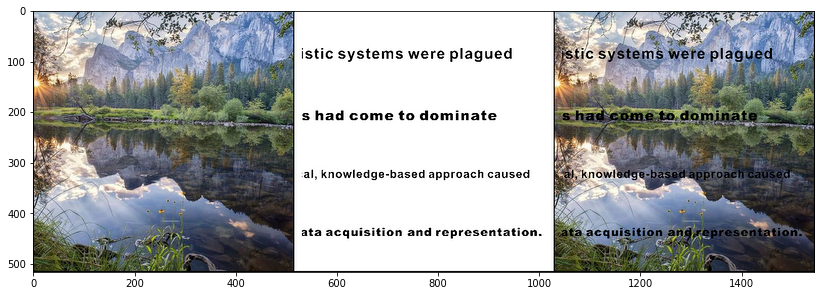

In [ ]:
img_mask_var = np_to_torch(img_mask_np).type(dtype)                    # Приводим изображения к нужному типу
plot_image_grid([img_np, img_mask_np, img_mask_np*img_np], 3,11);      # И отрисовываем 3 картинки в сетке

## Нейронная сеть

In [ ]:
pad = 'reflection' # 'zero'
OPT_OVER = 'net'
OPTIMIZER = 'adam'    # Оптимизотор

In [ ]:
# Собираем Энкодер и Декодер с пропускными соединениями
# Аргументы:
#    act_fun: Либо сторока 'LeakyReLU|Swish|ELU|none' либо модуль (например nn.ReLU)
#    pad (string): zero|reflection (default: 'zero')  наличие отражения
#    upsample_mode (string): 'nearest|bilinear' (default: 'nearest')     Тип выборки вверх (ближайший|билинейный)
#    downsample_mode (string): 'stride|avg|max|lanczos2' (default: 'stride')    Тип выборки вниз (шаг, среднее, максимальное, интерполяция lanczos2)

def skip(
        num_input_channels=2, num_output_channels=3, 
        num_channels_down=[16, 32, 64, 128, 128], num_channels_up=[16, 32, 64, 128, 128], num_channels_skip=[4, 4, 4, 4, 4], 
        filter_size_down=3, filter_size_up=3, filter_skip_size=1,
        need_sigmoid=True, need_bias=True, 
        pad='zero', upsample_mode='nearest', downsample_mode='stride', act_fun='LeakyReLU', 
        need1x1_up=True):

    assert len(num_channels_down) == len(num_channels_up) == len(num_channels_skip)  # Сравниваем количество элементов в списках 

    n_scales = len(num_channels_down) 
    # В зависимости от параметров Список или кортеж
    if not (isinstance(upsample_mode, list) or isinstance(upsample_mode, tuple)) :
        upsample_mode   = [upsample_mode]*n_scales

    if not (isinstance(downsample_mode, list)or isinstance(downsample_mode, tuple)):
        downsample_mode   = [downsample_mode]*n_scales
    
    if not (isinstance(filter_size_down, list) or isinstance(filter_size_down, tuple)) :
        filter_size_down   = [filter_size_down]*n_scales

    if not (isinstance(filter_size_up, list) or isinstance(filter_size_up, tuple)) :
        filter_size_up   = [filter_size_up]*n_scales

    last_scale = n_scales - 1 

    cur_depth = None

    model = nn.Sequential()
    model_tmp = model

    input_depth = num_input_channels
    for i in range(len(num_channels_down)):

        deeper = nn.Sequential()
        skip = nn.Sequential()

        if num_channels_skip[i] != 0:
            model_tmp.add(Concat(1, skip, deeper))
        else:
            model_tmp.add(deeper)
        
        model_tmp.add(bn(num_channels_skip[i] + (num_channels_up[i + 1] if i < last_scale else num_channels_down[i])))

        if num_channels_skip[i] != 0:
            skip.add(conv(input_depth, num_channels_skip[i], filter_skip_size, bias=need_bias, pad=pad))
            skip.add(bn(num_channels_skip[i]))
            skip.add(act(act_fun))
            
        # skip.add(Concat(2, GenNoise(nums_noise[i]), skip_part))

        deeper.add(conv(input_depth, num_channels_down[i], filter_size_down[i], 2, bias=need_bias, pad=pad, downsample_mode=downsample_mode[i]))
        deeper.add(bn(num_channels_down[i]))
        deeper.add(act(act_fun))

        deeper.add(conv(num_channels_down[i], num_channels_down[i], filter_size_down[i], bias=need_bias, pad=pad))
        deeper.add(bn(num_channels_down[i]))
        deeper.add(act(act_fun))

        deeper_main = nn.Sequential()

        if i == len(num_channels_down) - 1:
            # The deepest
            k = num_channels_down[i]
        else:
            deeper.add(deeper_main)
            k = num_channels_up[i + 1]

        deeper.add(nn.Upsample(scale_factor=2, mode=upsample_mode[i]))

        model_tmp.add(conv(num_channels_skip[i] + k, num_channels_up[i], filter_size_up[i], 1, bias=need_bias, pad=pad))
        model_tmp.add(bn(num_channels_up[i]))
        model_tmp.add(act(act_fun))


        if need1x1_up:
            model_tmp.add(conv(num_channels_up[i], num_channels_up[i], 1, bias=need_bias, pad=pad))
            model_tmp.add(bn(num_channels_up[i]))
            model_tmp.add(act(act_fun))

        input_depth = num_channels_down[i]
        model_tmp = deeper_main

    model.add(conv(num_channels_up[0], num_output_channels, 1, bias=need_bias, pad=pad))
    if need_sigmoid:
        model.add(nn.Sigmoid())

    return model


In [ ]:
def add_module(self, module):
    self.add_module(str(len(self) + 1), module)

torch.nn.Module.add = add_module


In [ ]:
class Concat(nn.Module):
    def __init__(self, dim, *args):
        super(Concat, self).__init__()
        self.dim = dim

        for idx, module in enumerate(args):
            self.add_module(str(idx), module)

    def forward(self, input):
        inputs = []
        for module in self._modules.values():
            inputs.append(module(input))

        inputs_shapes2 = [x.shape[2] for x in inputs]
        inputs_shapes3 = [x.shape[3] for x in inputs]        

        if np.all(np.array(inputs_shapes2) == min(inputs_shapes2)) and np.all(np.array(inputs_shapes3) == min(inputs_shapes3)):
            inputs_ = inputs
        else:
            target_shape2 = min(inputs_shapes2)
            target_shape3 = min(inputs_shapes3)

            inputs_ = []
            for inp in inputs: 
                diff2 = (inp.size(2) - target_shape2) // 2 
                diff3 = (inp.size(3) - target_shape3) // 2 
                inputs_.append(inp[:, :, diff2: diff2 + target_shape2, diff3:diff3 + target_shape3])

        return torch.cat(inputs_, dim=self.dim)

    def __len__(self):
        return len(self._modules)


class GenNoise(nn.Module):
    def __init__(self, dim2):
        super(GenNoise, self).__init__()
        self.dim2 = dim2

    def forward(self, input):
        a = list(input.size())
        a[1] = self.dim2
        # print (input.data.type())

        b = torch.zeros(a).type_as(input.data)
        b.normal_()

        x = torch.autograd.Variable(b)

        return x



In [ ]:
def bn(num_features):
    return nn.BatchNorm2d(num_features)


In [ ]:
def conv(in_f, out_f, kernel_size, stride=1, bias=True, pad='zero', downsample_mode='stride'):
    downsampler = None
    if stride != 1 and downsample_mode != 'stride':

        if downsample_mode == 'avg':
            downsampler = nn.AvgPool2d(stride, stride)
        elif downsample_mode == 'max':
            downsampler = nn.MaxPool2d(stride, stride)
        elif downsample_mode  in ['lanczos2', 'lanczos3']:
            downsampler = Downsampler(n_planes=out_f, factor=stride, kernel_type=downsample_mode, phase=0.5, preserve_size=True)
        else:
            assert False

        stride = 1

    padder = None
    to_pad = int((kernel_size - 1) / 2)
    if pad == 'reflection':
        padder = nn.ReflectionPad2d(to_pad)
        to_pad = 0
  
    convolver = nn.Conv2d(in_f, out_f, kernel_size, stride, padding=to_pad, bias=bias)


    layers = filter(lambda x: x is not None, [padder, convolver, downsampler])
    return nn.Sequential(*layers)

In [ ]:
# Функция активации - Либо строка, определяющая функцию активации, либо модуль (например, nn.ReLU)
def act(act_fun = 'LeakyReLU'):
    if isinstance(act_fun, str):
        if act_fun == 'LeakyReLU':
            return nn.LeakyReLU(0.2, inplace=True)
        elif act_fun == 'Swish':
            return Swish()
        elif act_fun == 'ELU':
            return nn.ELU()
        elif act_fun == 'none':
            return nn.Sequential()
        else:
            assert False
    else:
        return act_fun()

In [ ]:
class GenNoise(nn.Module):
    def __init__(self, dim2):
        super(GenNoise, self).__init__()
        self.dim2 = dim2

    def forward(self, input):
        a = list(input.size())
        a[1] = self.dim2
        # print (input.data.type())

        b = torch.zeros(a).type_as(input.data)
        b.normal_()

        x = torch.autograd.Variable(b)

        return x

In [ ]:
# Фукнция возвращает pytorch.Тензор размера (1 x `input_depth` x `spatial_size[0]` x `spatial_size[1]`)
# Аргументы:
# input_depth: количество каналов в тензоре
# method: `noise` для заполнения тензора шумом; `meshgrid` для np.meshgrid
# spatial_size: пространственный размер тензора для инициализации
# noise_type: 'u' для равномерного; 'n' для нормального
# var: коэффициент, на который будет умножен шум или шкала стандартного отклонения.

def get_noise(input_depth, method, spatial_size, noise_type='u', var=1./10):

    if isinstance(spatial_size, int):
        spatial_size = (spatial_size, spatial_size)
    if method == 'noise':
        shape = [1, input_depth, spatial_size[0], spatial_size[1]]
        net_input = torch.zeros(shape)
        
        fill_noise(net_input, noise_type)
        net_input *= var            
    elif method == 'meshgrid': 
        assert input_depth == 2
        X, Y = np.meshgrid(np.arange(0, spatial_size[1])/float(spatial_size[1]-1), np.arange(0, spatial_size[0])/float(spatial_size[0]-1))
        meshgrid = np.concatenate([X[None,:], Y[None,:]])
        net_input=  np_to_torch(meshgrid)
    else:
        assert False
        
    return net_input

In [ ]:
# Заполняет тензор `x` шумом noise_type
def fill_noise(x, noise_type):
    if noise_type == 'u':
        x.uniform_()
    elif noise_type == 'n':
        x.normal_() 
    else:
        assert False

In [ ]:
print(img_np.shape)

(3, 512, 512)


In [ ]:
# Параметры сети
INPUT = 'noise'
input_depth = 32
LR = 0.01 
num_iter = 6001
param_noise = False
show_every = 50
figsize = 5
reg_noise_std = 0.03
    
net = skip(input_depth, img_np.shape[0], 
           num_channels_down = [128] * 5,
           num_channels_up =   [128] * 5,
           num_channels_skip =    [128] * 5,  
           filter_size_up = 3, filter_size_down = 3, 
           upsample_mode='nearest', filter_skip_size=1,
           need_sigmoid=True, need_bias=True, pad=pad, act_fun='LeakyReLU').type(dtype)

net = net.type(dtype)
net_input = get_noise(input_depth, INPUT, img_np.shape[1:]).type(dtype)

In [ ]:
# summary модели
summary(net, (32, 224, 224))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
   ReflectionPad2d-1         [-1, 32, 224, 224]               0
            Conv2d-2        [-1, 128, 224, 224]           4,224
       BatchNorm2d-3        [-1, 128, 224, 224]             256
         LeakyReLU-4        [-1, 128, 224, 224]               0
   ReflectionPad2d-5         [-1, 32, 226, 226]               0
            Conv2d-6        [-1, 128, 112, 112]          36,992
       BatchNorm2d-7        [-1, 128, 112, 112]             256
         LeakyReLU-8        [-1, 128, 112, 112]               0
   ReflectionPad2d-9        [-1, 128, 114, 114]               0
           Conv2d-10        [-1, 128, 112, 112]         147,584
      BatchNorm2d-11        [-1, 128, 112, 112]             256
        LeakyReLU-12        [-1, 128, 112, 112]               0
  ReflectionPad2d-13        [-1, 128, 112, 112]               0
           Conv2d-14        [-1, 128, 1

In [ ]:
# Расчет количества параметров
s  = sum(np.prod(list(p.size())) for p in net.parameters())
print ('Количество параметров: %d' % s)

# Функция ошибки
mse = torch.nn.MSELoss().type(dtype)

img_var = np_to_torch(img_np).type(dtype)          # Преобразуем картинку
mask_var = np_to_torch(img_mask_np).type(dtype)    # Преобразуем маску

Количество параметров: 3002627


## Основной цикл

In [ ]:
# Возвращает параметры, которые мы хотим оптимизировать.
# Аргументы:
# opt_over: список, разделенный запятыми, например 'net,input' или 'net'
# net: нейронная сеть
# net_input: torch.Tensor, который хранит входные данные `z`


def get_params(opt_over, net, net_input, downsampler=None):

    opt_over_list = opt_over.split(',')
    params = []
    
    for opt in opt_over_list:
    
        if opt == 'net':
            params += [x for x in net.parameters() ]
        elif  opt=='down':
            assert downsampler is not None
            params = [x for x in downsampler.parameters()]
        elif opt == 'input':
            net_input.requires_grad = True
            params += [net_input]
        else:
            assert False, 'what is it?'
            
    return params

In [ ]:
# Функция запуска цикла оптимизации
# Аргументы:
# optimizer_type: Тип оптимизатора 'LBFGS' или 'adam'
# parameters: список оптимизируемых тензоров
# closure: функция, возвращает переменную ошибки
# LR: коэффициент скорости обучения
# num_iter: количество проходов

def optimize(optimizer_type, parameters, closure, LR, num_iter):

    if optimizer_type == 'LBFGS':
        # Do several steps with adam first
        optimizer = torch.optim.Adam(parameters, lr=0.001)
        for j in range(100):
            optimizer.zero_grad()
            closure()
            optimizer.step()

        print('Запуск c оптимизацией LBFGS')        
        def closure2():
            optimizer.zero_grad()
            return closure()
        optimizer = torch.optim.LBFGS(parameters, max_iter=num_iter, lr=LR, tolerance_grad=-1, tolerance_change=-1)
        optimizer.step(closure2)

    elif optimizer_type == 'adam':
        print('Запуск c оптимизацией ADAM')
        optimizer = torch.optim.Adam(parameters, lr=LR)
        
        for j in range(num_iter):
            optimizer.zero_grad()
            closure()
            optimizer.step()
    else:
        assert False

In [ ]:
# Преобразуем изображение из torch.Tensor в np.array (из 1xCxWxH[0..1] в CxWxH[0..1])
def torch_to_np(img_var):
    return img_var.detach().cpu().numpy()[0]


Запуск c оптимизацией ADAM
Проход 00000    Ошибка 0.064191


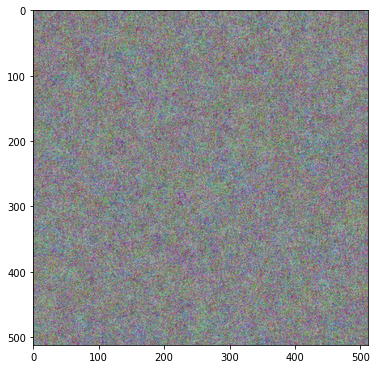

Проход 00001    Ошибка 0.060804
Проход 00002    Ошибка 0.132511
Проход 00003    Ошибка 0.064885
Проход 00004    Ошибка 0.095679
Проход 00005    Ошибка 0.056363
Проход 00006    Ошибка 0.056571
Проход 00007    Ошибка 0.050943
Проход 00008    Ошибка 0.044156
Проход 00009    Ошибка 0.039813
Проход 00010    Ошибка 0.039650
Проход 00011    Ошибка 0.035184
Проход 00012    Ошибка 0.031635
Проход 00013    Ошибка 0.028439
Проход 00014    Ошибка 0.028613
Проход 00015    Ошибка 0.026728
Проход 00016    Ошибка 0.023922
Проход 00017    Ошибка 0.022386
Проход 00018    Ошибка 0.022446
Проход 00019    Ошибка 0.022042
Проход 00020    Ошибка 0.021414
Проход 00021    Ошибка 0.020562
Проход 00022    Ошибка 0.020847
Проход 00023    Ошибка 0.020342
Проход 00024    Ошибка 0.020264
Проход 00025    Ошибка 0.019842
Проход 00026    Ошибка 0.019628
Проход 00027    Ошибка 0.019674
Проход 00028    Ошибка 0.019371
Проход 00029    Ошибка 0.018867
Проход 00030    Ошибка 0.018582
Проход 00031    Ошибка 0.018157
Проход 0

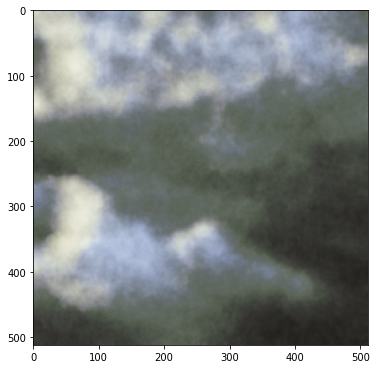

Проход 00051    Ошибка 0.016102
Проход 00052    Ошибка 0.016162
Проход 00053    Ошибка 0.015848
Проход 00054    Ошибка 0.015770
Проход 00055    Ошибка 0.015576
Проход 00056    Ошибка 0.016024
Проход 00057    Ошибка 0.015591
Проход 00058    Ошибка 0.015532
Проход 00059    Ошибка 0.015444
Проход 00060    Ошибка 0.015175
Проход 00061    Ошибка 0.015081
Проход 00062    Ошибка 0.015252
Проход 00063    Ошибка 0.015090
Проход 00064    Ошибка 0.014881
Проход 00065    Ошибка 0.014943
Проход 00066    Ошибка 0.014841
Проход 00067    Ошибка 0.014816
Проход 00068    Ошибка 0.014705
Проход 00069    Ошибка 0.014839
Проход 00070    Ошибка 0.014711
Проход 00071    Ошибка 0.015175
Проход 00072    Ошибка 0.014575
Проход 00073    Ошибка 0.014300
Проход 00074    Ошибка 0.014406
Проход 00075    Ошибка 0.014101
Проход 00076    Ошибка 0.014160
Проход 00077    Ошибка 0.014198
Проход 00078    Ошибка 0.014039
Проход 00079    Ошибка 0.014123
Проход 00080    Ошибка 0.013620
Проход 00081    Ошибка 0.013763
Проход 0

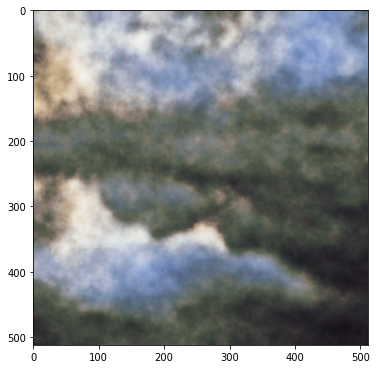

Проход 00101    Ошибка 0.012580
Проход 00102    Ошибка 0.012981
Проход 00103    Ошибка 0.012636
Проход 00104    Ошибка 0.012951
Проход 00105    Ошибка 0.012517
Проход 00106    Ошибка 0.012358
Проход 00107    Ошибка 0.012479
Проход 00108    Ошибка 0.012427
Проход 00109    Ошибка 0.012505
Проход 00110    Ошибка 0.012096
Проход 00111    Ошибка 0.012377
Проход 00112    Ошибка 0.012271
Проход 00113    Ошибка 0.012446
Проход 00114    Ошибка 0.012348
Проход 00115    Ошибка 0.012073
Проход 00116    Ошибка 0.012066
Проход 00117    Ошибка 0.011935
Проход 00118    Ошибка 0.011865
Проход 00119    Ошибка 0.012125
Проход 00120    Ошибка 0.011987
Проход 00121    Ошибка 0.011840
Проход 00122    Ошибка 0.011879
Проход 00123    Ошибка 0.011910
Проход 00124    Ошибка 0.011882
Проход 00125    Ошибка 0.011776
Проход 00126    Ошибка 0.011763
Проход 00127    Ошибка 0.011429
Проход 00128    Ошибка 0.011582
Проход 00129    Ошибка 0.011665
Проход 00130    Ошибка 0.011516
Проход 00131    Ошибка 0.011515
Проход 0

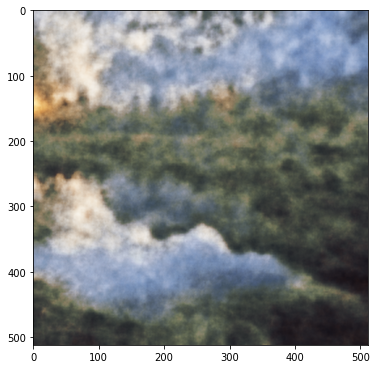

Проход 00151    Ошибка 0.010855
Проход 00152    Ошибка 0.010808
Проход 00153    Ошибка 0.010702
Проход 00154    Ошибка 0.010703
Проход 00155    Ошибка 0.010782
Проход 00156    Ошибка 0.010626
Проход 00157    Ошибка 0.010609
Проход 00158    Ошибка 0.010562
Проход 00159    Ошибка 0.010542
Проход 00160    Ошибка 0.010454
Проход 00161    Ошибка 0.010448
Проход 00162    Ошибка 0.010352
Проход 00163    Ошибка 0.010473
Проход 00164    Ошибка 0.010380
Проход 00165    Ошибка 0.010366
Проход 00166    Ошибка 0.010436
Проход 00167    Ошибка 0.010237
Проход 00168    Ошибка 0.010334
Проход 00169    Ошибка 0.010171
Проход 00170    Ошибка 0.010220
Проход 00171    Ошибка 0.010241
Проход 00172    Ошибка 0.010196
Проход 00173    Ошибка 0.010117
Проход 00174    Ошибка 0.010280
Проход 00175    Ошибка 0.010139
Проход 00176    Ошибка 0.010082
Проход 00177    Ошибка 0.010012
Проход 00178    Ошибка 0.010104
Проход 00179    Ошибка 0.010085
Проход 00180    Ошибка 0.009990
Проход 00181    Ошибка 0.010002
Проход 0

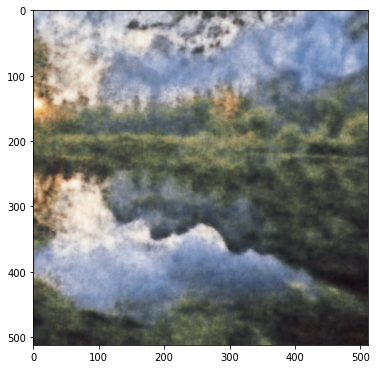

Проход 00201    Ошибка 0.009607
Проход 00202    Ошибка 0.009711
Проход 00203    Ошибка 0.009511
Проход 00204    Ошибка 0.009732
Проход 00205    Ошибка 0.009498
Проход 00206    Ошибка 0.009576
Проход 00207    Ошибка 0.009575
Проход 00208    Ошибка 0.009535
Проход 00209    Ошибка 0.009442
Проход 00210    Ошибка 0.009708
Проход 00211    Ошибка 0.009283
Проход 00212    Ошибка 0.009264
Проход 00213    Ошибка 0.009496
Проход 00214    Ошибка 0.009431
Проход 00215    Ошибка 0.009446
Проход 00216    Ошибка 0.009345
Проход 00217    Ошибка 0.009416
Проход 00218    Ошибка 0.009366
Проход 00219    Ошибка 0.009190
Проход 00220    Ошибка 0.009506
Проход 00221    Ошибка 0.009277
Проход 00222    Ошибка 0.009315
Проход 00223    Ошибка 0.009421
Проход 00224    Ошибка 0.009141
Проход 00225    Ошибка 0.009347
Проход 00226    Ошибка 0.009148
Проход 00227    Ошибка 0.008988
Проход 00228    Ошибка 0.009614
Проход 00229    Ошибка 0.009028
Проход 00230    Ошибка 0.009183
Проход 00231    Ошибка 0.009081
Проход 0

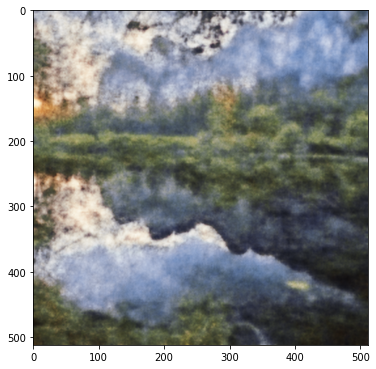

Проход 00251    Ошибка 0.008668
Проход 00252    Ошибка 0.008676
Проход 00253    Ошибка 0.008693
Проход 00254    Ошибка 0.008697
Проход 00255    Ошибка 0.008665
Проход 00256    Ошибка 0.008510
Проход 00257    Ошибка 0.008562
Проход 00258    Ошибка 0.008545
Проход 00259    Ошибка 0.008561
Проход 00260    Ошибка 0.008600
Проход 00261    Ошибка 0.008438
Проход 00262    Ошибка 0.008488
Проход 00263    Ошибка 0.008505
Проход 00264    Ошибка 0.008402
Проход 00265    Ошибка 0.008493
Проход 00266    Ошибка 0.008380
Проход 00267    Ошибка 0.008350
Проход 00268    Ошибка 0.008387
Проход 00269    Ошибка 0.008388
Проход 00270    Ошибка 0.008370
Проход 00271    Ошибка 0.008654
Проход 00272    Ошибка 0.008356
Проход 00273    Ошибка 0.008327
Проход 00274    Ошибка 0.008432
Проход 00275    Ошибка 0.008223
Проход 00276    Ошибка 0.008260
Проход 00277    Ошибка 0.008238
Проход 00278    Ошибка 0.008207
Проход 00279    Ошибка 0.008175
Проход 00280    Ошибка 0.008148
Проход 00281    Ошибка 0.008169
Проход 0

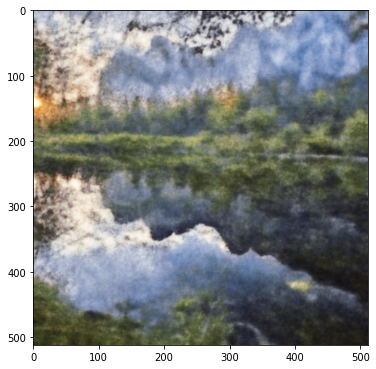

Проход 00301    Ошибка 0.007926
Проход 00302    Ошибка 0.007802
Проход 00303    Ошибка 0.007885
Проход 00304    Ошибка 0.007979
Проход 00305    Ошибка 0.007895
Проход 00306    Ошибка 0.007902
Проход 00307    Ошибка 0.007840
Проход 00308    Ошибка 0.007859
Проход 00309    Ошибка 0.007855
Проход 00310    Ошибка 0.007876
Проход 00311    Ошибка 0.007800
Проход 00312    Ошибка 0.007743
Проход 00313    Ошибка 0.007829
Проход 00314    Ошибка 0.007769
Проход 00315    Ошибка 0.007885
Проход 00316    Ошибка 0.007763
Проход 00317    Ошибка 0.007678
Проход 00318    Ошибка 0.007804
Проход 00319    Ошибка 0.007726
Проход 00320    Ошибка 0.007743
Проход 00321    Ошибка 0.007771
Проход 00322    Ошибка 0.007691
Проход 00323    Ошибка 0.007697
Проход 00324    Ошибка 0.007656
Проход 00325    Ошибка 0.007637
Проход 00326    Ошибка 0.007730
Проход 00327    Ошибка 0.007562
Проход 00328    Ошибка 0.007613
Проход 00329    Ошибка 0.007618
Проход 00330    Ошибка 0.007501
Проход 00331    Ошибка 0.007602
Проход 0

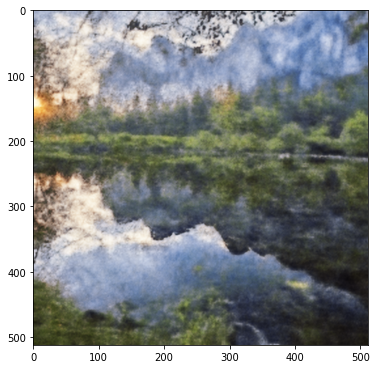

Проход 00351    Ошибка 0.007357
Проход 00352    Ошибка 0.007431
Проход 00353    Ошибка 0.007359
Проход 00354    Ошибка 0.007396
Проход 00355    Ошибка 0.007400
Проход 00356    Ошибка 0.007436
Проход 00357    Ошибка 0.007392
Проход 00358    Ошибка 0.007397
Проход 00359    Ошибка 0.007307
Проход 00360    Ошибка 0.007423
Проход 00361    Ошибка 0.007180
Проход 00362    Ошибка 0.007320
Проход 00363    Ошибка 0.007308
Проход 00364    Ошибка 0.007226
Проход 00365    Ошибка 0.007329
Проход 00366    Ошибка 0.007161
Проход 00367    Ошибка 0.007459
Проход 00368    Ошибка 0.007238
Проход 00369    Ошибка 0.007255
Проход 00370    Ошибка 0.007171
Проход 00371    Ошибка 0.007255
Проход 00372    Ошибка 0.007170
Проход 00373    Ошибка 0.007247
Проход 00374    Ошибка 0.007087
Проход 00375    Ошибка 0.007205
Проход 00376    Ошибка 0.007256
Проход 00377    Ошибка 0.007167
Проход 00378    Ошибка 0.007180
Проход 00379    Ошибка 0.007092
Проход 00380    Ошибка 0.007187
Проход 00381    Ошибка 0.007043
Проход 0

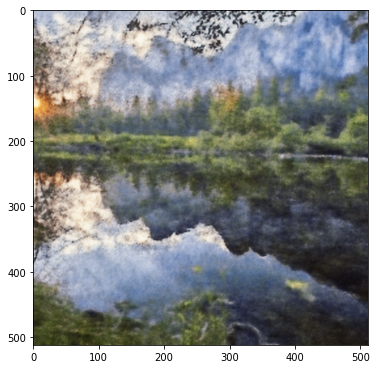

Проход 00401    Ошибка 0.006831
Проход 00402    Ошибка 0.006948
Проход 00403    Ошибка 0.006847
Проход 00404    Ошибка 0.006874
Проход 00405    Ошибка 0.006767
Проход 00406    Ошибка 0.006874
Проход 00407    Ошибка 0.006838
Проход 00408    Ошибка 0.006844
Проход 00409    Ошибка 0.006820
Проход 00410    Ошибка 0.006852
Проход 00411    Ошибка 0.006864
Проход 00412    Ошибка 0.006870
Проход 00413    Ошибка 0.006786
Проход 00414    Ошибка 0.006775
Проход 00415    Ошибка 0.006687
Проход 00416    Ошибка 0.006866
Проход 00417    Ошибка 0.006750
Проход 00418    Ошибка 0.006803
Проход 00419    Ошибка 0.006686
Проход 00420    Ошибка 0.006797
Проход 00421    Ошибка 0.006637
Проход 00422    Ошибка 0.006792
Проход 00423    Ошибка 0.006683
Проход 00424    Ошибка 0.006761
Проход 00425    Ошибка 0.006732
Проход 00426    Ошибка 0.006814
Проход 00427    Ошибка 0.006831
Проход 00428    Ошибка 0.006750
Проход 00429    Ошибка 0.006762
Проход 00430    Ошибка 0.006745
Проход 00431    Ошибка 0.006860
Проход 0

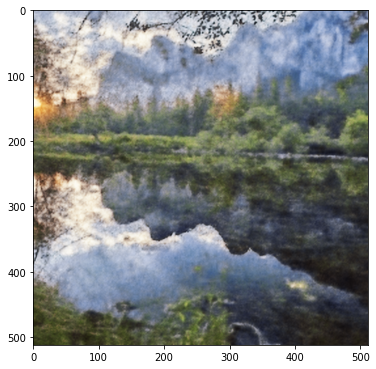

Проход 00451    Ошибка 0.006595
Проход 00452    Ошибка 0.006534
Проход 00453    Ошибка 0.006637
Проход 00454    Ошибка 0.006571
Проход 00455    Ошибка 0.006578
Проход 00456    Ошибка 0.006540
Проход 00457    Ошибка 0.006506
Проход 00458    Ошибка 0.006584
Проход 00459    Ошибка 0.006446
Проход 00460    Ошибка 0.006453
Проход 00461    Ошибка 0.006524
Проход 00462    Ошибка 0.006446
Проход 00463    Ошибка 0.006514
Проход 00464    Ошибка 0.006492
Проход 00465    Ошибка 0.006433
Проход 00466    Ошибка 0.006470
Проход 00467    Ошибка 0.006432
Проход 00468    Ошибка 0.006385
Проход 00469    Ошибка 0.006434
Проход 00470    Ошибка 0.006319
Проход 00471    Ошибка 0.006360
Проход 00472    Ошибка 0.006368
Проход 00473    Ошибка 0.006454
Проход 00474    Ошибка 0.006391
Проход 00475    Ошибка 0.006346
Проход 00476    Ошибка 0.006413
Проход 00477    Ошибка 0.006294
Проход 00478    Ошибка 0.006328
Проход 00479    Ошибка 0.006281
Проход 00480    Ошибка 0.006322
Проход 00481    Ошибка 0.006286
Проход 0

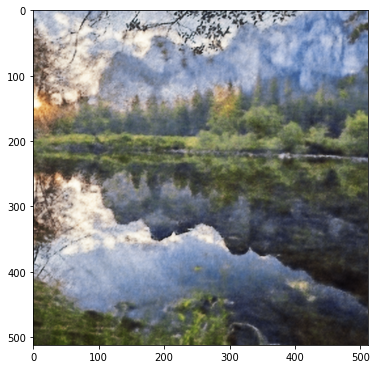

Проход 00501    Ошибка 0.006199
Проход 00502    Ошибка 0.006132
Проход 00503    Ошибка 0.006086
Проход 00504    Ошибка 0.006247
Проход 00505    Ошибка 0.006154
Проход 00506    Ошибка 0.006176
Проход 00507    Ошибка 0.006146
Проход 00508    Ошибка 0.006134
Проход 00509    Ошибка 0.006091
Проход 00510    Ошибка 0.006150
Проход 00511    Ошибка 0.006094
Проход 00512    Ошибка 0.006108
Проход 00513    Ошибка 0.006197
Проход 00514    Ошибка 0.006077
Проход 00515    Ошибка 0.006123
Проход 00516    Ошибка 0.006060
Проход 00517    Ошибка 0.006149
Проход 00518    Ошибка 0.006022
Проход 00519    Ошибка 0.006135
Проход 00520    Ошибка 0.006033
Проход 00521    Ошибка 0.006111
Проход 00522    Ошибка 0.006089
Проход 00523    Ошибка 0.006122
Проход 00524    Ошибка 0.006031
Проход 00525    Ошибка 0.006054
Проход 00526    Ошибка 0.006051
Проход 00527    Ошибка 0.005996
Проход 00528    Ошибка 0.006015
Проход 00529    Ошибка 0.005991
Проход 00530    Ошибка 0.006015
Проход 00531    Ошибка 0.005938
Проход 0

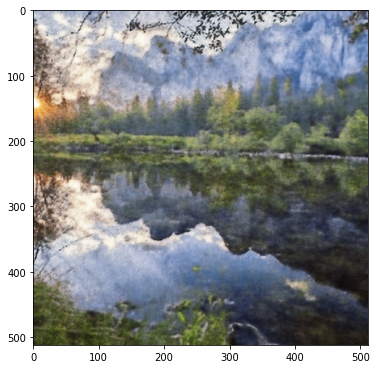

Проход 00551    Ошибка 0.005910
Проход 00552    Ошибка 0.005839
Проход 00553    Ошибка 0.005933
Проход 00554    Ошибка 0.005998
Проход 00555    Ошибка 0.005879
Проход 00556    Ошибка 0.005882
Проход 00557    Ошибка 0.005887
Проход 00558    Ошибка 0.005907
Проход 00559    Ошибка 0.005930
Проход 00560    Ошибка 0.005935
Проход 00561    Ошибка 0.005978
Проход 00562    Ошибка 0.005960
Проход 00563    Ошибка 0.005816
Проход 00564    Ошибка 0.005989
Проход 00565    Ошибка 0.005821
Проход 00566    Ошибка 0.005844
Проход 00567    Ошибка 0.005836
Проход 00568    Ошибка 0.005808
Проход 00569    Ошибка 0.005788
Проход 00570    Ошибка 0.005814
Проход 00571    Ошибка 0.005795
Проход 00572    Ошибка 0.005791
Проход 00573    Ошибка 0.005793
Проход 00574    Ошибка 0.005793
Проход 00575    Ошибка 0.005911
Проход 00576    Ошибка 0.005841
Проход 00577    Ошибка 0.005765
Проход 00578    Ошибка 0.005848
Проход 00579    Ошибка 0.005764
Проход 00580    Ошибка 0.005760
Проход 00581    Ошибка 0.005752
Проход 0

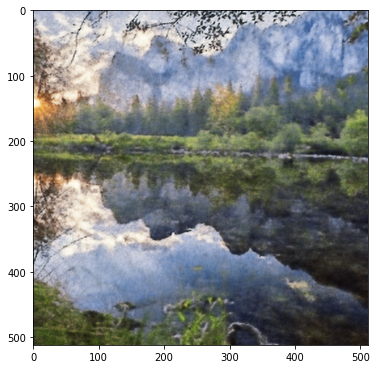

Проход 00601    Ошибка 0.005611
Проход 00602    Ошибка 0.005592
Проход 00603    Ошибка 0.005586
Проход 00604    Ошибка 0.005589
Проход 00605    Ошибка 0.005638
Проход 00606    Ошибка 0.005525
Проход 00607    Ошибка 0.005565
Проход 00608    Ошибка 0.005616
Проход 00609    Ошибка 0.005510
Проход 00610    Ошибка 0.005600
Проход 00611    Ошибка 0.005617
Проход 00612    Ошибка 0.005559
Проход 00613    Ошибка 0.005543
Проход 00614    Ошибка 0.005521
Проход 00615    Ошибка 0.005434
Проход 00616    Ошибка 0.005531
Проход 00617    Ошибка 0.005500
Проход 00618    Ошибка 0.005533
Проход 00619    Ошибка 0.005483
Проход 00620    Ошибка 0.005509
Проход 00621    Ошибка 0.005452
Проход 00622    Ошибка 0.005488
Проход 00623    Ошибка 0.005543
Проход 00624    Ошибка 0.005503
Проход 00625    Ошибка 0.005514
Проход 00626    Ошибка 0.005640
Проход 00627    Ошибка 0.005696
Проход 00628    Ошибка 0.005540
Проход 00629    Ошибка 0.005544
Проход 00630    Ошибка 0.005548
Проход 00631    Ошибка 0.005612
Проход 0

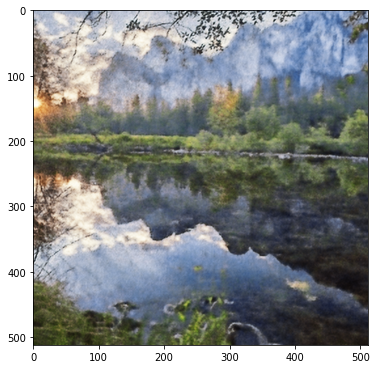

Проход 00651    Ошибка 0.005313
Проход 00652    Ошибка 0.005334
Проход 00653    Ошибка 0.005334
Проход 00654    Ошибка 0.005337
Проход 00655    Ошибка 0.005338
Проход 00656    Ошибка 0.005295
Проход 00657    Ошибка 0.005331
Проход 00658    Ошибка 0.005434
Проход 00659    Ошибка 0.005398
Проход 00660    Ошибка 0.005363
Проход 00661    Ошибка 0.005341
Проход 00662    Ошибка 0.005304
Проход 00663    Ошибка 0.005326
Проход 00664    Ошибка 0.005374
Проход 00665    Ошибка 0.005329
Проход 00666    Ошибка 0.005276
Проход 00667    Ошибка 0.005306
Проход 00668    Ошибка 0.005337
Проход 00669    Ошибка 0.005279
Проход 00670    Ошибка 0.005250
Проход 00671    Ошибка 0.005449
Проход 00672    Ошибка 0.005384
Проход 00673    Ошибка 0.005283
Проход 00674    Ошибка 0.005550
Проход 00675    Ошибка 0.005370
Проход 00676    Ошибка 0.005270
Проход 00677    Ошибка 0.005344
Проход 00678    Ошибка 0.005216
Проход 00679    Ошибка 0.005388
Проход 00680    Ошибка 0.005491
Проход 00681    Ошибка 0.005275
Проход 0

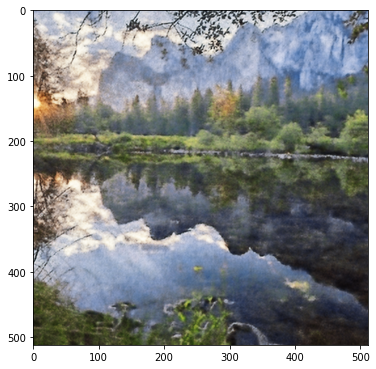

Проход 00701    Ошибка 0.005122
Проход 00702    Ошибка 0.005117
Проход 00703    Ошибка 0.005109
Проход 00704    Ошибка 0.005134
Проход 00705    Ошибка 0.005100
Проход 00706    Ошибка 0.005077
Проход 00707    Ошибка 0.005067
Проход 00708    Ошибка 0.005063
Проход 00709    Ошибка 0.005045
Проход 00710    Ошибка 0.005101
Проход 00711    Ошибка 0.005079
Проход 00712    Ошибка 0.005075
Проход 00713    Ошибка 0.005055
Проход 00714    Ошибка 0.005059
Проход 00715    Ошибка 0.004999
Проход 00716    Ошибка 0.005015
Проход 00717    Ошибка 0.005071
Проход 00718    Ошибка 0.005127
Проход 00719    Ошибка 0.005055
Проход 00720    Ошибка 0.005045
Проход 00721    Ошибка 0.005065
Проход 00722    Ошибка 0.005144
Проход 00723    Ошибка 0.005095
Проход 00724    Ошибка 0.004976
Проход 00725    Ошибка 0.005163
Проход 00726    Ошибка 0.005091
Проход 00727    Ошибка 0.005002
Проход 00728    Ошибка 0.005120
Проход 00729    Ошибка 0.005024
Проход 00730    Ошибка 0.005058
Проход 00731    Ошибка 0.005069
Проход 0

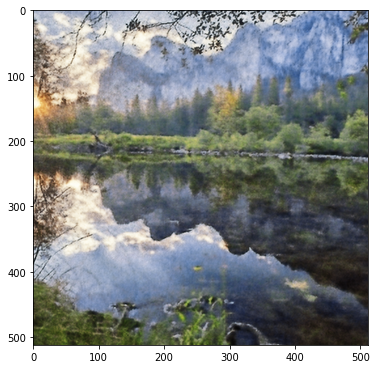

Проход 00751    Ошибка 0.005017
Проход 00752    Ошибка 0.004948
Проход 00753    Ошибка 0.004905
Проход 00754    Ошибка 0.004966
Проход 00755    Ошибка 0.005062
Проход 00756    Ошибка 0.004903
Проход 00757    Ошибка 0.004917
Проход 00758    Ошибка 0.005013
Проход 00759    Ошибка 0.004847
Проход 00760    Ошибка 0.004865
Проход 00761    Ошибка 0.005012
Проход 00762    Ошибка 0.004960
Проход 00763    Ошибка 0.004895
Проход 00764    Ошибка 0.005078
Проход 00765    Ошибка 0.005055
Проход 00766    Ошибка 0.004864
Проход 00767    Ошибка 0.004896
Проход 00768    Ошибка 0.004831
Проход 00769    Ошибка 0.004856
Проход 00770    Ошибка 0.004915
Проход 00771    Ошибка 0.004776
Проход 00772    Ошибка 0.004812
Проход 00773    Ошибка 0.004825
Проход 00774    Ошибка 0.004786
Проход 00775    Ошибка 0.004791
Проход 00776    Ошибка 0.004753
Проход 00777    Ошибка 0.004802
Проход 00778    Ошибка 0.004744
Проход 00779    Ошибка 0.004764
Проход 00780    Ошибка 0.004798
Проход 00781    Ошибка 0.004802
Проход 0

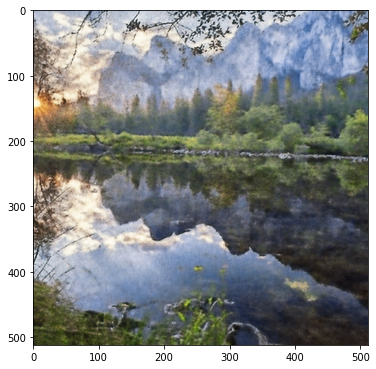

Проход 00801    Ошибка 0.004834
Проход 00802    Ошибка 0.004840
Проход 00803    Ошибка 0.004631
Проход 00804    Ошибка 0.004842
Проход 00805    Ошибка 0.004696
Проход 00806    Ошибка 0.004712
Проход 00807    Ошибка 0.004741
Проход 00808    Ошибка 0.004621
Проход 00809    Ошибка 0.004738
Проход 00810    Ошибка 0.004688
Проход 00811    Ошибка 0.004636
Проход 00812    Ошибка 0.004683
Проход 00813    Ошибка 0.004598
Проход 00814    Ошибка 0.004666
Проход 00815    Ошибка 0.004618
Проход 00816    Ошибка 0.004684
Проход 00817    Ошибка 0.004649
Проход 00818    Ошибка 0.004639
Проход 00819    Ошибка 0.004641
Проход 00820    Ошибка 0.004677
Проход 00821    Ошибка 0.004620
Проход 00822    Ошибка 0.004584
Проход 00823    Ошибка 0.004672
Проход 00824    Ошибка 0.004658
Проход 00825    Ошибка 0.004593
Проход 00826    Ошибка 0.004675
Проход 00827    Ошибка 0.004706
Проход 00828    Ошибка 0.004535
Проход 00829    Ошибка 0.004693
Проход 00830    Ошибка 0.004727
Проход 00831    Ошибка 0.004640
Проход 0

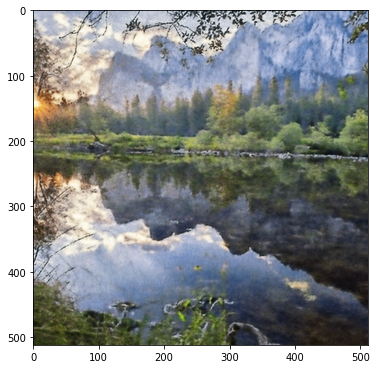

Проход 00851    Ошибка 0.004577
Проход 00852    Ошибка 0.004465
Проход 00853    Ошибка 0.004501
Проход 00854    Ошибка 0.004505
Проход 00855    Ошибка 0.004440
Проход 00856    Ошибка 0.004608
Проход 00857    Ошибка 0.004512
Проход 00858    Ошибка 0.004479
Проход 00859    Ошибка 0.004530
Проход 00860    Ошибка 0.004453
Проход 00861    Ошибка 0.004466
Проход 00862    Ошибка 0.004462
Проход 00863    Ошибка 0.004452
Проход 00864    Ошибка 0.004445
Проход 00865    Ошибка 0.004501
Проход 00866    Ошибка 0.004485
Проход 00867    Ошибка 0.004455
Проход 00868    Ошибка 0.004390
Проход 00869    Ошибка 0.004400
Проход 00870    Ошибка 0.004414
Проход 00871    Ошибка 0.004407
Проход 00872    Ошибка 0.004364
Проход 00873    Ошибка 0.004402
Проход 00874    Ошибка 0.004383
Проход 00875    Ошибка 0.004405
Проход 00876    Ошибка 0.004399
Проход 00877    Ошибка 0.004349
Проход 00878    Ошибка 0.004345
Проход 00879    Ошибка 0.004319
Проход 00880    Ошибка 0.004434
Проход 00881    Ошибка 0.004435
Проход 0

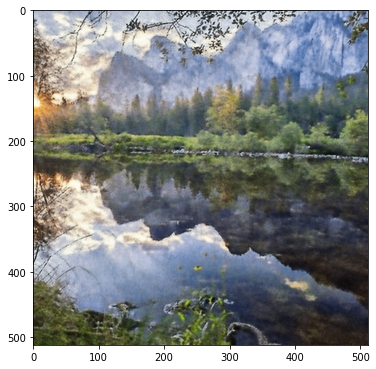

Проход 00901    Ошибка 0.004319
Проход 00902    Ошибка 0.004378
Проход 00903    Ошибка 0.004341
Проход 00904    Ошибка 0.004258
Проход 00905    Ошибка 0.004287
Проход 00906    Ошибка 0.004312
Проход 00907    Ошибка 0.004231
Проход 00908    Ошибка 0.004278
Проход 00909    Ошибка 0.004310
Проход 00910    Ошибка 0.004207
Проход 00911    Ошибка 0.004236
Проход 00912    Ошибка 0.004242
Проход 00913    Ошибка 0.004210
Проход 00914    Ошибка 0.004305
Проход 00915    Ошибка 0.004353
Проход 00916    Ошибка 0.004217
Проход 00917    Ошибка 0.004283
Проход 00918    Ошибка 0.004330
Проход 00919    Ошибка 0.004211
Проход 00920    Ошибка 0.004248
Проход 00921    Ошибка 0.004222
Проход 00922    Ошибка 0.004208
Проход 00923    Ошибка 0.004210
Проход 00924    Ошибка 0.004157
Проход 00925    Ошибка 0.004194
Проход 00926    Ошибка 0.004142
Проход 00927    Ошибка 0.004138
Проход 00928    Ошибка 0.004176
Проход 00929    Ошибка 0.004153
Проход 00930    Ошибка 0.004171
Проход 00931    Ошибка 0.004125
Проход 0

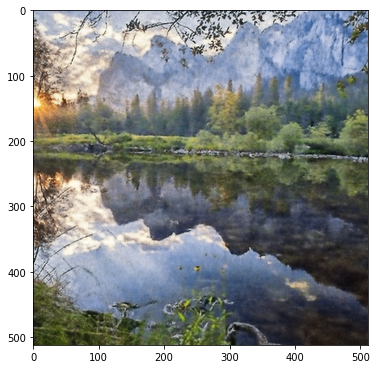

Проход 00951    Ошибка 0.004077
Проход 00952    Ошибка 0.004096
Проход 00953    Ошибка 0.004072
Проход 00954    Ошибка 0.004095
Проход 00955    Ошибка 0.004037
Проход 00956    Ошибка 0.004088
Проход 00957    Ошибка 0.004047
Проход 00958    Ошибка 0.004102
Проход 00959    Ошибка 0.004030
Проход 00960    Ошибка 0.004046
Проход 00961    Ошибка 0.004082
Проход 00962    Ошибка 0.004119
Проход 00963    Ошибка 0.004069
Проход 00964    Ошибка 0.004035
Проход 00965    Ошибка 0.004055
Проход 00966    Ошибка 0.004087
Проход 00967    Ошибка 0.004040
Проход 00968    Ошибка 0.004002
Проход 00969    Ошибка 0.003978
Проход 00970    Ошибка 0.004078
Проход 00971    Ошибка 0.004086
Проход 00972    Ошибка 0.003985
Проход 00973    Ошибка 0.004021
Проход 00974    Ошибка 0.004052
Проход 00975    Ошибка 0.003987
Проход 00976    Ошибка 0.003976
Проход 00977    Ошибка 0.004019
Проход 00978    Ошибка 0.004046
Проход 00979    Ошибка 0.003973
Проход 00980    Ошибка 0.003982
Проход 00981    Ошибка 0.003994
Проход 0

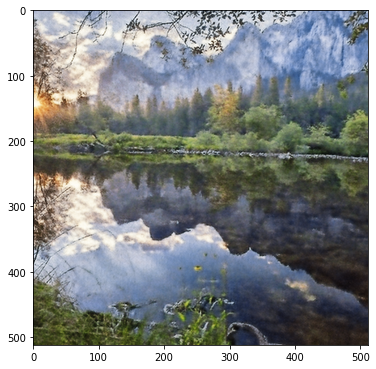

Проход 01001    Ошибка 0.004008
Проход 01002    Ошибка 0.003932
Проход 01003    Ошибка 0.003880
Проход 01004    Ошибка 0.003902
Проход 01005    Ошибка 0.003905
Проход 01006    Ошибка 0.003982
Проход 01007    Ошибка 0.004019
Проход 01008    Ошибка 0.003899
Проход 01009    Ошибка 0.003920
Проход 01010    Ошибка 0.004033
Проход 01011    Ошибка 0.003929
Проход 01012    Ошибка 0.003914
Проход 01013    Ошибка 0.004062
Проход 01014    Ошибка 0.003898
Проход 01015    Ошибка 0.003930
Проход 01016    Ошибка 0.003945
Проход 01017    Ошибка 0.003880
Проход 01018    Ошибка 0.003886
Проход 01019    Ошибка 0.003860
Проход 01020    Ошибка 0.003849
Проход 01021    Ошибка 0.003931
Проход 01022    Ошибка 0.003822
Проход 01023    Ошибка 0.003842
Проход 01024    Ошибка 0.003843
Проход 01025    Ошибка 0.003819
Проход 01026    Ошибка 0.003820
Проход 01027    Ошибка 0.003798
Проход 01028    Ошибка 0.003813
Проход 01029    Ошибка 0.003807
Проход 01030    Ошибка 0.003802
Проход 01031    Ошибка 0.003842
Проход 0

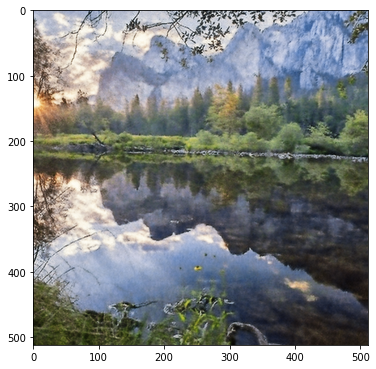

Проход 01051    Ошибка 0.003713
Проход 01052    Ошибка 0.003765
Проход 01053    Ошибка 0.003720
Проход 01054    Ошибка 0.003727
Проход 01055    Ошибка 0.003712
Проход 01056    Ошибка 0.003706
Проход 01057    Ошибка 0.003701
Проход 01058    Ошибка 0.003709
Проход 01059    Ошибка 0.003709
Проход 01060    Ошибка 0.003693
Проход 01061    Ошибка 0.003680
Проход 01062    Ошибка 0.003699
Проход 01063    Ошибка 0.003719
Проход 01064    Ошибка 0.003723
Проход 01065    Ошибка 0.003676
Проход 01066    Ошибка 0.003655
Проход 01067    Ошибка 0.003688
Проход 01068    Ошибка 0.003810
Проход 01069    Ошибка 0.003859
Проход 01070    Ошибка 0.003717
Проход 01071    Ошибка 0.003684
Проход 01072    Ошибка 0.003824
Проход 01073    Ошибка 0.003862
Проход 01074    Ошибка 0.003786
Проход 01075    Ошибка 0.003720
Проход 01076    Ошибка 0.003782
Проход 01077    Ошибка 0.003673
Проход 01078    Ошибка 0.003746
Проход 01079    Ошибка 0.003855
Проход 01080    Ошибка 0.003799
Проход 01081    Ошибка 0.003746
Проход 0

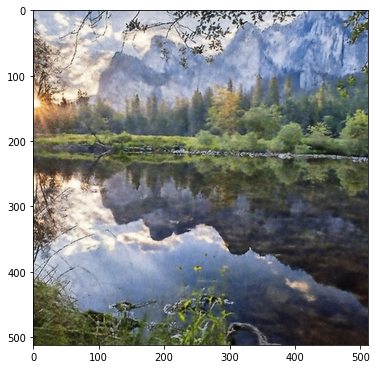

Проход 01101    Ошибка 0.003801
Проход 01102    Ошибка 0.003618
Проход 01103    Ошибка 0.003669
Проход 01104    Ошибка 0.003840
Проход 01105    Ошибка 0.003659
Проход 01106    Ошибка 0.003661
Проход 01107    Ошибка 0.003686
Проход 01108    Ошибка 0.003599
Проход 01109    Ошибка 0.003704
Проход 01110    Ошибка 0.003573
Проход 01111    Ошибка 0.003612
Проход 01112    Ошибка 0.003634
Проход 01113    Ошибка 0.003549
Проход 01114    Ошибка 0.003615
Проход 01115    Ошибка 0.003565
Проход 01116    Ошибка 0.003573
Проход 01117    Ошибка 0.003607
Проход 01118    Ошибка 0.003525
Проход 01119    Ошибка 0.003609
Проход 01120    Ошибка 0.003536
Проход 01121    Ошибка 0.003538
Проход 01122    Ошибка 0.003558
Проход 01123    Ошибка 0.003572
Проход 01124    Ошибка 0.003525
Проход 01125    Ошибка 0.003531
Проход 01126    Ошибка 0.003509
Проход 01127    Ошибка 0.003562
Проход 01128    Ошибка 0.003557
Проход 01129    Ошибка 0.003477
Проход 01130    Ошибка 0.003528
Проход 01131    Ошибка 0.003568
Проход 0

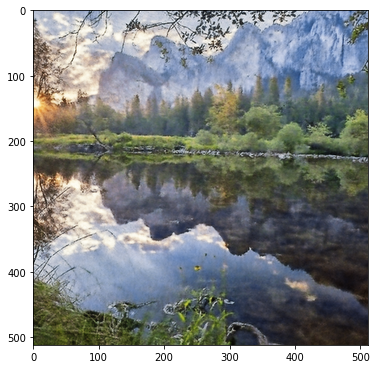

Проход 01151    Ошибка 0.003507
Проход 01152    Ошибка 0.003464
Проход 01153    Ошибка 0.003442
Проход 01154    Ошибка 0.003508
Проход 01155    Ошибка 0.003462
Проход 01156    Ошибка 0.003423
Проход 01157    Ошибка 0.003427
Проход 01158    Ошибка 0.003464
Проход 01159    Ошибка 0.003429
Проход 01160    Ошибка 0.003490
Проход 01161    Ошибка 0.003412
Проход 01162    Ошибка 0.003412
Проход 01163    Ошибка 0.003438
Проход 01164    Ошибка 0.003416
Проход 01165    Ошибка 0.003380
Проход 01166    Ошибка 0.003477
Проход 01167    Ошибка 0.003453
Проход 01168    Ошибка 0.003422
Проход 01169    Ошибка 0.003417
Проход 01170    Ошибка 0.003396
Проход 01171    Ошибка 0.003383
Проход 01172    Ошибка 0.003500
Проход 01173    Ошибка 0.003508
Проход 01174    Ошибка 0.003390
Проход 01175    Ошибка 0.003386
Проход 01176    Ошибка 0.003429
Проход 01177    Ошибка 0.003401
Проход 01178    Ошибка 0.003386
Проход 01179    Ошибка 0.003380
Проход 01180    Ошибка 0.003346
Проход 01181    Ошибка 0.003345
Проход 0

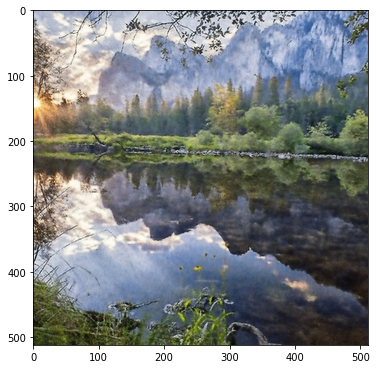

Проход 01201    Ошибка 0.003319
Проход 01202    Ошибка 0.003350
Проход 01203    Ошибка 0.003442
Проход 01204    Ошибка 0.003327
Проход 01205    Ошибка 0.003327
Проход 01206    Ошибка 0.003359
Проход 01207    Ошибка 0.003334
Проход 01208    Ошибка 0.003284
Проход 01209    Ошибка 0.003318
Проход 01210    Ошибка 0.003277
Проход 01211    Ошибка 0.003298
Проход 01212    Ошибка 0.003310
Проход 01213    Ошибка 0.003298
Проход 01214    Ошибка 0.003269
Проход 01215    Ошибка 0.003302
Проход 01216    Ошибка 0.003289
Проход 01217    Ошибка 0.003263
Проход 01218    Ошибка 0.003253
Проход 01219    Ошибка 0.003277
Проход 01220    Ошибка 0.003302
Проход 01221    Ошибка 0.003259
Проход 01222    Ошибка 0.003264
Проход 01223    Ошибка 0.003267
Проход 01224    Ошибка 0.003296
Проход 01225    Ошибка 0.003314
Проход 01226    Ошибка 0.003253
Проход 01227    Ошибка 0.003229
Проход 01228    Ошибка 0.003289
Проход 01229    Ошибка 0.003232
Проход 01230    Ошибка 0.003247
Проход 01231    Ошибка 0.003242
Проход 0

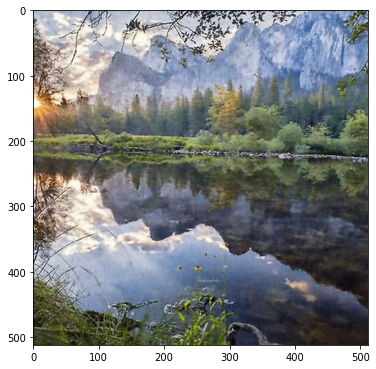

Проход 01251    Ошибка 0.003185
Проход 01252    Ошибка 0.003181
Проход 01253    Ошибка 0.003185
Проход 01254    Ошибка 0.003178
Проход 01255    Ошибка 0.003183
Проход 01256    Ошибка 0.003169
Проход 01257    Ошибка 0.003169
Проход 01258    Ошибка 0.003182
Проход 01259    Ошибка 0.003237
Проход 01260    Ошибка 0.003179
Проход 01261    Ошибка 0.003219
Проход 01262    Ошибка 0.003141
Проход 01263    Ошибка 0.003227
Проход 01264    Ошибка 0.003186
Проход 01265    Ошибка 0.003234
Проход 01266    Ошибка 0.003132
Проход 01267    Ошибка 0.003235
Проход 01268    Ошибка 0.003214
Проход 01269    Ошибка 0.003203
Проход 01270    Ошибка 0.003155
Проход 01271    Ошибка 0.003154
Проход 01272    Ошибка 0.003123
Проход 01273    Ошибка 0.003119
Проход 01274    Ошибка 0.003130
Проход 01275    Ошибка 0.003138
Проход 01276    Ошибка 0.003128
Проход 01277    Ошибка 0.003208
Проход 01278    Ошибка 0.003160
Проход 01279    Ошибка 0.003181
Проход 01280    Ошибка 0.003077
Проход 01281    Ошибка 0.003097
Проход 0

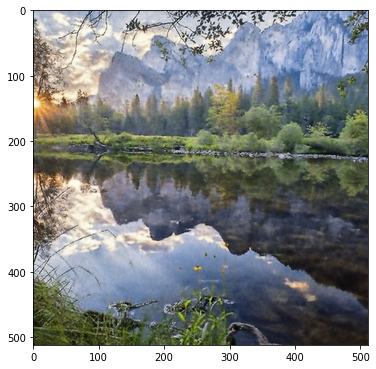

Проход 01301    Ошибка 0.003079
Проход 01302    Ошибка 0.003052
Проход 01303    Ошибка 0.003062
Проход 01304    Ошибка 0.003064
Проход 01305    Ошибка 0.003048
Проход 01306    Ошибка 0.003053
Проход 01307    Ошибка 0.003018
Проход 01308    Ошибка 0.003083
Проход 01309    Ошибка 0.003054
Проход 01310    Ошибка 0.003041
Проход 01311    Ошибка 0.003080
Проход 01312    Ошибка 0.003054
Проход 01313    Ошибка 0.003047
Проход 01314    Ошибка 0.003006
Проход 01315    Ошибка 0.003081
Проход 01316    Ошибка 0.003080
Проход 01317    Ошибка 0.003024
Проход 01318    Ошибка 0.003064
Проход 01319    Ошибка 0.003111
Проход 01320    Ошибка 0.003037
Проход 01321    Ошибка 0.002999
Проход 01322    Ошибка 0.003054
Проход 01323    Ошибка 0.003036
Проход 01324    Ошибка 0.002998
Проход 01325    Ошибка 0.003010
Проход 01326    Ошибка 0.003018
Проход 01327    Ошибка 0.002984
Проход 01328    Ошибка 0.003046
Проход 01329    Ошибка 0.003137
Проход 01330    Ошибка 0.003088
Проход 01331    Ошибка 0.003014
Проход 0

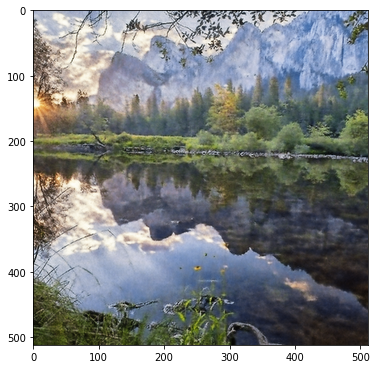

Проход 01351    Ошибка 0.002986
Проход 01352    Ошибка 0.002932
Проход 01353    Ошибка 0.002976
Проход 01354    Ошибка 0.002992
Проход 01355    Ошибка 0.002931
Проход 01356    Ошибка 0.002941
Проход 01357    Ошибка 0.002966
Проход 01358    Ошибка 0.002959
Проход 01359    Ошибка 0.002905
Проход 01360    Ошибка 0.002959
Проход 01361    Ошибка 0.002951
Проход 01362    Ошибка 0.002935
Проход 01363    Ошибка 0.002944
Проход 01364    Ошибка 0.002973
Проход 01365    Ошибка 0.002934
Проход 01366    Ошибка 0.002912
Проход 01367    Ошибка 0.002918
Проход 01368    Ошибка 0.002933
Проход 01369    Ошибка 0.002906
Проход 01370    Ошибка 0.002918
Проход 01371    Ошибка 0.002903
Проход 01372    Ошибка 0.002910
Проход 01373    Ошибка 0.002936
Проход 01374    Ошибка 0.002929
Проход 01375    Ошибка 0.002944
Проход 01376    Ошибка 0.002961
Проход 01377    Ошибка 0.002997
Проход 01378    Ошибка 0.002926
Проход 01379    Ошибка 0.002906
Проход 01380    Ошибка 0.002927
Проход 01381    Ошибка 0.002899
Проход 0

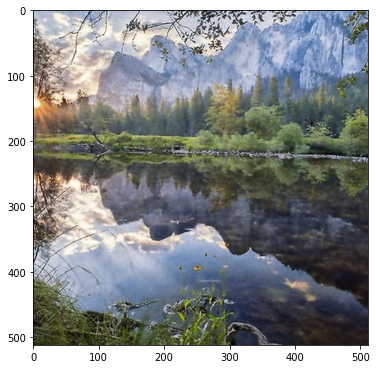

Проход 01401    Ошибка 0.002892
Проход 01402    Ошибка 0.002842
Проход 01403    Ошибка 0.002888
Проход 01404    Ошибка 0.002898
Проход 01405    Ошибка 0.002899
Проход 01406    Ошибка 0.002884
Проход 01407    Ошибка 0.002851
Проход 01408    Ошибка 0.002937
Проход 01409    Ошибка 0.002870
Проход 01410    Ошибка 0.002849
Проход 01411    Ошибка 0.002939
Проход 01412    Ошибка 0.002903
Проход 01413    Ошибка 0.002810
Проход 01414    Ошибка 0.002881
Проход 01415    Ошибка 0.002921
Проход 01416    Ошибка 0.002826
Проход 01417    Ошибка 0.002863
Проход 01418    Ошибка 0.002887
Проход 01419    Ошибка 0.002834
Проход 01420    Ошибка 0.002839
Проход 01421    Ошибка 0.002912
Проход 01422    Ошибка 0.002860
Проход 01423    Ошибка 0.002799
Проход 01424    Ошибка 0.002798
Проход 01425    Ошибка 0.002812
Проход 01426    Ошибка 0.002781
Проход 01427    Ошибка 0.002821
Проход 01428    Ошибка 0.002842
Проход 01429    Ошибка 0.002772
Проход 01430    Ошибка 0.002791
Проход 01431    Ошибка 0.002861
Проход 0

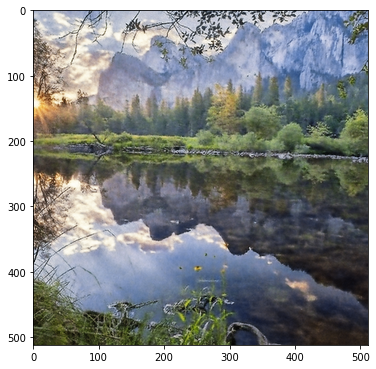

Проход 01451    Ошибка 0.002739
Проход 01452    Ошибка 0.002792
Проход 01453    Ошибка 0.002812
Проход 01454    Ошибка 0.002832
Проход 01455    Ошибка 0.002756
Проход 01456    Ошибка 0.002750
Проход 01457    Ошибка 0.002741
Проход 01458    Ошибка 0.002773
Проход 01459    Ошибка 0.002709
Проход 01460    Ошибка 0.002750
Проход 01461    Ошибка 0.002731
Проход 01462    Ошибка 0.002713
Проход 01463    Ошибка 0.002748
Проход 01464    Ошибка 0.002757
Проход 01465    Ошибка 0.002722
Проход 01466    Ошибка 0.002746
Проход 01467    Ошибка 0.002727
Проход 01468    Ошибка 0.002737
Проход 01469    Ошибка 0.002706
Проход 01470    Ошибка 0.002713
Проход 01471    Ошибка 0.002711
Проход 01472    Ошибка 0.002726
Проход 01473    Ошибка 0.002722
Проход 01474    Ошибка 0.002815
Проход 01475    Ошибка 0.002973
Проход 01476    Ошибка 0.002950
Проход 01477    Ошибка 0.002808
Проход 01478    Ошибка 0.002901
Проход 01479    Ошибка 0.002926
Проход 01480    Ошибка 0.002723
Проход 01481    Ошибка 0.002777
Проход 0

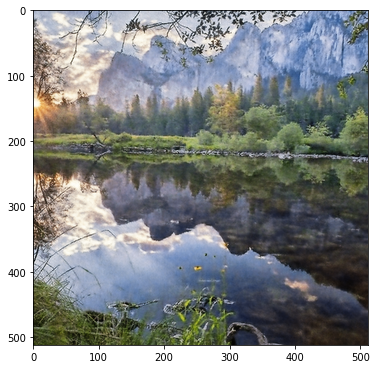

Проход 01501    Ошибка 0.002775
Проход 01502    Ошибка 0.002685
Проход 01503    Ошибка 0.002775
Проход 01504    Ошибка 0.002704
Проход 01505    Ошибка 0.002683
Проход 01506    Ошибка 0.002712
Проход 01507    Ошибка 0.002643
Проход 01508    Ошибка 0.002667
Проход 01509    Ошибка 0.002689
Проход 01510    Ошибка 0.002647
Проход 01511    Ошибка 0.002667
Проход 01512    Ошибка 0.002665
Проход 01513    Ошибка 0.002674
Проход 01514    Ошибка 0.002682
Проход 01515    Ошибка 0.002635
Проход 01516    Ошибка 0.002651
Проход 01517    Ошибка 0.002650
Проход 01518    Ошибка 0.002649
Проход 01519    Ошибка 0.002635
Проход 01520    Ошибка 0.002596
Проход 01521    Ошибка 0.002651
Проход 01522    Ошибка 0.002657
Проход 01523    Ошибка 0.002610
Проход 01524    Ошибка 0.002650
Проход 01525    Ошибка 0.002632
Проход 01526    Ошибка 0.002605
Проход 01527    Ошибка 0.002623
Проход 01528    Ошибка 0.002599
Проход 01529    Ошибка 0.002605
Проход 01530    Ошибка 0.002596
Проход 01531    Ошибка 0.002576
Проход 0

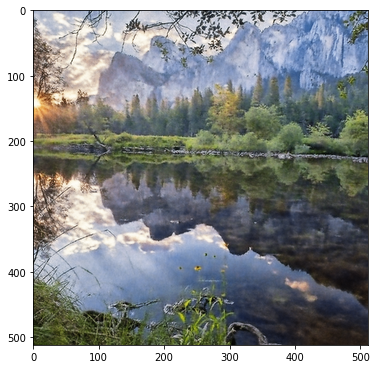

Проход 01551    Ошибка 0.002590
Проход 01552    Ошибка 0.002588
Проход 01553    Ошибка 0.002581
Проход 01554    Ошибка 0.002570
Проход 01555    Ошибка 0.002584
Проход 01556    Ошибка 0.002611
Проход 01557    Ошибка 0.002669
Проход 01558    Ошибка 0.002602
Проход 01559    Ошибка 0.002584
Проход 01560    Ошибка 0.002632
Проход 01561    Ошибка 0.002629
Проход 01562    Ошибка 0.002637
Проход 01563    Ошибка 0.002603
Проход 01564    Ошибка 0.002563
Проход 01565    Ошибка 0.002579
Проход 01566    Ошибка 0.002597
Проход 01567    Ошибка 0.002550
Проход 01568    Ошибка 0.002610
Проход 01569    Ошибка 0.002721
Проход 01570    Ошибка 0.002565
Проход 01571    Ошибка 0.002563
Проход 01572    Ошибка 0.002645
Проход 01573    Ошибка 0.002554
Проход 01574    Ошибка 0.002537
Проход 01575    Ошибка 0.002644
Проход 01576    Ошибка 0.002554
Проход 01577    Ошибка 0.002553
Проход 01578    Ошибка 0.002598
Проход 01579    Ошибка 0.002524
Проход 01580    Ошибка 0.002513
Проход 01581    Ошибка 0.002521
Проход 0

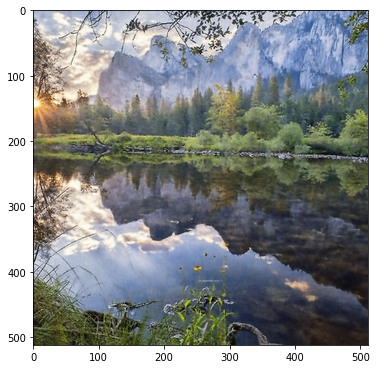

Проход 01601    Ошибка 0.002462
Проход 01602    Ошибка 0.002498
Проход 01603    Ошибка 0.002541
Проход 01604    Ошибка 0.002497
Проход 01605    Ошибка 0.002473
Проход 01606    Ошибка 0.002475
Проход 01607    Ошибка 0.002473
Проход 01608    Ошибка 0.002461
Проход 01609    Ошибка 0.002460
Проход 01610    Ошибка 0.002468
Проход 01611    Ошибка 0.002461
Проход 01612    Ошибка 0.002460
Проход 01613    Ошибка 0.002445
Проход 01614    Ошибка 0.002458
Проход 01615    Ошибка 0.002453
Проход 01616    Ошибка 0.002470
Проход 01617    Ошибка 0.002446
Проход 01618    Ошибка 0.002449
Проход 01619    Ошибка 0.002440
Проход 01620    Ошибка 0.002436
Проход 01621    Ошибка 0.002424
Проход 01622    Ошибка 0.002441
Проход 01623    Ошибка 0.002456
Проход 01624    Ошибка 0.002427
Проход 01625    Ошибка 0.002422
Проход 01626    Ошибка 0.002417
Проход 01627    Ошибка 0.002464
Проход 01628    Ошибка 0.002419
Проход 01629    Ошибка 0.002447
Проход 01630    Ошибка 0.002423
Проход 01631    Ошибка 0.002407
Проход 0

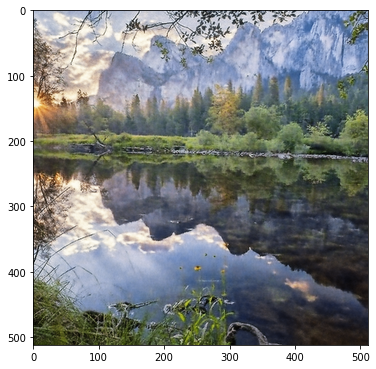

Проход 01651    Ошибка 0.002369
Проход 01652    Ошибка 0.002471
Проход 01653    Ошибка 0.002455
Проход 01654    Ошибка 0.002408
Проход 01655    Ошибка 0.002382
Проход 01656    Ошибка 0.002427
Проход 01657    Ошибка 0.002371
Проход 01658    Ошибка 0.002386
Проход 01659    Ошибка 0.002387
Проход 01660    Ошибка 0.002386
Проход 01661    Ошибка 0.002388
Проход 01662    Ошибка 0.002409
Проход 01663    Ошибка 0.002401
Проход 01664    Ошибка 0.002403
Проход 01665    Ошибка 0.002372
Проход 01666    Ошибка 0.002362
Проход 01667    Ошибка 0.002377
Проход 01668    Ошибка 0.002412
Проход 01669    Ошибка 0.002431
Проход 01670    Ошибка 0.002382
Проход 01671    Ошибка 0.002344
Проход 01672    Ошибка 0.002390
Проход 01673    Ошибка 0.002432
Проход 01674    Ошибка 0.002396
Проход 01675    Ошибка 0.002348
Проход 01676    Ошибка 0.002369
Проход 01677    Ошибка 0.002379
Проход 01678    Ошибка 0.002372
Проход 01679    Ошибка 0.002341
Проход 01680    Ошибка 0.002348
Проход 01681    Ошибка 0.002366
Проход 0

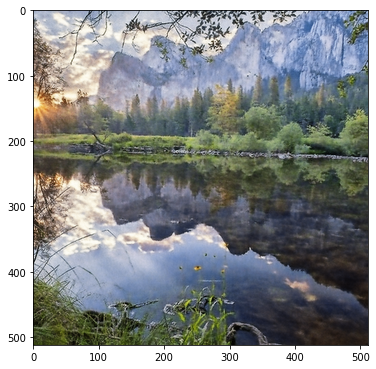

Проход 01701    Ошибка 0.002365
Проход 01702    Ошибка 0.002310
Проход 01703    Ошибка 0.002305
Проход 01704    Ошибка 0.002362
Проход 01705    Ошибка 0.002360
Проход 01706    Ошибка 0.002339
Проход 01707    Ошибка 0.002326
Проход 01708    Ошибка 0.002331
Проход 01709    Ошибка 0.002344
Проход 01710    Ошибка 0.002362
Проход 01711    Ошибка 0.002304
Проход 01712    Ошибка 0.002321
Проход 01713    Ошибка 0.002319
Проход 01714    Ошибка 0.002307
Проход 01715    Ошибка 0.002302
Проход 01716    Ошибка 0.002318
Проход 01717    Ошибка 0.002290
Проход 01718    Ошибка 0.002283
Проход 01719    Ошибка 0.002303
Проход 01720    Ошибка 0.002286
Проход 01721    Ошибка 0.002291
Проход 01722    Ошибка 0.002282
Проход 01723    Ошибка 0.002283
Проход 01724    Ошибка 0.002293
Проход 01725    Ошибка 0.002330
Проход 01726    Ошибка 0.002311
Проход 01727    Ошибка 0.002296
Проход 01728    Ошибка 0.002277
Проход 01729    Ошибка 0.002307
Проход 01730    Ошибка 0.002294
Проход 01731    Ошибка 0.002283
Проход 0

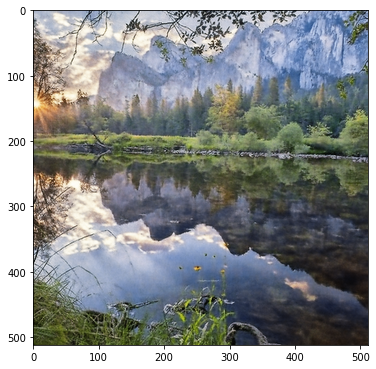

Проход 01751    Ошибка 0.002271
Проход 01752    Ошибка 0.002244
Проход 01753    Ошибка 0.002288
Проход 01754    Ошибка 0.002332
Проход 01755    Ошибка 0.002280
Проход 01756    Ошибка 0.002271
Проход 01757    Ошибка 0.002269
Проход 01758    Ошибка 0.002235
Проход 01759    Ошибка 0.002245
Проход 01760    Ошибка 0.002251
Проход 01761    Ошибка 0.002228
Проход 01762    Ошибка 0.002236
Проход 01763    Ошибка 0.002278
Проход 01764    Ошибка 0.002292
Проход 01765    Ошибка 0.002234
Проход 01766    Ошибка 0.002194
Проход 01767    Ошибка 0.002226
Проход 01768    Ошибка 0.002205
Проход 01769    Ошибка 0.002196
Проход 01770    Ошибка 0.002212
Проход 01771    Ошибка 0.002196
Проход 01772    Ошибка 0.002211
Проход 01773    Ошибка 0.002193
Проход 01774    Ошибка 0.002194
Проход 01775    Ошибка 0.002190
Проход 01776    Ошибка 0.002214
Проход 01777    Ошибка 0.002213
Проход 01778    Ошибка 0.002248
Проход 01779    Ошибка 0.002266
Проход 01780    Ошибка 0.002229
Проход 01781    Ошибка 0.002180
Проход 0

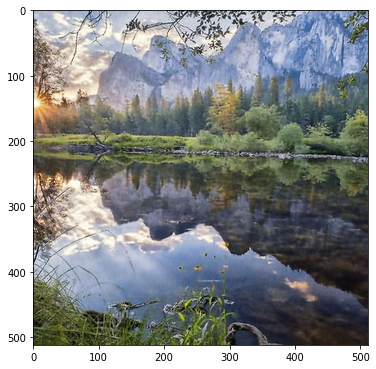

Проход 01801    Ошибка 0.002181
Проход 01802    Ошибка 0.002161
Проход 01803    Ошибка 0.002212
Проход 01804    Ошибка 0.002233
Проход 01805    Ошибка 0.002226
Проход 01806    Ошибка 0.002217
Проход 01807    Ошибка 0.002189
Проход 01808    Ошибка 0.002183
Проход 01809    Ошибка 0.002181
Проход 01810    Ошибка 0.002150
Проход 01811    Ошибка 0.002173
Проход 01812    Ошибка 0.002181
Проход 01813    Ошибка 0.002183
Проход 01814    Ошибка 0.002175
Проход 01815    Ошибка 0.002180
Проход 01816    Ошибка 0.002143
Проход 01817    Ошибка 0.002118
Проход 01818    Ошибка 0.002243
Проход 01819    Ошибка 0.002288
Проход 01820    Ошибка 0.002256
Проход 01821    Ошибка 0.002190
Проход 01822    Ошибка 0.002176
Проход 01823    Ошибка 0.002271
Проход 01824    Ошибка 0.002166
Проход 01825    Ошибка 0.002163
Проход 01826    Ошибка 0.002237
Проход 01827    Ошибка 0.002224
Проход 01828    Ошибка 0.002184
Проход 01829    Ошибка 0.002166
Проход 01830    Ошибка 0.002194
Проход 01831    Ошибка 0.002172
Проход 0

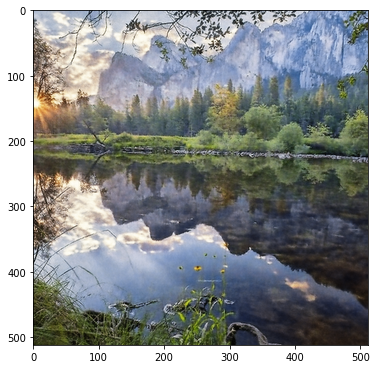

Проход 01851    Ошибка 0.002105
Проход 01852    Ошибка 0.002103
Проход 01853    Ошибка 0.002108
Проход 01854    Ошибка 0.002080
Проход 01855    Ошибка 0.002079
Проход 01856    Ошибка 0.002100
Проход 01857    Ошибка 0.002095
Проход 01858    Ошибка 0.002075
Проход 01859    Ошибка 0.002088
Проход 01860    Ошибка 0.002091
Проход 01861    Ошибка 0.002091
Проход 01862    Ошибка 0.002113
Проход 01863    Ошибка 0.002142
Проход 01864    Ошибка 0.002157
Проход 01865    Ошибка 0.002121
Проход 01866    Ошибка 0.002106
Проход 01867    Ошибка 0.002116
Проход 01868    Ошибка 0.002071
Проход 01869    Ошибка 0.002089
Проход 01870    Ошибка 0.002104
Проход 01871    Ошибка 0.002148
Проход 01872    Ошибка 0.002111
Проход 01873    Ошибка 0.002090
Проход 01874    Ошибка 0.002079
Проход 01875    Ошибка 0.002094
Проход 01876    Ошибка 0.002088
Проход 01877    Ошибка 0.002096
Проход 01878    Ошибка 0.002040
Проход 01879    Ошибка 0.002057
Проход 01880    Ошибка 0.002098
Проход 01881    Ошибка 0.002111
Проход 0

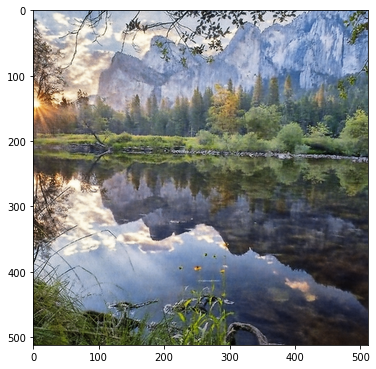

Проход 01901    Ошибка 0.002034
Проход 01902    Ошибка 0.002053
Проход 01903    Ошибка 0.002027
Проход 01904    Ошибка 0.002061
Проход 01905    Ошибка 0.002027
Проход 01906    Ошибка 0.002026
Проход 01907    Ошибка 0.002010
Проход 01908    Ошибка 0.002043
Проход 01909    Ошибка 0.002021
Проход 01910    Ошибка 0.002027
Проход 01911    Ошибка 0.002029
Проход 01912    Ошибка 0.002033
Проход 01913    Ошибка 0.002023
Проход 01914    Ошибка 0.002011
Проход 01915    Ошибка 0.001989
Проход 01916    Ошибка 0.002006
Проход 01917    Ошибка 0.002016
Проход 01918    Ошибка 0.002044
Проход 01919    Ошибка 0.002027
Проход 01920    Ошибка 0.002007
Проход 01921    Ошибка 0.001996
Проход 01922    Ошибка 0.002024
Проход 01923    Ошибка 0.002062
Проход 01924    Ошибка 0.002043
Проход 01925    Ошибка 0.002051
Проход 01926    Ошибка 0.002055
Проход 01927    Ошибка 0.002030
Проход 01928    Ошибка 0.002031
Проход 01929    Ошибка 0.002020
Проход 01930    Ошибка 0.002016
Проход 01931    Ошибка 0.002028
Проход 0

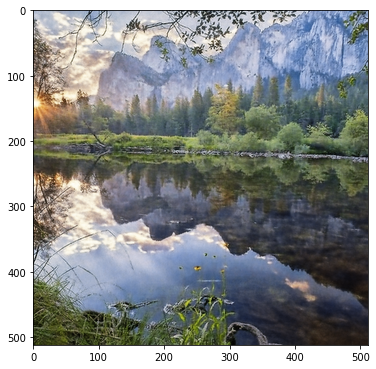

Проход 01951    Ошибка 0.001942
Проход 01952    Ошибка 0.001983
Проход 01953    Ошибка 0.002000
Проход 01954    Ошибка 0.001970
Проход 01955    Ошибка 0.001966
Проход 01956    Ошибка 0.001946
Проход 01957    Ошибка 0.001964
Проход 01958    Ошибка 0.001972
Проход 01959    Ошибка 0.001946
Проход 01960    Ошибка 0.001938
Проход 01961    Ошибка 0.001950
Проход 01962    Ошибка 0.001948
Проход 01963    Ошибка 0.001988
Проход 01964    Ошибка 0.001932
Проход 01965    Ошибка 0.001940
Проход 01966    Ошибка 0.001934
Проход 01967    Ошибка 0.001954
Проход 01968    Ошибка 0.001947
Проход 01969    Ошибка 0.001953
Проход 01970    Ошибка 0.001956
Проход 01971    Ошибка 0.001952
Проход 01972    Ошибка 0.001922
Проход 01973    Ошибка 0.001955
Проход 01974    Ошибка 0.001982
Проход 01975    Ошибка 0.002052
Проход 01976    Ошибка 0.002053
Проход 01977    Ошибка 0.001955
Проход 01978    Ошибка 0.001909
Проход 01979    Ошибка 0.002010
Проход 01980    Ошибка 0.002105
Проход 01981    Ошибка 0.002073
Проход 0

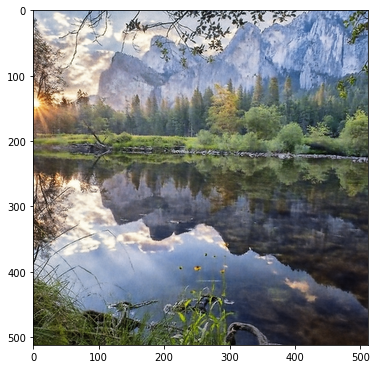

Проход 02001    Ошибка 0.001883
Проход 02002    Ошибка 0.001906
Проход 02003    Ошибка 0.001908
Проход 02004    Ошибка 0.001888
Проход 02005    Ошибка 0.001870
Проход 02006    Ошибка 0.001900
Проход 02007    Ошибка 0.001870
Проход 02008    Ошибка 0.001883
Проход 02009    Ошибка 0.001884
Проход 02010    Ошибка 0.001872
Проход 02011    Ошибка 0.001875
Проход 02012    Ошибка 0.001908
Проход 02013    Ошибка 0.001885
Проход 02014    Ошибка 0.001902
Проход 02015    Ошибка 0.001894
Проход 02016    Ошибка 0.001934
Проход 02017    Ошибка 0.001933
Проход 02018    Ошибка 0.001923
Проход 02019    Ошибка 0.001917
Проход 02020    Ошибка 0.001928
Проход 02021    Ошибка 0.001981
Проход 02022    Ошибка 0.001956
Проход 02023    Ошибка 0.001937
Проход 02024    Ошибка 0.001884
Проход 02025    Ошибка 0.001896
Проход 02026    Ошибка 0.001924
Проход 02027    Ошибка 0.001939
Проход 02028    Ошибка 0.001906
Проход 02029    Ошибка 0.001865
Проход 02030    Ошибка 0.001880
Проход 02031    Ошибка 0.001905
Проход 0

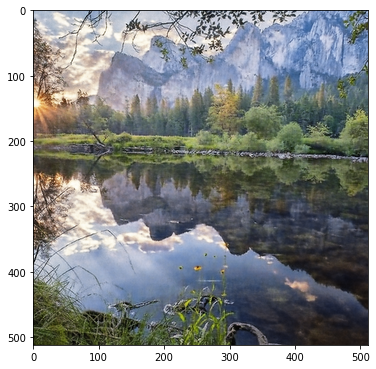

Проход 02051    Ошибка 0.001832
Проход 02052    Ошибка 0.001851
Проход 02053    Ошибка 0.001899
Проход 02054    Ошибка 0.001932
Проход 02055    Ошибка 0.001919
Проход 02056    Ошибка 0.001906
Проход 02057    Ошибка 0.001874
Проход 02058    Ошибка 0.001882
Проход 02059    Ошибка 0.001855
Проход 02060    Ошибка 0.001849
Проход 02061    Ошибка 0.001894
Проход 02062    Ошибка 0.001859
Проход 02063    Ошибка 0.001825
Проход 02064    Ошибка 0.001829
Проход 02065    Ошибка 0.001823
Проход 02066    Ошибка 0.001816
Проход 02067    Ошибка 0.001840
Проход 02068    Ошибка 0.001861
Проход 02069    Ошибка 0.001887
Проход 02070    Ошибка 0.001871
Проход 02071    Ошибка 0.001834
Проход 02072    Ошибка 0.001824
Проход 02073    Ошибка 0.001834
Проход 02074    Ошибка 0.001829
Проход 02075    Ошибка 0.001847
Проход 02076    Ошибка 0.001871
Проход 02077    Ошибка 0.001869
Проход 02078    Ошибка 0.001857
Проход 02079    Ошибка 0.001830
Проход 02080    Ошибка 0.001848
Проход 02081    Ошибка 0.001833
Проход 0

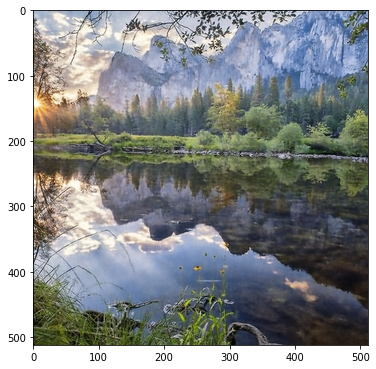

Проход 02101    Ошибка 0.001808
Проход 02102    Ошибка 0.001786
Проход 02103    Ошибка 0.001761
Проход 02104    Ошибка 0.001776
Проход 02105    Ошибка 0.001793
Проход 02106    Ошибка 0.001791
Проход 02107    Ошибка 0.001772
Проход 02108    Ошибка 0.001776
Проход 02109    Ошибка 0.001812
Проход 02110    Ошибка 0.001784
Проход 02111    Ошибка 0.001767
Проход 02112    Ошибка 0.001756
Проход 02113    Ошибка 0.001796
Проход 02114    Ошибка 0.001809
Проход 02115    Ошибка 0.001828
Проход 02116    Ошибка 0.001806
Проход 02117    Ошибка 0.001779
Проход 02118    Ошибка 0.001751
Проход 02119    Ошибка 0.001813
Проход 02120    Ошибка 0.001864
Проход 02121    Ошибка 0.001866
Проход 02122    Ошибка 0.001794
Проход 02123    Ошибка 0.001786
Проход 02124    Ошибка 0.001810
Проход 02125    Ошибка 0.001792
Проход 02126    Ошибка 0.001763
Проход 02127    Ошибка 0.001781
Проход 02128    Ошибка 0.001801
Проход 02129    Ошибка 0.001801
Проход 02130    Ошибка 0.001751
Проход 02131    Ошибка 0.001766
Проход 0

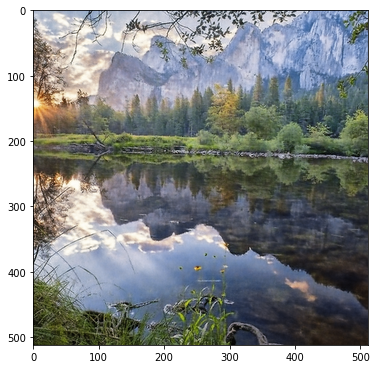

Проход 02151    Ошибка 0.001871
Проход 02152    Ошибка 0.001936
Проход 02153    Ошибка 0.001901
Проход 02154    Ошибка 0.001798
Проход 02155    Ошибка 0.001746
Проход 02156    Ошибка 0.001833
Проход 02157    Ошибка 0.001826
Проход 02158    Ошибка 0.001750
Проход 02159    Ошибка 0.001756
Проход 02160    Ошибка 0.001772
Проход 02161    Ошибка 0.001741
Проход 02162    Ошибка 0.001724
Проход 02163    Ошибка 0.001769
Проход 02164    Ошибка 0.001773
Проход 02165    Ошибка 0.001745
Проход 02166    Ошибка 0.001717
Проход 02167    Ошибка 0.001731
Проход 02168    Ошибка 0.001729
Проход 02169    Ошибка 0.001710
Проход 02170    Ошибка 0.001722
Проход 02171    Ошибка 0.001766
Проход 02172    Ошибка 0.001768
Проход 02173    Ошибка 0.001733
Проход 02174    Ошибка 0.001738
Проход 02175    Ошибка 0.001730
Проход 02176    Ошибка 0.001731
Проход 02177    Ошибка 0.001707
Проход 02178    Ошибка 0.001733
Проход 02179    Ошибка 0.001748
Проход 02180    Ошибка 0.001740
Проход 02181    Ошибка 0.001709
Проход 0

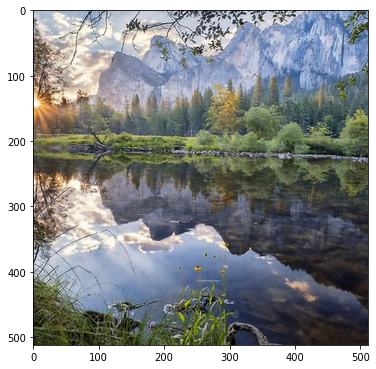

Проход 02201    Ошибка 0.001676
Проход 02202    Ошибка 0.001678
Проход 02203    Ошибка 0.001716
Проход 02204    Ошибка 0.001706
Проход 02205    Ошибка 0.001676
Проход 02206    Ошибка 0.001683
Проход 02207    Ошибка 0.001695
Проход 02208    Ошибка 0.001710
Проход 02209    Ошибка 0.001687
Проход 02210    Ошибка 0.001698
Проход 02211    Ошибка 0.001763
Проход 02212    Ошибка 0.001742
Проход 02213    Ошибка 0.001689
Проход 02214    Ошибка 0.001693
Проход 02215    Ошибка 0.001744
Проход 02216    Ошибка 0.001708
Проход 02217    Ошибка 0.001662
Проход 02218    Ошибка 0.001692
Проход 02219    Ошибка 0.001712
Проход 02220    Ошибка 0.001688
Проход 02221    Ошибка 0.001648
Проход 02222    Ошибка 0.001665
Проход 02223    Ошибка 0.001677
Проход 02224    Ошибка 0.001638
Проход 02225    Ошибка 0.001643
Проход 02226    Ошибка 0.001652
Проход 02227    Ошибка 0.001634
Проход 02228    Ошибка 0.001629
Проход 02229    Ошибка 0.001621
Проход 02230    Ошибка 0.001630
Проход 02231    Ошибка 0.001642
Проход 0

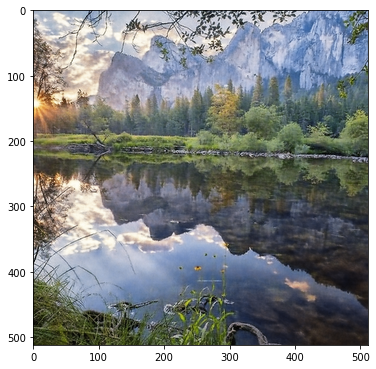

Проход 02251    Ошибка 0.001618
Проход 02252    Ошибка 0.001610
Проход 02253    Ошибка 0.001611
Проход 02254    Ошибка 0.001585
Проход 02255    Ошибка 0.001598
Проход 02256    Ошибка 0.001614
Проход 02257    Ошибка 0.001614
Проход 02258    Ошибка 0.001653
Проход 02259    Ошибка 0.001647
Проход 02260    Ошибка 0.001618
Проход 02261    Ошибка 0.001599
Проход 02262    Ошибка 0.001598
Проход 02263    Ошибка 0.001602
Проход 02264    Ошибка 0.001588
Проход 02265    Ошибка 0.001633
Проход 02266    Ошибка 0.001641
Проход 02267    Ошибка 0.001669
Проход 02268    Ошибка 0.001690
Проход 02269    Ошибка 0.001674
Проход 02270    Ошибка 0.001617
Проход 02271    Ошибка 0.001636
Проход 02272    Ошибка 0.001651
Проход 02273    Ошибка 0.001653
Проход 02274    Ошибка 0.001639
Проход 02275    Ошибка 0.001634
Проход 02276    Ошибка 0.001627
Проход 02277    Ошибка 0.001634
Проход 02278    Ошибка 0.001597
Проход 02279    Ошибка 0.001578
Проход 02280    Ошибка 0.001615
Проход 02281    Ошибка 0.001630
Проход 0

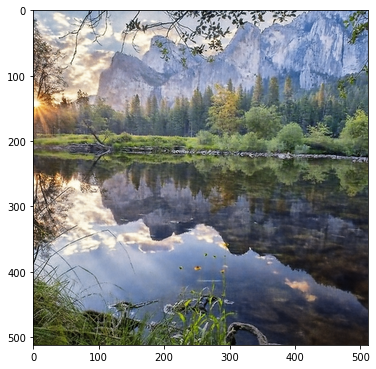

Проход 02301    Ошибка 0.001577
Проход 02302    Ошибка 0.001594
Проход 02303    Ошибка 0.001625
Проход 02304    Ошибка 0.001638
Проход 02305    Ошибка 0.001664
Проход 02306    Ошибка 0.001721
Проход 02307    Ошибка 0.001739
Проход 02308    Ошибка 0.001623
Проход 02309    Ошибка 0.001610
Проход 02310    Ошибка 0.001631
Проход 02311    Ошибка 0.001632
Проход 02312    Ошибка 0.001593
Проход 02313    Ошибка 0.001574
Проход 02314    Ошибка 0.001657
Проход 02315    Ошибка 0.001661
Проход 02316    Ошибка 0.001590
Проход 02317    Ошибка 0.001574
Проход 02318    Ошибка 0.001567
Проход 02319    Ошибка 0.001607
Проход 02320    Ошибка 0.001580
Проход 02321    Ошибка 0.001582
Проход 02322    Ошибка 0.001587
Проход 02323    Ошибка 0.001578
Проход 02324    Ошибка 0.001539
Проход 02325    Ошибка 0.001568
Проход 02326    Ошибка 0.001589
Проход 02327    Ошибка 0.001559
Проход 02328    Ошибка 0.001541
Проход 02329    Ошибка 0.001543
Проход 02330    Ошибка 0.001558
Проход 02331    Ошибка 0.001549
Проход 0

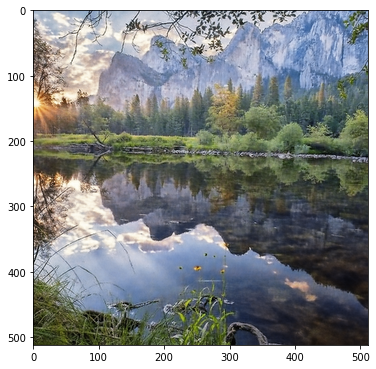

Проход 02351    Ошибка 0.001512
Проход 02352    Ошибка 0.001507
Проход 02353    Ошибка 0.001503
Проход 02354    Ошибка 0.001514
Проход 02355    Ошибка 0.001499
Проход 02356    Ошибка 0.001497
Проход 02357    Ошибка 0.001497
Проход 02358    Ошибка 0.001495
Проход 02359    Ошибка 0.001516
Проход 02360    Ошибка 0.001531
Проход 02361    Ошибка 0.001525
Проход 02362    Ошибка 0.001510
Проход 02363    Ошибка 0.001488
Проход 02364    Ошибка 0.001483
Проход 02365    Ошибка 0.001504
Проход 02366    Ошибка 0.001498
Проход 02367    Ошибка 0.001496
Проход 02368    Ошибка 0.001483
Проход 02369    Ошибка 0.001479
Проход 02370    Ошибка 0.001489
Проход 02371    Ошибка 0.001481
Проход 02372    Ошибка 0.001507
Проход 02373    Ошибка 0.001527
Проход 02374    Ошибка 0.001554
Проход 02375    Ошибка 0.001530
Проход 02376    Ошибка 0.001479
Проход 02377    Ошибка 0.001474
Проход 02378    Ошибка 0.001477
Проход 02379    Ошибка 0.001493
Проход 02380    Ошибка 0.001493
Проход 02381    Ошибка 0.001489
Проход 0

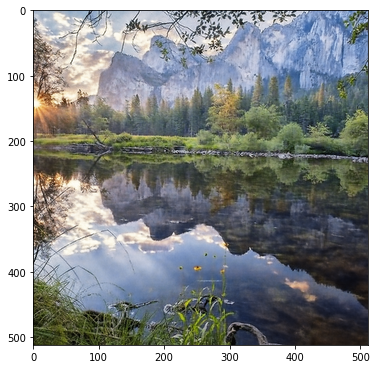

Проход 02401    Ошибка 0.001473
Проход 02402    Ошибка 0.001508
Проход 02403    Ошибка 0.001531
Проход 02404    Ошибка 0.001550
Проход 02405    Ошибка 0.001502
Проход 02406    Ошибка 0.001541
Проход 02407    Ошибка 0.001519
Проход 02408    Ошибка 0.001523
Проход 02409    Ошибка 0.001521
Проход 02410    Ошибка 0.001510
Проход 02411    Ошибка 0.001527
Проход 02412    Ошибка 0.001513
Проход 02413    Ошибка 0.001537
Проход 02414    Ошибка 0.001499
Проход 02415    Ошибка 0.001481
Проход 02416    Ошибка 0.001473
Проход 02417    Ошибка 0.001507
Проход 02418    Ошибка 0.001465
Проход 02419    Ошибка 0.001450
Проход 02420    Ошибка 0.001467
Проход 02421    Ошибка 0.001492
Проход 02422    Ошибка 0.001452
Проход 02423    Ошибка 0.001443
Проход 02424    Ошибка 0.001481
Проход 02425    Ошибка 0.001458
Проход 02426    Ошибка 0.001443
Проход 02427    Ошибка 0.001474
Проход 02428    Ошибка 0.001459
Проход 02429    Ошибка 0.001440
Проход 02430    Ошибка 0.001487
Проход 02431    Ошибка 0.001444
Проход 0

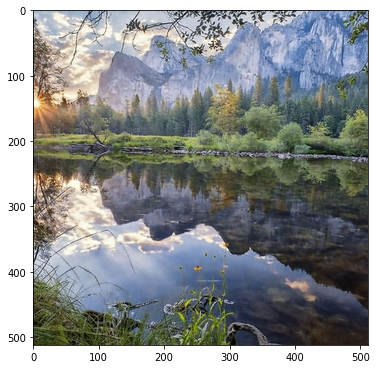

Проход 02451    Ошибка 0.001453
Проход 02452    Ошибка 0.001482
Проход 02453    Ошибка 0.001512
Проход 02454    Ошибка 0.001449
Проход 02455    Ошибка 0.001408
Проход 02456    Ошибка 0.001472
Проход 02457    Ошибка 0.001501
Проход 02458    Ошибка 0.001474
Проход 02459    Ошибка 0.001431
Проход 02460    Ошибка 0.001511
Проход 02461    Ошибка 0.001543
Проход 02462    Ошибка 0.001494
Проход 02463    Ошибка 0.001425
Проход 02464    Ошибка 0.001445
Проход 02465    Ошибка 0.001505
Проход 02466    Ошибка 0.001438
Проход 02467    Ошибка 0.001426
Проход 02468    Ошибка 0.001458
Проход 02469    Ошибка 0.001466
Проход 02470    Ошибка 0.001407
Проход 02471    Ошибка 0.001411
Проход 02472    Ошибка 0.001446
Проход 02473    Ошибка 0.001450
Проход 02474    Ошибка 0.001398
Проход 02475    Ошибка 0.001399
Проход 02476    Ошибка 0.001436
Проход 02477    Ошибка 0.001402
Проход 02478    Ошибка 0.001402
Проход 02479    Ошибка 0.001427
Проход 02480    Ошибка 0.001456
Проход 02481    Ошибка 0.001443
Проход 0

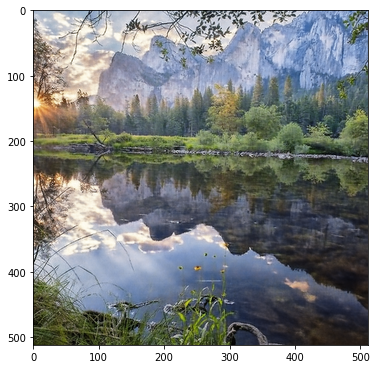

Проход 02501    Ошибка 0.001362
Проход 02502    Ошибка 0.001376
Проход 02503    Ошибка 0.001412
Проход 02504    Ошибка 0.001402
Проход 02505    Ошибка 0.001380
Проход 02506    Ошибка 0.001388
Проход 02507    Ошибка 0.001430
Проход 02508    Ошибка 0.001428
Проход 02509    Ошибка 0.001365
Проход 02510    Ошибка 0.001366
Проход 02511    Ошибка 0.001413
Проход 02512    Ошибка 0.001414
Проход 02513    Ошибка 0.001368
Проход 02514    Ошибка 0.001354
Проход 02515    Ошибка 0.001344
Проход 02516    Ошибка 0.001384
Проход 02517    Ошибка 0.001382
Проход 02518    Ошибка 0.001430
Проход 02519    Ошибка 0.001414
Проход 02520    Ошибка 0.001455
Проход 02521    Ошибка 0.001424
Проход 02522    Ошибка 0.001370
Проход 02523    Ошибка 0.001390
Проход 02524    Ошибка 0.001445
Проход 02525    Ошибка 0.001420
Проход 02526    Ошибка 0.001379
Проход 02527    Ошибка 0.001412
Проход 02528    Ошибка 0.001378
Проход 02529    Ошибка 0.001373
Проход 02530    Ошибка 0.001411
Проход 02531    Ошибка 0.001368
Проход 0

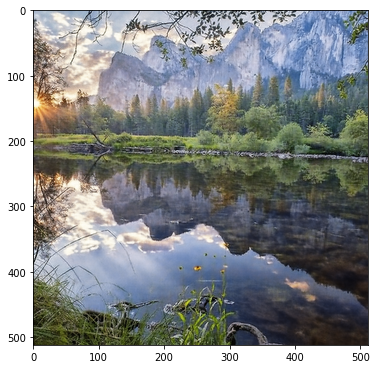

Проход 02551    Ошибка 0.001323
Проход 02552    Ошибка 0.001351
Проход 02553    Ошибка 0.001342
Проход 02554    Ошибка 0.001329
Проход 02555    Ошибка 0.001321
Проход 02556    Ошибка 0.001304
Проход 02557    Ошибка 0.001309
Проход 02558    Ошибка 0.001336
Проход 02559    Ошибка 0.001364
Проход 02560    Ошибка 0.001375
Проход 02561    Ошибка 0.001349
Проход 02562    Ошибка 0.001331
Проход 02563    Ошибка 0.001330
Проход 02564    Ошибка 0.001375
Проход 02565    Ошибка 0.001392
Проход 02566    Ошибка 0.001370
Проход 02567    Ошибка 0.001354
Проход 02568    Ошибка 0.001406
Проход 02569    Ошибка 0.001455
Проход 02570    Ошибка 0.001415
Проход 02571    Ошибка 0.001327
Проход 02572    Ошибка 0.001353
Проход 02573    Ошибка 0.001369
Проход 02574    Ошибка 0.001339
Проход 02575    Ошибка 0.001343
Проход 02576    Ошибка 0.001361
Проход 02577    Ошибка 0.001325
Проход 02578    Ошибка 0.001299
Проход 02579    Ошибка 0.001324
Проход 02580    Ошибка 0.001310
Проход 02581    Ошибка 0.001333
Проход 0

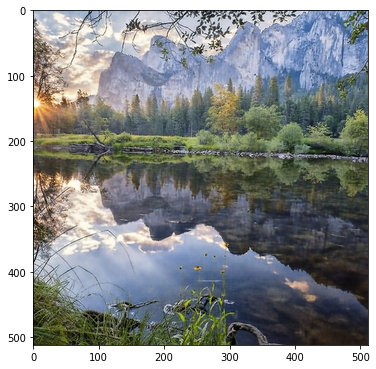

Проход 02601    Ошибка 0.001296
Проход 02602    Ошибка 0.001282
Проход 02603    Ошибка 0.001272
Проход 02604    Ошибка 0.001286
Проход 02605    Ошибка 0.001280
Проход 02606    Ошибка 0.001293
Проход 02607    Ошибка 0.001285
Проход 02608    Ошибка 0.001293
Проход 02609    Ошибка 0.001272
Проход 02610    Ошибка 0.001272
Проход 02611    Ошибка 0.001278
Проход 02612    Ошибка 0.001302
Проход 02613    Ошибка 0.001360
Проход 02614    Ошибка 0.001397
Проход 02615    Ошибка 0.001413
Проход 02616    Ошибка 0.001333
Проход 02617    Ошибка 0.001316
Проход 02618    Ошибка 0.001346
Проход 02619    Ошибка 0.001360
Проход 02620    Ошибка 0.001317
Проход 02621    Ошибка 0.001324
Проход 02622    Ошибка 0.001330
Проход 02623    Ошибка 0.001333
Проход 02624    Ошибка 0.001340
Проход 02625    Ошибка 0.001288
Проход 02626    Ошибка 0.001295
Проход 02627    Ошибка 0.001273
Проход 02628    Ошибка 0.001284
Проход 02629    Ошибка 0.001290
Проход 02630    Ошибка 0.001300
Проход 02631    Ошибка 0.001265
Проход 0

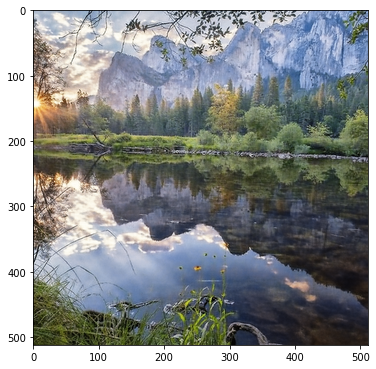

Проход 02651    Ошибка 0.001351
Проход 02652    Ошибка 0.001304
Проход 02653    Ошибка 0.001283
Проход 02654    Ошибка 0.001318
Проход 02655    Ошибка 0.001364
Проход 02656    Ошибка 0.001329
Проход 02657    Ошибка 0.001273
Проход 02658    Ошибка 0.001271
Проход 02659    Ошибка 0.001406
Проход 02660    Ошибка 0.001424
Проход 02661    Ошибка 0.001295
Проход 02662    Ошибка 0.001292
Проход 02663    Ошибка 0.001392
Проход 02664    Ошибка 0.001353
Проход 02665    Ошибка 0.001263
Проход 02666    Ошибка 0.001343
Проход 02667    Ошибка 0.001355
Проход 02668    Ошибка 0.001272
Проход 02669    Ошибка 0.001293
Проход 02670    Ошибка 0.001312
Проход 02671    Ошибка 0.001273
Проход 02672    Ошибка 0.001268
Проход 02673    Ошибка 0.001301
Проход 02674    Ошибка 0.001226
Проход 02675    Ошибка 0.001251
Проход 02676    Ошибка 0.001260
Проход 02677    Ошибка 0.001236
Проход 02678    Ошибка 0.001225
Проход 02679    Ошибка 0.001248
Проход 02680    Ошибка 0.001222
Проход 02681    Ошибка 0.001226
Проход 0

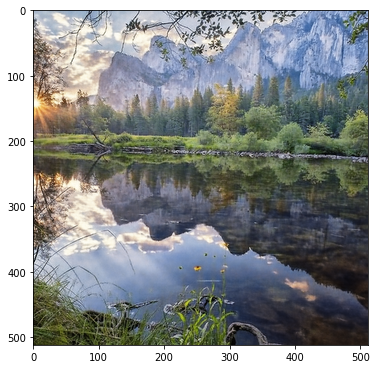

Проход 02701    Ошибка 0.001186
Проход 02702    Ошибка 0.001192
Проход 02703    Ошибка 0.001205
Проход 02704    Ошибка 0.001195
Проход 02705    Ошибка 0.001193
Проход 02706    Ошибка 0.001188
Проход 02707    Ошибка 0.001213
Проход 02708    Ошибка 0.001212
Проход 02709    Ошибка 0.001213
Проход 02710    Ошибка 0.001189
Проход 02711    Ошибка 0.001199
Проход 02712    Ошибка 0.001197
Проход 02713    Ошибка 0.001209
Проход 02714    Ошибка 0.001191
Проход 02715    Ошибка 0.001189
Проход 02716    Ошибка 0.001180
Проход 02717    Ошибка 0.001190
Проход 02718    Ошибка 0.001169
Проход 02719    Ошибка 0.001174
Проход 02720    Ошибка 0.001171
Проход 02721    Ошибка 0.001179
Проход 02722    Ошибка 0.001188
Проход 02723    Ошибка 0.001194
Проход 02724    Ошибка 0.001200
Проход 02725    Ошибка 0.001201
Проход 02726    Ошибка 0.001202
Проход 02727    Ошибка 0.001195
Проход 02728    Ошибка 0.001204
Проход 02729    Ошибка 0.001177
Проход 02730    Ошибка 0.001168
Проход 02731    Ошибка 0.001174
Проход 0

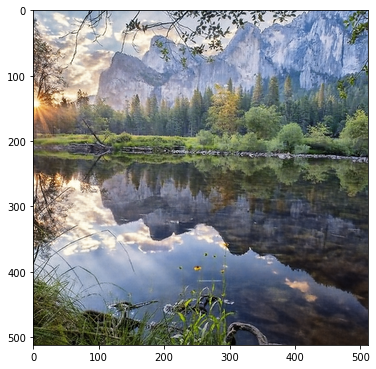

Проход 02751    Ошибка 0.001184
Проход 02752    Ошибка 0.001162
Проход 02753    Ошибка 0.001224
Проход 02754    Ошибка 0.001220
Проход 02755    Ошибка 0.001193
Проход 02756    Ошибка 0.001191
Проход 02757    Ошибка 0.001155
Проход 02758    Ошибка 0.001166
Проход 02759    Ошибка 0.001158
Проход 02760    Ошибка 0.001186
Проход 02761    Ошибка 0.001170
Проход 02762    Ошибка 0.001147
Проход 02763    Ошибка 0.001165
Проход 02764    Ошибка 0.001147
Проход 02765    Ошибка 0.001140
Проход 02766    Ошибка 0.001145
Проход 02767    Ошибка 0.001141
Проход 02768    Ошибка 0.001160
Проход 02769    Ошибка 0.001178
Проход 02770    Ошибка 0.001176
Проход 02771    Ошибка 0.001144
Проход 02772    Ошибка 0.001126
Проход 02773    Ошибка 0.001144
Проход 02774    Ошибка 0.001134
Проход 02775    Ошибка 0.001135
Проход 02776    Ошибка 0.001126
Проход 02777    Ошибка 0.001146
Проход 02778    Ошибка 0.001164
Проход 02779    Ошибка 0.001210
Проход 02780    Ошибка 0.001250
Проход 02781    Ошибка 0.001250
Проход 0

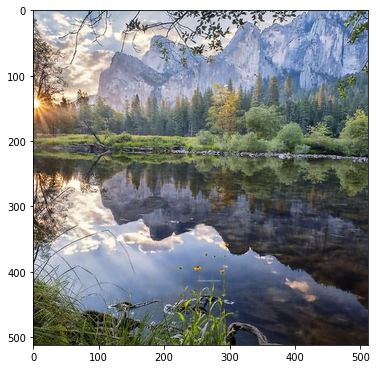

Проход 02801    Ошибка 0.001132
Проход 02802    Ошибка 0.001128
Проход 02803    Ошибка 0.001146
Проход 02804    Ошибка 0.001160
Проход 02805    Ошибка 0.001143
Проход 02806    Ошибка 0.001129
Проход 02807    Ошибка 0.001121
Проход 02808    Ошибка 0.001119
Проход 02809    Ошибка 0.001129
Проход 02810    Ошибка 0.001129
Проход 02811    Ошибка 0.001141
Проход 02812    Ошибка 0.001161
Проход 02813    Ошибка 0.001223
Проход 02814    Ошибка 0.001212
Проход 02815    Ошибка 0.001163
Проход 02816    Ошибка 0.001116
Проход 02817    Ошибка 0.001138
Проход 02818    Ошибка 0.001140
Проход 02819    Ошибка 0.001157
Проход 02820    Ошибка 0.001158
Проход 02821    Ошибка 0.001117
Проход 02822    Ошибка 0.001133
Проход 02823    Ошибка 0.001167
Проход 02824    Ошибка 0.001152
Проход 02825    Ошибка 0.001108
Проход 02826    Ошибка 0.001121
Проход 02827    Ошибка 0.001122
Проход 02828    Ошибка 0.001105
Проход 02829    Ошибка 0.001102
Проход 02830    Ошибка 0.001100
Проход 02831    Ошибка 0.001103
Проход 0

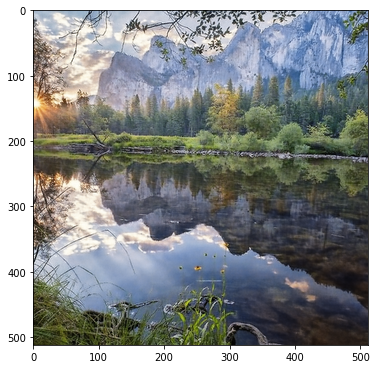

Проход 02851    Ошибка 0.001087
Проход 02852    Ошибка 0.001083
Проход 02853    Ошибка 0.001081
Проход 02854    Ошибка 0.001080
Проход 02855    Ошибка 0.001086
Проход 02856    Ошибка 0.001090
Проход 02857    Ошибка 0.001091
Проход 02858    Ошибка 0.001083
Проход 02859    Ошибка 0.001075
Проход 02860    Ошибка 0.001075
Проход 02861    Ошибка 0.001072
Проход 02862    Ошибка 0.001069
Проход 02863    Ошибка 0.001071
Проход 02864    Ошибка 0.001059
Проход 02865    Ошибка 0.001058
Проход 02866    Ошибка 0.001054
Проход 02867    Ошибка 0.001063
Проход 02868    Ошибка 0.001062
Проход 02869    Ошибка 0.001066
Проход 02870    Ошибка 0.001067
Проход 02871    Ошибка 0.001079
Проход 02872    Ошибка 0.001086
Проход 02873    Ошибка 0.001110
Проход 02874    Ошибка 0.001138
Проход 02875    Ошибка 0.001131
Проход 02876    Ошибка 0.001129
Проход 02877    Ошибка 0.001148
Проход 02878    Ошибка 0.001222
Проход 02879    Ошибка 0.001212
Проход 02880    Ошибка 0.001114
Проход 02881    Ошибка 0.001095
Проход 0

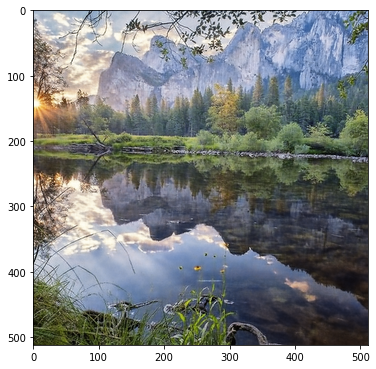

Проход 02901    Ошибка 0.001078
Проход 02902    Ошибка 0.001080
Проход 02903    Ошибка 0.001081
Проход 02904    Ошибка 0.001058
Проход 02905    Ошибка 0.001058
Проход 02906    Ошибка 0.001063
Проход 02907    Ошибка 0.001074
Проход 02908    Ошибка 0.001073
Проход 02909    Ошибка 0.001044
Проход 02910    Ошибка 0.001049
Проход 02911    Ошибка 0.001079
Проход 02912    Ошибка 0.001058
Проход 02913    Ошибка 0.001053
Проход 02914    Ошибка 0.001065
Проход 02915    Ошибка 0.001074
Проход 02916    Ошибка 0.001042
Проход 02917    Ошибка 0.001046
Проход 02918    Ошибка 0.001074
Проход 02919    Ошибка 0.001054
Проход 02920    Ошибка 0.001046
Проход 02921    Ошибка 0.001084
Проход 02922    Ошибка 0.001178
Проход 02923    Ошибка 0.001142
Проход 02924    Ошибка 0.001090
Проход 02925    Ошибка 0.001066
Проход 02926    Ошибка 0.001049
Проход 02927    Ошибка 0.001078
Проход 02928    Ошибка 0.001079
Проход 02929    Ошибка 0.001049
Проход 02930    Ошибка 0.001016
Проход 02931    Ошибка 0.001025
Проход 0

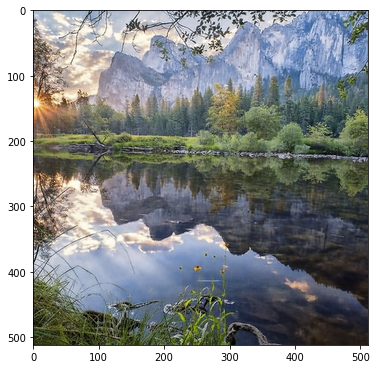

Проход 02951    Ошибка 0.001039
Проход 02952    Ошибка 0.001034
Проход 02953    Ошибка 0.001016
Проход 02954    Ошибка 0.001031
Проход 02955    Ошибка 0.001061
Проход 02956    Ошибка 0.001075
Проход 02957    Ошибка 0.001079
Проход 02958    Ошибка 0.001056
Проход 02959    Ошибка 0.001046
Проход 02960    Ошибка 0.001077
Проход 02961    Ошибка 0.001058
Проход 02962    Ошибка 0.001031
Проход 02963    Ошибка 0.001009
Проход 02964    Ошибка 0.001021
Проход 02965    Ошибка 0.001029
Проход 02966    Ошибка 0.001004
Проход 02967    Ошибка 0.001000
Проход 02968    Ошибка 0.001023
Проход 02969    Ошибка 0.000999
Проход 02970    Ошибка 0.000997
Проход 02971    Ошибка 0.001040
Проход 02972    Ошибка 0.001036
Проход 02973    Ошибка 0.001030
Проход 02974    Ошибка 0.001027
Проход 02975    Ошибка 0.001019
Проход 02976    Ошибка 0.001003
Проход 02977    Ошибка 0.000984
Проход 02978    Ошибка 0.001023
Проход 02979    Ошибка 0.001044
Проход 02980    Ошибка 0.001025
Проход 02981    Ошибка 0.001041
Проход 0

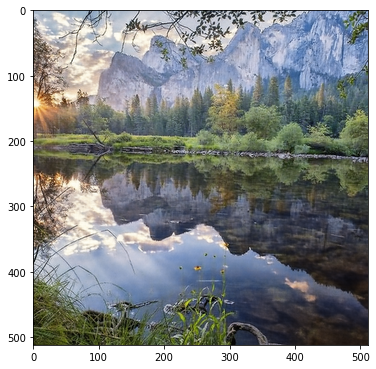

Проход 03001    Ошибка 0.001045
Проход 03002    Ошибка 0.001044
Проход 03003    Ошибка 0.001019
Проход 03004    Ошибка 0.001012
Проход 03005    Ошибка 0.001036
Проход 03006    Ошибка 0.001100
Проход 03007    Ошибка 0.001113
Проход 03008    Ошибка 0.001056
Проход 03009    Ошибка 0.001003
Проход 03010    Ошибка 0.001020
Проход 03011    Ошибка 0.001010
Проход 03012    Ошибка 0.001016
Проход 03013    Ошибка 0.001011
Проход 03014    Ошибка 0.001005
Проход 03015    Ошибка 0.001009
Проход 03016    Ошибка 0.001004
Проход 03017    Ошибка 0.001009
Проход 03018    Ошибка 0.000981
Проход 03019    Ошибка 0.000976
Проход 03020    Ошибка 0.000987
Проход 03021    Ошибка 0.000967
Проход 03022    Ошибка 0.000979
Проход 03023    Ошибка 0.000969
Проход 03024    Ошибка 0.000970
Проход 03025    Ошибка 0.000982
Проход 03026    Ошибка 0.000977
Проход 03027    Ошибка 0.000980
Проход 03028    Ошибка 0.001004
Проход 03029    Ошибка 0.001003
Проход 03030    Ошибка 0.000979
Проход 03031    Ошибка 0.000949
Проход 0

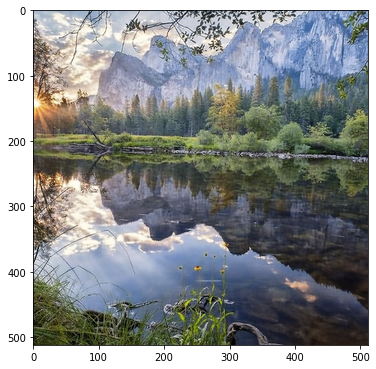

Проход 03051    Ошибка 0.001035
Проход 03052    Ошибка 0.001051
Проход 03053    Ошибка 0.001018
Проход 03054    Ошибка 0.000985
Проход 03055    Ошибка 0.000977
Проход 03056    Ошибка 0.001001
Проход 03057    Ошибка 0.001017
Проход 03058    Ошибка 0.001001
Проход 03059    Ошибка 0.000978
Проход 03060    Ошибка 0.000941
Проход 03061    Ошибка 0.000971
Проход 03062    Ошибка 0.000980
Проход 03063    Ошибка 0.000970
Проход 03064    Ошибка 0.000945
Проход 03065    Ошибка 0.000949
Проход 03066    Ошибка 0.000953
Проход 03067    Ошибка 0.000933
Проход 03068    Ошибка 0.000940
Проход 03069    Ошибка 0.000936
Проход 03070    Ошибка 0.000941
Проход 03071    Ошибка 0.000947
Проход 03072    Ошибка 0.000935
Проход 03073    Ошибка 0.000945
Проход 03074    Ошибка 0.000951
Проход 03075    Ошибка 0.000948
Проход 03076    Ошибка 0.000939
Проход 03077    Ошибка 0.000923
Проход 03078    Ошибка 0.000936
Проход 03079    Ошибка 0.000938
Проход 03080    Ошибка 0.000944
Проход 03081    Ошибка 0.000926
Проход 0

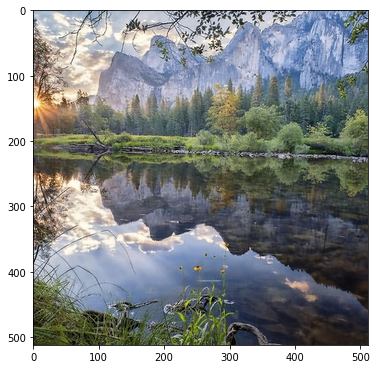

Проход 03101    Ошибка 0.000926
Проход 03102    Ошибка 0.000935
Проход 03103    Ошибка 0.000951
Проход 03104    Ошибка 0.000952
Проход 03105    Ошибка 0.000954
Проход 03106    Ошибка 0.000948
Проход 03107    Ошибка 0.000945
Проход 03108    Ошибка 0.000919
Проход 03109    Ошибка 0.000907
Проход 03110    Ошибка 0.000904
Проход 03111    Ошибка 0.000905
Проход 03112    Ошибка 0.000902
Проход 03113    Ошибка 0.000909
Проход 03114    Ошибка 0.000915
Проход 03115    Ошибка 0.000899
Проход 03116    Ошибка 0.000920
Проход 03117    Ошибка 0.000914
Проход 03118    Ошибка 0.000927
Проход 03119    Ошибка 0.000920
Проход 03120    Ошибка 0.000913
Проход 03121    Ошибка 0.000934
Проход 03122    Ошибка 0.000925
Проход 03123    Ошибка 0.000940
Проход 03124    Ошибка 0.000944
Проход 03125    Ошибка 0.000924
Проход 03126    Ошибка 0.000965
Проход 03127    Ошибка 0.000990
Проход 03128    Ошибка 0.001025
Проход 03129    Ошибка 0.001036
Проход 03130    Ошибка 0.001057
Проход 03131    Ошибка 0.000991
Проход 0

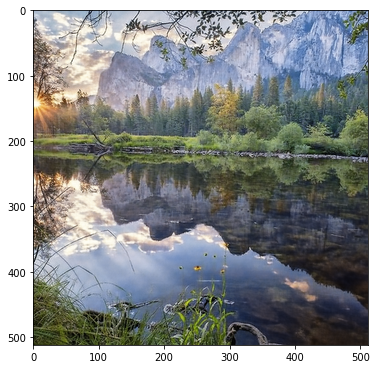

Проход 03151    Ошибка 0.000871
Проход 03152    Ошибка 0.000879
Проход 03153    Ошибка 0.000875
Проход 03154    Ошибка 0.000879
Проход 03155    Ошибка 0.000880
Проход 03156    Ошибка 0.000897
Проход 03157    Ошибка 0.000899
Проход 03158    Ошибка 0.000905
Проход 03159    Ошибка 0.000887
Проход 03160    Ошибка 0.000880
Проход 03161    Ошибка 0.000868
Проход 03162    Ошибка 0.000877
Проход 03163    Ошибка 0.000886
Проход 03164    Ошибка 0.000881
Проход 03165    Ошибка 0.000869
Проход 03166    Ошибка 0.000866
Проход 03167    Ошибка 0.000890
Проход 03168    Ошибка 0.000890
Проход 03169    Ошибка 0.000884
Проход 03170    Ошибка 0.000884
Проход 03171    Ошибка 0.000908
Проход 03172    Ошибка 0.000931
Проход 03173    Ошибка 0.000912
Проход 03174    Ошибка 0.000899
Проход 03175    Ошибка 0.000872
Проход 03176    Ошибка 0.000884
Проход 03177    Ошибка 0.000895
Проход 03178    Ошибка 0.000917
Проход 03179    Ошибка 0.000918
Проход 03180    Ошибка 0.000940
Проход 03181    Ошибка 0.000890
Проход 0

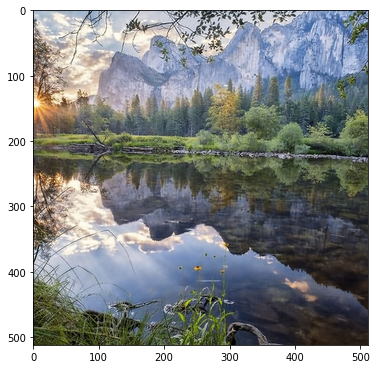

Проход 03201    Ошибка 0.000908
Проход 03202    Ошибка 0.000877
Проход 03203    Ошибка 0.000870
Проход 03204    Ошибка 0.000884
Проход 03205    Ошибка 0.000894
Проход 03206    Ошибка 0.000899
Проход 03207    Ошибка 0.000894
Проход 03208    Ошибка 0.000886
Проход 03209    Ошибка 0.000858
Проход 03210    Ошибка 0.000883
Проход 03211    Ошибка 0.000882
Проход 03212    Ошибка 0.000858
Проход 03213    Ошибка 0.000865
Проход 03214    Ошибка 0.000867
Проход 03215    Ошибка 0.000851
Проход 03216    Ошибка 0.000846
Проход 03217    Ошибка 0.000857
Проход 03218    Ошибка 0.000843
Проход 03219    Ошибка 0.000840
Проход 03220    Ошибка 0.000839
Проход 03221    Ошибка 0.000841
Проход 03222    Ошибка 0.000844
Проход 03223    Ошибка 0.000853
Проход 03224    Ошибка 0.000864
Проход 03225    Ошибка 0.000845
Проход 03226    Ошибка 0.000836
Проход 03227    Ошибка 0.000828
Проход 03228    Ошибка 0.000827
Проход 03229    Ошибка 0.000827
Проход 03230    Ошибка 0.000842
Проход 03231    Ошибка 0.000860
Проход 0

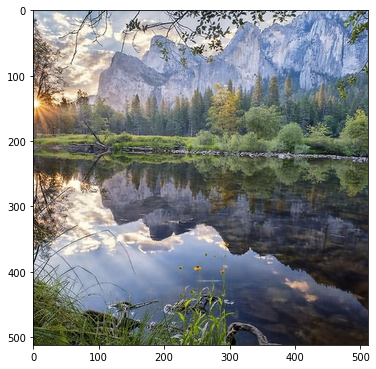

Проход 03251    Ошибка 0.000891
Проход 03252    Ошибка 0.000866
Проход 03253    Ошибка 0.000880
Проход 03254    Ошибка 0.000896
Проход 03255    Ошибка 0.000864
Проход 03256    Ошибка 0.000853
Проход 03257    Ошибка 0.000861
Проход 03258    Ошибка 0.000891
Проход 03259    Ошибка 0.000850
Проход 03260    Ошибка 0.000856
Проход 03261    Ошибка 0.000861
Проход 03262    Ошибка 0.000858
Проход 03263    Ошибка 0.000842
Проход 03264    Ошибка 0.000855
Проход 03265    Ошибка 0.000844
Проход 03266    Ошибка 0.000840
Проход 03267    Ошибка 0.000821
Проход 03268    Ошибка 0.000833
Проход 03269    Ошибка 0.000841
Проход 03270    Ошибка 0.000840
Проход 03271    Ошибка 0.000837
Проход 03272    Ошибка 0.000825
Проход 03273    Ошибка 0.000821
Проход 03274    Ошибка 0.000837
Проход 03275    Ошибка 0.000871
Проход 03276    Ошибка 0.000852
Проход 03277    Ошибка 0.000855
Проход 03278    Ошибка 0.000862
Проход 03279    Ошибка 0.000838
Проход 03280    Ошибка 0.000836
Проход 03281    Ошибка 0.000846
Проход 0

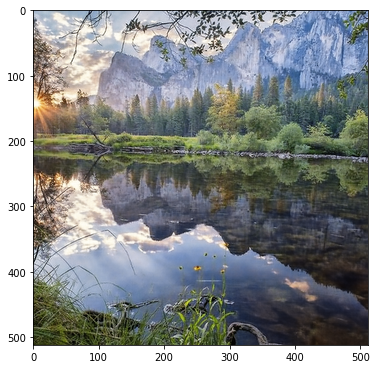

Проход 03301    Ошибка 0.000808
Проход 03302    Ошибка 0.000800
Проход 03303    Ошибка 0.000800
Проход 03304    Ошибка 0.000805
Проход 03305    Ошибка 0.000794
Проход 03306    Ошибка 0.000799
Проход 03307    Ошибка 0.000788
Проход 03308    Ошибка 0.000795
Проход 03309    Ошибка 0.000797
Проход 03310    Ошибка 0.000789
Проход 03311    Ошибка 0.000784
Проход 03312    Ошибка 0.000783
Проход 03313    Ошибка 0.000802
Проход 03314    Ошибка 0.000812
Проход 03315    Ошибка 0.000829
Проход 03316    Ошибка 0.000829
Проход 03317    Ошибка 0.000848
Проход 03318    Ошибка 0.000869
Проход 03319    Ошибка 0.000879
Проход 03320    Ошибка 0.000846
Проход 03321    Ошибка 0.000821
Проход 03322    Ошибка 0.000819
Проход 03323    Ошибка 0.000824
Проход 03324    Ошибка 0.000828
Проход 03325    Ошибка 0.000840
Проход 03326    Ошибка 0.000882
Проход 03327    Ошибка 0.000848
Проход 03328    Ошибка 0.000826
Проход 03329    Ошибка 0.000797
Проход 03330    Ошибка 0.000798
Проход 03331    Ошибка 0.000814
Проход 0

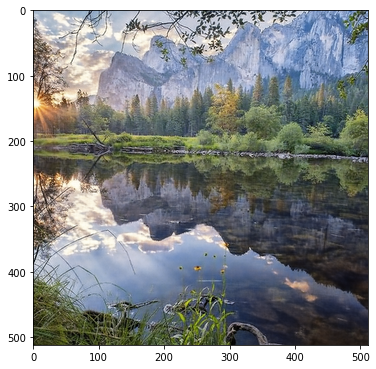

Проход 03351    Ошибка 0.000784
Проход 03352    Ошибка 0.000787
Проход 03353    Ошибка 0.000793
Проход 03354    Ошибка 0.000788
Проход 03355    Ошибка 0.000771
Проход 03356    Ошибка 0.000773
Проход 03357    Ошибка 0.000777
Проход 03358    Ошибка 0.000765
Проход 03359    Ошибка 0.000760
Проход 03360    Ошибка 0.000763
Проход 03361    Ошибка 0.000761
Проход 03362    Ошибка 0.000765
Проход 03363    Ошибка 0.000755
Проход 03364    Ошибка 0.000748
Проход 03365    Ошибка 0.000749
Проход 03366    Ошибка 0.000750
Проход 03367    Ошибка 0.000752
Проход 03368    Ошибка 0.000752
Проход 03369    Ошибка 0.000741
Проход 03370    Ошибка 0.000748
Проход 03371    Ошибка 0.000772
Проход 03372    Ошибка 0.000771
Проход 03373    Ошибка 0.000756
Проход 03374    Ошибка 0.000758
Проход 03375    Ошибка 0.000758
Проход 03376    Ошибка 0.000766
Проход 03377    Ошибка 0.000785
Проход 03378    Ошибка 0.000828
Проход 03379    Ошибка 0.000871
Проход 03380    Ошибка 0.000892
Проход 03381    Ошибка 0.000893
Проход 0

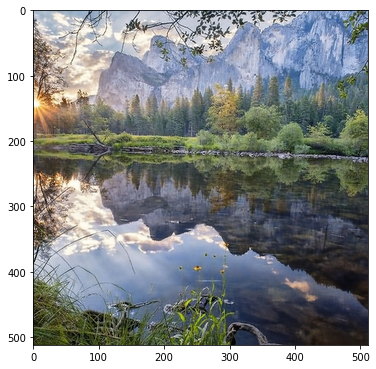

Проход 03401    Ошибка 0.000766
Проход 03402    Ошибка 0.000764
Проход 03403    Ошибка 0.000779
Проход 03404    Ошибка 0.000761
Проход 03405    Ошибка 0.000757
Проход 03406    Ошибка 0.000759
Проход 03407    Ошибка 0.000754
Проход 03408    Ошибка 0.000757
Проход 03409    Ошибка 0.000758
Проход 03410    Ошибка 0.000768
Проход 03411    Ошибка 0.000780
Проход 03412    Ошибка 0.000768
Проход 03413    Ошибка 0.000767
Проход 03414    Ошибка 0.000755
Проход 03415    Ошибка 0.000762
Проход 03416    Ошибка 0.000775
Проход 03417    Ошибка 0.000771
Проход 03418    Ошибка 0.000796
Проход 03419    Ошибка 0.000809
Проход 03420    Ошибка 0.000875
Проход 03421    Ошибка 0.000842
Проход 03422    Ошибка 0.000805
Проход 03423    Ошибка 0.000793
Проход 03424    Ошибка 0.000788
Проход 03425    Ошибка 0.000802
Проход 03426    Ошибка 0.000791
Проход 03427    Ошибка 0.000782
Проход 03428    Ошибка 0.000801
Проход 03429    Ошибка 0.000763
Проход 03430    Ошибка 0.000767
Проход 03431    Ошибка 0.000753
Проход 0

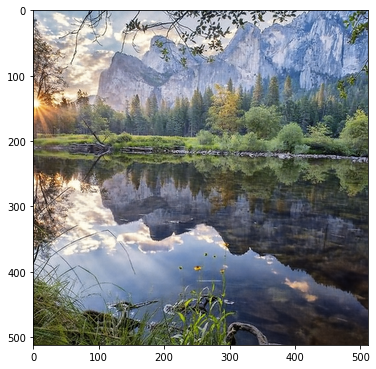

Проход 03451    Ошибка 0.000734
Проход 03452    Ошибка 0.000738
Проход 03453    Ошибка 0.000721
Проход 03454    Ошибка 0.000733
Проход 03455    Ошибка 0.000743
Проход 03456    Ошибка 0.000754
Проход 03457    Ошибка 0.000745
Проход 03458    Ошибка 0.000743
Проход 03459    Ошибка 0.000723
Проход 03460    Ошибка 0.000718
Проход 03461    Ошибка 0.000729
Проход 03462    Ошибка 0.000737
Проход 03463    Ошибка 0.000745
Проход 03464    Ошибка 0.000739
Проход 03465    Ошибка 0.000736
Проход 03466    Ошибка 0.000724
Проход 03467    Ошибка 0.000711
Проход 03468    Ошибка 0.000717
Проход 03469    Ошибка 0.000721
Проход 03470    Ошибка 0.000722
Проход 03471    Ошибка 0.000710
Проход 03472    Ошибка 0.000724
Проход 03473    Ошибка 0.000746
Проход 03474    Ошибка 0.000736
Проход 03475    Ошибка 0.000723
Проход 03476    Ошибка 0.000693
Проход 03477    Ошибка 0.000728
Проход 03478    Ошибка 0.000737
Проход 03479    Ошибка 0.000706
Проход 03480    Ошибка 0.000700
Проход 03481    Ошибка 0.000708
Проход 0

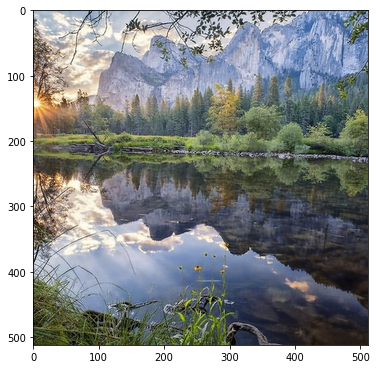

Проход 03501    Ошибка 0.000729
Проход 03502    Ошибка 0.000718
Проход 03503    Ошибка 0.000706
Проход 03504    Ошибка 0.000697
Проход 03505    Ошибка 0.000708
Проход 03506    Ошибка 0.000709
Проход 03507    Ошибка 0.000693
Проход 03508    Ошибка 0.000703
Проход 03509    Ошибка 0.000691
Проход 03510    Ошибка 0.000685
Проход 03511    Ошибка 0.000687
Проход 03512    Ошибка 0.000687
Проход 03513    Ошибка 0.000687
Проход 03514    Ошибка 0.000678
Проход 03515    Ошибка 0.000681
Проход 03516    Ошибка 0.000692
Проход 03517    Ошибка 0.000681
Проход 03518    Ошибка 0.000679
Проход 03519    Ошибка 0.000681
Проход 03520    Ошибка 0.000684
Проход 03521    Ошибка 0.000689
Проход 03522    Ошибка 0.000696
Проход 03523    Ошибка 0.000729
Проход 03524    Ошибка 0.000768
Проход 03525    Ошибка 0.000830
Проход 03526    Ошибка 0.000842
Проход 03527    Ошибка 0.000823
Проход 03528    Ошибка 0.000727
Проход 03529    Ошибка 0.000721
Проход 03530    Ошибка 0.000757
Проход 03531    Ошибка 0.000769
Проход 0

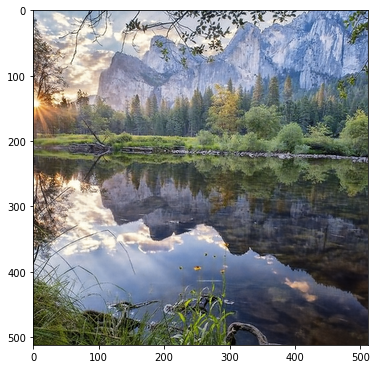

Проход 03551    Ошибка 0.000692
Проход 03552    Ошибка 0.000684
Проход 03553    Ошибка 0.000680
Проход 03554    Ошибка 0.000687
Проход 03555    Ошибка 0.000685
Проход 03556    Ошибка 0.000682
Проход 03557    Ошибка 0.000693
Проход 03558    Ошибка 0.000694
Проход 03559    Ошибка 0.000674
Проход 03560    Ошибка 0.000671
Проход 03561    Ошибка 0.000673
Проход 03562    Ошибка 0.000666
Проход 03563    Ошибка 0.000657
Проход 03564    Ошибка 0.000665
Проход 03565    Ошибка 0.000660
Проход 03566    Ошибка 0.000668
Проход 03567    Ошибка 0.000679
Проход 03568    Ошибка 0.000682
Проход 03569    Ошибка 0.000676
Проход 03570    Ошибка 0.000669
Проход 03571    Ошибка 0.000666
Проход 03572    Ошибка 0.000660
Проход 03573    Ошибка 0.000655
Проход 03574    Ошибка 0.000659
Проход 03575    Ошибка 0.000670
Проход 03576    Ошибка 0.000661
Проход 03577    Ошибка 0.000659
Проход 03578    Ошибка 0.000650
Проход 03579    Ошибка 0.000650
Проход 03580    Ошибка 0.000652
Проход 03581    Ошибка 0.000672
Проход 0

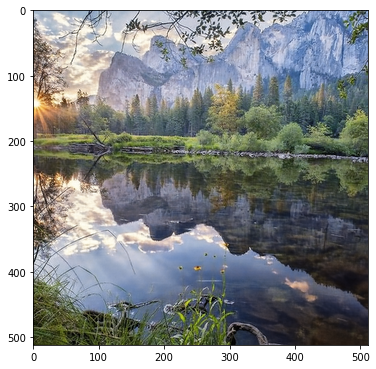

Проход 03601    Ошибка 0.000650
Проход 03602    Ошибка 0.000673
Проход 03603    Ошибка 0.000663
Проход 03604    Ошибка 0.000654
Проход 03605    Ошибка 0.000662
Проход 03606    Ошибка 0.000654
Проход 03607    Ошибка 0.000661
Проход 03608    Ошибка 0.000682
Проход 03609    Ошибка 0.000663
Проход 03610    Ошибка 0.000652
Проход 03611    Ошибка 0.000650
Проход 03612    Ошибка 0.000645
Проход 03613    Ошибка 0.000655
Проход 03614    Ошибка 0.000664
Проход 03615    Ошибка 0.000673
Проход 03616    Ошибка 0.000676
Проход 03617    Ошибка 0.000685
Проход 03618    Ошибка 0.000687
Проход 03619    Ошибка 0.000685
Проход 03620    Ошибка 0.000679
Проход 03621    Ошибка 0.000676
Проход 03622    Ошибка 0.000653
Проход 03623    Ошибка 0.000658
Проход 03624    Ошибка 0.000649
Проход 03625    Ошибка 0.000658
Проход 03626    Ошибка 0.000660
Проход 03627    Ошибка 0.000648
Проход 03628    Ошибка 0.000654
Проход 03629    Ошибка 0.000663
Проход 03630    Ошибка 0.000655
Проход 03631    Ошибка 0.000634
Проход 0

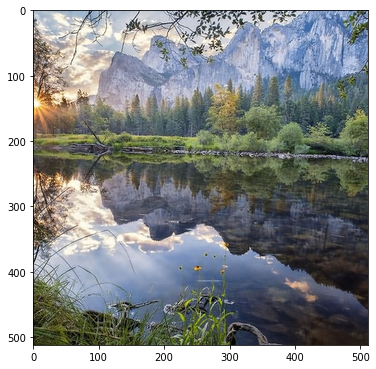

Проход 03651    Ошибка 0.000691
Проход 03652    Ошибка 0.000713
Проход 03653    Ошибка 0.000679
Проход 03654    Ошибка 0.000658
Проход 03655    Ошибка 0.000654
Проход 03656    Ошибка 0.000646
Проход 03657    Ошибка 0.000663
Проход 03658    Ошибка 0.000649
Проход 03659    Ошибка 0.000636
Проход 03660    Ошибка 0.000639
Проход 03661    Ошибка 0.000648
Проход 03662    Ошибка 0.000653
Проход 03663    Ошибка 0.000639
Проход 03664    Ошибка 0.000646
Проход 03665    Ошибка 0.000638
Проход 03666    Ошибка 0.000645
Проход 03667    Ошибка 0.000636
Проход 03668    Ошибка 0.000639
Проход 03669    Ошибка 0.000625
Проход 03670    Ошибка 0.000629
Проход 03671    Ошибка 0.000632
Проход 03672    Ошибка 0.000649
Проход 03673    Ошибка 0.000686
Проход 03674    Ошибка 0.000713
Проход 03675    Ошибка 0.000708
Проход 03676    Ошибка 0.000692
Проход 03677    Ошибка 0.000672
Проход 03678    Ошибка 0.000645
Проход 03679    Ошибка 0.000644
Проход 03680    Ошибка 0.000641
Проход 03681    Ошибка 0.000634
Проход 0

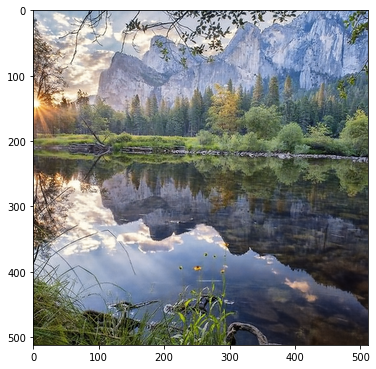

Проход 03701    Ошибка 0.000623
Проход 03702    Ошибка 0.000627
Проход 03703    Ошибка 0.000636
Проход 03704    Ошибка 0.000627
Проход 03705    Ошибка 0.000623
Проход 03706    Ошибка 0.000620
Проход 03707    Ошибка 0.000602
Проход 03708    Ошибка 0.000605
Проход 03709    Ошибка 0.000619
Проход 03710    Ошибка 0.000609
Проход 03711    Ошибка 0.000600
Проход 03712    Ошибка 0.000609
Проход 03713    Ошибка 0.000614
Проход 03714    Ошибка 0.000612
Проход 03715    Ошибка 0.000610
Проход 03716    Ошибка 0.000611
Проход 03717    Ошибка 0.000617
Проход 03718    Ошибка 0.000627
Проход 03719    Ошибка 0.000658
Проход 03720    Ошибка 0.000673
Проход 03721    Ошибка 0.000687
Проход 03722    Ошибка 0.000688
Проход 03723    Ошибка 0.000695
Проход 03724    Ошибка 0.000669
Проход 03725    Ошибка 0.000667
Проход 03726    Ошибка 0.000636
Проход 03727    Ошибка 0.000623
Проход 03728    Ошибка 0.000628
Проход 03729    Ошибка 0.000645
Проход 03730    Ошибка 0.000646
Проход 03731    Ошибка 0.000635
Проход 0

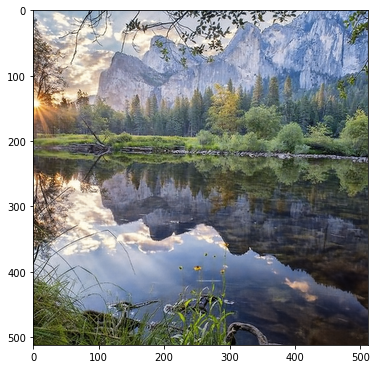

Проход 03751    Ошибка 0.000638
Проход 03752    Ошибка 0.000604
Проход 03753    Ошибка 0.000608
Проход 03754    Ошибка 0.000597
Проход 03755    Ошибка 0.000593
Проход 03756    Ошибка 0.000601
Проход 03757    Ошибка 0.000590
Проход 03758    Ошибка 0.000585
Проход 03759    Ошибка 0.000584
Проход 03760    Ошибка 0.000595
Проход 03761    Ошибка 0.000594
Проход 03762    Ошибка 0.000580
Проход 03763    Ошибка 0.000577
Проход 03764    Ошибка 0.000574
Проход 03765    Ошибка 0.000580
Проход 03766    Ошибка 0.000589
Проход 03767    Ошибка 0.000583
Проход 03768    Ошибка 0.000587
Проход 03769    Ошибка 0.000607
Проход 03770    Ошибка 0.000611
Проход 03771    Ошибка 0.000601
Проход 03772    Ошибка 0.000593
Проход 03773    Ошибка 0.000602
Проход 03774    Ошибка 0.000601
Проход 03775    Ошибка 0.000614
Проход 03776    Ошибка 0.000627
Проход 03777    Ошибка 0.000656
Проход 03778    Ошибка 0.000629
Проход 03779    Ошибка 0.000603
Проход 03780    Ошибка 0.000607
Проход 03781    Ошибка 0.000604
Проход 0

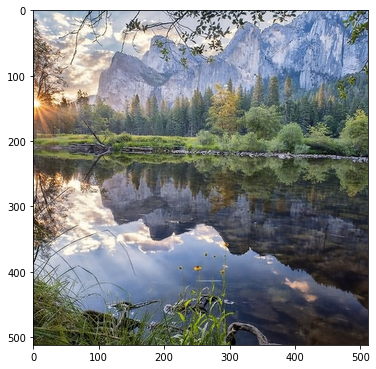

Проход 03801    Ошибка 0.000603
Проход 03802    Ошибка 0.000596
Проход 03803    Ошибка 0.000585
Проход 03804    Ошибка 0.000596
Проход 03805    Ошибка 0.000599
Проход 03806    Ошибка 0.000593
Проход 03807    Ошибка 0.000583
Проход 03808    Ошибка 0.000586
Проход 03809    Ошибка 0.000568
Проход 03810    Ошибка 0.000575
Проход 03811    Ошибка 0.000567
Проход 03812    Ошибка 0.000566
Проход 03813    Ошибка 0.000563
Проход 03814    Ошибка 0.000558
Проход 03815    Ошибка 0.000567
Проход 03816    Ошибка 0.000573
Проход 03817    Ошибка 0.000568
Проход 03818    Ошибка 0.000569
Проход 03819    Ошибка 0.000583
Проход 03820    Ошибка 0.000602
Проход 03821    Ошибка 0.000614
Проход 03822    Ошибка 0.000652
Проход 03823    Ошибка 0.000677
Проход 03824    Ошибка 0.000694
Проход 03825    Ошибка 0.000726
Проход 03826    Ошибка 0.000697
Проход 03827    Ошибка 0.000684
Проход 03828    Ошибка 0.000686
Проход 03829    Ошибка 0.000708
Проход 03830    Ошибка 0.000734
Проход 03831    Ошибка 0.000656
Проход 0

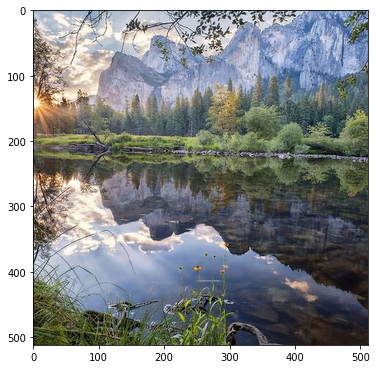

Проход 03851    Ошибка 0.000560
Проход 03852    Ошибка 0.000553
Проход 03853    Ошибка 0.000558
Проход 03854    Ошибка 0.000551
Проход 03855    Ошибка 0.000554
Проход 03856    Ошибка 0.000551
Проход 03857    Ошибка 0.000560
Проход 03858    Ошибка 0.000557
Проход 03859    Ошибка 0.000551
Проход 03860    Ошибка 0.000544
Проход 03861    Ошибка 0.000555
Проход 03862    Ошибка 0.000543
Проход 03863    Ошибка 0.000541
Проход 03864    Ошибка 0.000534
Проход 03865    Ошибка 0.000540
Проход 03866    Ошибка 0.000539
Проход 03867    Ошибка 0.000541
Проход 03868    Ошибка 0.000551
Проход 03869    Ошибка 0.000542
Проход 03870    Ошибка 0.000546
Проход 03871    Ошибка 0.000543
Проход 03872    Ошибка 0.000539
Проход 03873    Ошибка 0.000543
Проход 03874    Ошибка 0.000565
Проход 03875    Ошибка 0.000581
Проход 03876    Ошибка 0.000602
Проход 03877    Ошибка 0.000623
Проход 03878    Ошибка 0.000634
Проход 03879    Ошибка 0.000643
Проход 03880    Ошибка 0.000621
Проход 03881    Ошибка 0.000579
Проход 0

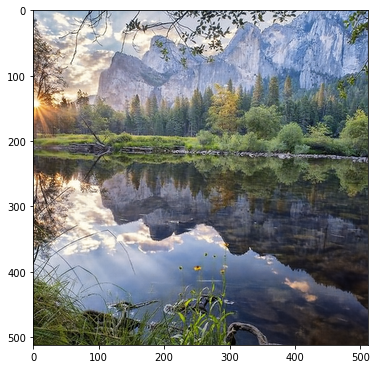

Проход 03901    Ошибка 0.000584
Проход 03902    Ошибка 0.000572
Проход 03903    Ошибка 0.000555
Проход 03904    Ошибка 0.000543
Проход 03905    Ошибка 0.000542
Проход 03906    Ошибка 0.000550
Проход 03907    Ошибка 0.000550
Проход 03908    Ошибка 0.000550
Проход 03909    Ошибка 0.000540
Проход 03910    Ошибка 0.000526
Проход 03911    Ошибка 0.000538
Проход 03912    Ошибка 0.000535
Проход 03913    Ошибка 0.000532
Проход 03914    Ошибка 0.000533
Проход 03915    Ошибка 0.000543
Проход 03916    Ошибка 0.000545
Проход 03917    Ошибка 0.000541
Проход 03918    Ошибка 0.000529
Проход 03919    Ошибка 0.000528
Проход 03920    Ошибка 0.000539
Проход 03921    Ошибка 0.000546
Проход 03922    Ошибка 0.000540
Проход 03923    Ошибка 0.000546
Проход 03924    Ошибка 0.000542
Проход 03925    Ошибка 0.000570
Проход 03926    Ошибка 0.000627
Проход 03927    Ошибка 0.000641
Проход 03928    Ошибка 0.000592
Проход 03929    Ошибка 0.000565
Проход 03930    Ошибка 0.000587
Проход 03931    Ошибка 0.000586
Проход 0

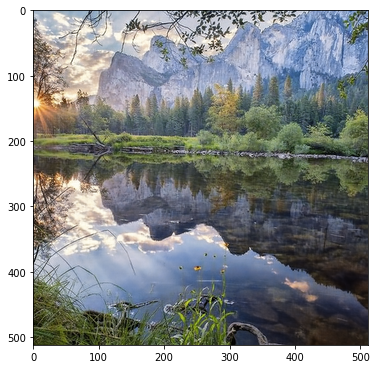

Проход 03951    Ошибка 0.000590
Проход 03952    Ошибка 0.000583
Проход 03953    Ошибка 0.000549
Проход 03954    Ошибка 0.000562
Проход 03955    Ошибка 0.000552
Проход 03956    Ошибка 0.000587
Проход 03957    Ошибка 0.000602
Проход 03958    Ошибка 0.000618
Проход 03959    Ошибка 0.000607
Проход 03960    Ошибка 0.000591
Проход 03961    Ошибка 0.000572
Проход 03962    Ошибка 0.000570
Проход 03963    Ошибка 0.000564
Проход 03964    Ошибка 0.000566
Проход 03965    Ошибка 0.000535
Проход 03966    Ошибка 0.000540
Проход 03967    Ошибка 0.000528
Проход 03968    Ошибка 0.000542
Проход 03969    Ошибка 0.000552
Проход 03970    Ошибка 0.000541
Проход 03971    Ошибка 0.000526
Проход 03972    Ошибка 0.000517
Проход 03973    Ошибка 0.000526
Проход 03974    Ошибка 0.000533
Проход 03975    Ошибка 0.000539
Проход 03976    Ошибка 0.000536
Проход 03977    Ошибка 0.000517
Проход 03978    Ошибка 0.000505
Проход 03979    Ошибка 0.000518
Проход 03980    Ошибка 0.000529
Проход 03981    Ошибка 0.000517
Проход 0

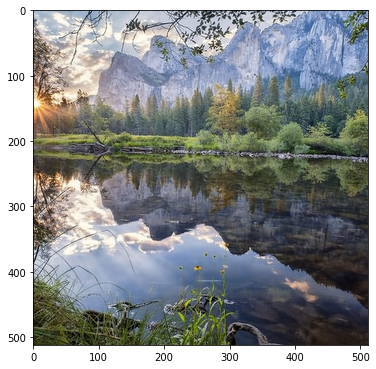

Проход 04001    Ошибка 0.000523
Проход 04002    Ошибка 0.000524
Проход 04003    Ошибка 0.000541
Проход 04004    Ошибка 0.000554
Проход 04005    Ошибка 0.000574
Проход 04006    Ошибка 0.000588
Проход 04007    Ошибка 0.000571
Проход 04008    Ошибка 0.000561
Проход 04009    Ошибка 0.000551
Проход 04010    Ошибка 0.000519
Проход 04011    Ошибка 0.000520
Проход 04012    Ошибка 0.000513
Проход 04013    Ошибка 0.000518
Проход 04014    Ошибка 0.000522
Проход 04015    Ошибка 0.000516
Проход 04016    Ошибка 0.000520
Проход 04017    Ошибка 0.000512
Проход 04018    Ошибка 0.000512
Проход 04019    Ошибка 0.000495
Проход 04020    Ошибка 0.000505
Проход 04021    Ошибка 0.000511
Проход 04022    Ошибка 0.000503
Проход 04023    Ошибка 0.000495
Проход 04024    Ошибка 0.000499
Проход 04025    Ошибка 0.000493
Проход 04026    Ошибка 0.000497
Проход 04027    Ошибка 0.000496
Проход 04028    Ошибка 0.000498
Проход 04029    Ошибка 0.000494
Проход 04030    Ошибка 0.000497
Проход 04031    Ошибка 0.000492
Проход 0

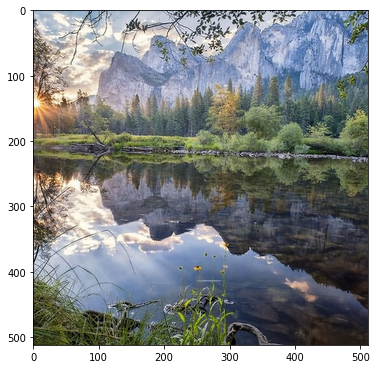

Проход 04051    Ошибка 0.000552
Проход 04052    Ошибка 0.000525
Проход 04053    Ошибка 0.000525
Проход 04054    Ошибка 0.000518
Проход 04055    Ошибка 0.000511
Проход 04056    Ошибка 0.000500
Проход 04057    Ошибка 0.000500
Проход 04058    Ошибка 0.000513
Проход 04059    Ошибка 0.000504
Проход 04060    Ошибка 0.000496
Проход 04061    Ошибка 0.000499
Проход 04062    Ошибка 0.000495
Проход 04063    Ошибка 0.000486
Проход 04064    Ошибка 0.000492
Проход 04065    Ошибка 0.000496
Проход 04066    Ошибка 0.000497
Проход 04067    Ошибка 0.000503
Проход 04068    Ошибка 0.000513
Проход 04069    Ошибка 0.000511
Проход 04070    Ошибка 0.000513
Проход 04071    Ошибка 0.000496
Проход 04072    Ошибка 0.000492
Проход 04073    Ошибка 0.000493
Проход 04074    Ошибка 0.000480
Проход 04075    Ошибка 0.000481
Проход 04076    Ошибка 0.000487
Проход 04077    Ошибка 0.000490
Проход 04078    Ошибка 0.000501
Проход 04079    Ошибка 0.000494
Проход 04080    Ошибка 0.000489
Проход 04081    Ошибка 0.000476
Проход 0

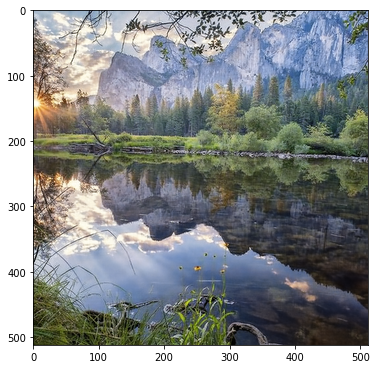

Проход 04101    Ошибка 0.000513
Проход 04102    Ошибка 0.000497
Проход 04103    Ошибка 0.000487
Проход 04104    Ошибка 0.000486
Проход 04105    Ошибка 0.000489
Проход 04106    Ошибка 0.000496
Проход 04107    Ошибка 0.000491
Проход 04108    Ошибка 0.000489
Проход 04109    Ошибка 0.000475
Проход 04110    Ошибка 0.000471
Проход 04111    Ошибка 0.000485
Проход 04112    Ошибка 0.000488
Проход 04113    Ошибка 0.000501
Проход 04114    Ошибка 0.000505
Проход 04115    Ошибка 0.000488
Проход 04116    Ошибка 0.000464
Проход 04117    Ошибка 0.000470
Проход 04118    Ошибка 0.000484
Проход 04119    Ошибка 0.000484
Проход 04120    Ошибка 0.000468
Проход 04121    Ошибка 0.000469
Проход 04122    Ошибка 0.000490
Проход 04123    Ошибка 0.000519
Проход 04124    Ошибка 0.000566
Проход 04125    Ошибка 0.000644
Проход 04126    Ошибка 0.000689
Проход 04127    Ошибка 0.000699
Проход 04128    Ошибка 0.000638
Проход 04129    Ошибка 0.000576
Проход 04130    Ошибка 0.000568
Проход 04131    Ошибка 0.000618
Проход 0

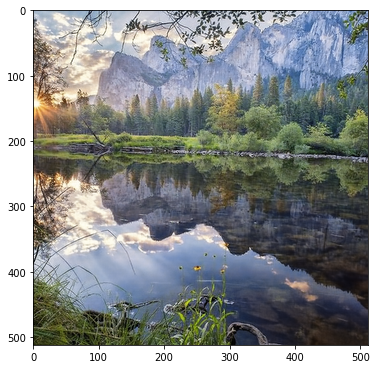

Проход 04151    Ошибка 0.000483
Проход 04152    Ошибка 0.000491
Проход 04153    Ошибка 0.000480
Проход 04154    Ошибка 0.000474
Проход 04155    Ошибка 0.000473
Проход 04156    Ошибка 0.000475
Проход 04157    Ошибка 0.000463
Проход 04158    Ошибка 0.000460
Проход 04159    Ошибка 0.000462
Проход 04160    Ошибка 0.000460
Проход 04161    Ошибка 0.000462
Проход 04162    Ошибка 0.000458
Проход 04163    Ошибка 0.000457
Проход 04164    Ошибка 0.000474
Проход 04165    Ошибка 0.000469
Проход 04166    Ошибка 0.000475
Проход 04167    Ошибка 0.000479
Проход 04168    Ошибка 0.000472
Проход 04169    Ошибка 0.000458
Проход 04170    Ошибка 0.000449
Проход 04171    Ошибка 0.000448
Проход 04172    Ошибка 0.000459
Проход 04173    Ошибка 0.000470
Проход 04174    Ошибка 0.000468
Проход 04175    Ошибка 0.000461
Проход 04176    Ошибка 0.000458
Проход 04177    Ошибка 0.000450
Проход 04178    Ошибка 0.000445
Проход 04179    Ошибка 0.000442
Проход 04180    Ошибка 0.000448
Проход 04181    Ошибка 0.000459
Проход 0

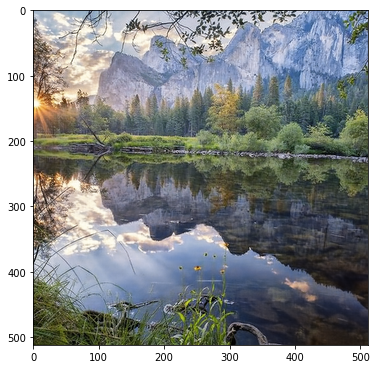

Проход 04201    Ошибка 0.000463
Проход 04202    Ошибка 0.000460
Проход 04203    Ошибка 0.000463
Проход 04204    Ошибка 0.000472
Проход 04205    Ошибка 0.000471
Проход 04206    Ошибка 0.000475
Проход 04207    Ошибка 0.000510
Проход 04208    Ошибка 0.000523
Проход 04209    Ошибка 0.000556
Проход 04210    Ошибка 0.000536
Проход 04211    Ошибка 0.000503
Проход 04212    Ошибка 0.000488
Проход 04213    Ошибка 0.000518
Проход 04214    Ошибка 0.000529
Проход 04215    Ошибка 0.000533
Проход 04216    Ошибка 0.000513
Проход 04217    Ошибка 0.000488
Проход 04218    Ошибка 0.000498
Проход 04219    Ошибка 0.000507
Проход 04220    Ошибка 0.000491
Проход 04221    Ошибка 0.000475
Проход 04222    Ошибка 0.000491
Проход 04223    Ошибка 0.000474
Проход 04224    Ошибка 0.000476
Проход 04225    Ошибка 0.000469
Проход 04226    Ошибка 0.000460
Проход 04227    Ошибка 0.000469
Проход 04228    Ошибка 0.000470
Проход 04229    Ошибка 0.000461
Проход 04230    Ошибка 0.000460
Проход 04231    Ошибка 0.000455
Проход 0

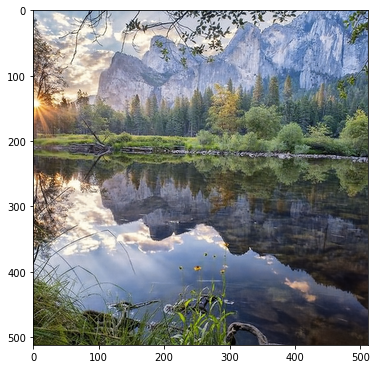

Проход 04251    Ошибка 0.000425
Проход 04252    Ошибка 0.000422
Проход 04253    Ошибка 0.000420
Проход 04254    Ошибка 0.000424
Проход 04255    Ошибка 0.000424
Проход 04256    Ошибка 0.000432
Проход 04257    Ошибка 0.000440
Проход 04258    Ошибка 0.000448
Проход 04259    Ошибка 0.000501
Проход 04260    Ошибка 0.000610
Проход 04261    Ошибка 0.000774
Проход 04262    Ошибка 0.000921
Проход 04263    Ошибка 0.000828
Проход 04264    Ошибка 0.000620
Проход 04265    Ошибка 0.000597
Проход 04266    Ошибка 0.000658
Проход 04267    Ошибка 0.000613
Проход 04268    Ошибка 0.000580
Проход 04269    Ошибка 0.000614
Проход 04270    Ошибка 0.000579
Проход 04271    Ошибка 0.000602
Проход 04272    Ошибка 0.000637
Проход 04273    Ошибка 0.000681
Проход 04274    Ошибка 0.000627
Проход 04275    Ошибка 0.000622
Проход 04276    Ошибка 0.000597
Проход 04277    Ошибка 0.000545
Проход 04278    Ошибка 0.000539
Проход 04279    Ошибка 0.000554
Проход 04280    Ошибка 0.000544
Проход 04281    Ошибка 0.000514
Проход 0

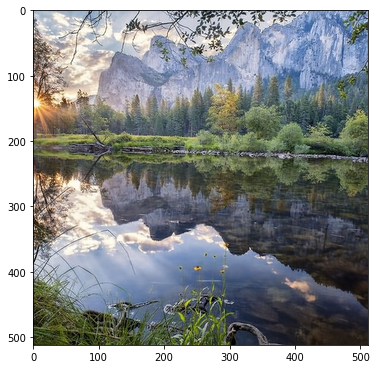

Проход 04301    Ошибка 0.000433
Проход 04302    Ошибка 0.000442
Проход 04303    Ошибка 0.000425
Проход 04304    Ошибка 0.000422
Проход 04305    Ошибка 0.000425
Проход 04306    Ошибка 0.000425
Проход 04307    Ошибка 0.000427
Проход 04308    Ошибка 0.000439
Проход 04309    Ошибка 0.000431
Проход 04310    Ошибка 0.000427
Проход 04311    Ошибка 0.000422
Проход 04312    Ошибка 0.000426
Проход 04313    Ошибка 0.000423
Проход 04314    Ошибка 0.000417
Проход 04315    Ошибка 0.000428
Проход 04316    Ошибка 0.000420
Проход 04317    Ошибка 0.000408
Проход 04318    Ошибка 0.000412
Проход 04319    Ошибка 0.000421
Проход 04320    Ошибка 0.000413
Проход 04321    Ошибка 0.000416
Проход 04322    Ошибка 0.000415
Проход 04323    Ошибка 0.000413
Проход 04324    Ошибка 0.000408
Проход 04325    Ошибка 0.000406
Проход 04326    Ошибка 0.000410
Проход 04327    Ошибка 0.000407
Проход 04328    Ошибка 0.000409
Проход 04329    Ошибка 0.000417
Проход 04330    Ошибка 0.000421
Проход 04331    Ошибка 0.000420
Проход 0

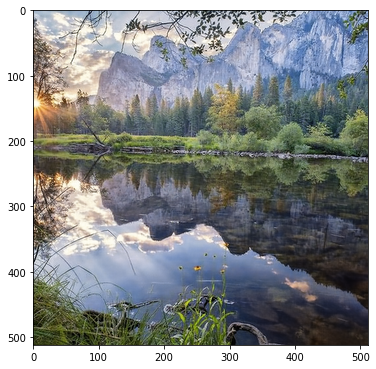

Проход 04351    Ошибка 0.000402
Проход 04352    Ошибка 0.000404
Проход 04353    Ошибка 0.000394
Проход 04354    Ошибка 0.000395
Проход 04355    Ошибка 0.000400
Проход 04356    Ошибка 0.000397
Проход 04357    Ошибка 0.000396
Проход 04358    Ошибка 0.000388
Проход 04359    Ошибка 0.000400
Проход 04360    Ошибка 0.000409
Проход 04361    Ошибка 0.000410
Проход 04362    Ошибка 0.000415
Проход 04363    Ошибка 0.000409
Проход 04364    Ошибка 0.000410
Проход 04365    Ошибка 0.000416
Проход 04366    Ошибка 0.000418
Проход 04367    Ошибка 0.000413
Проход 04368    Ошибка 0.000409
Проход 04369    Ошибка 0.000405
Проход 04370    Ошибка 0.000404
Проход 04371    Ошибка 0.000404
Проход 04372    Ошибка 0.000398
Проход 04373    Ошибка 0.000408
Проход 04374    Ошибка 0.000418
Проход 04375    Ошибка 0.000425
Проход 04376    Ошибка 0.000434
Проход 04377    Ошибка 0.000446
Проход 04378    Ошибка 0.000454
Проход 04379    Ошибка 0.000447
Проход 04380    Ошибка 0.000447
Проход 04381    Ошибка 0.000435
Проход 0

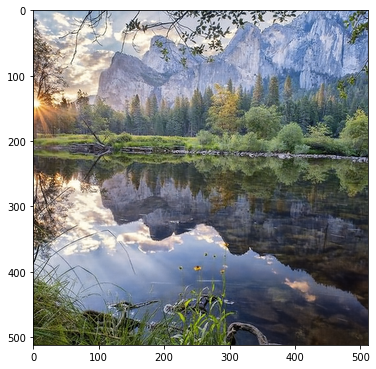

Проход 04401    Ошибка 0.000400
Проход 04402    Ошибка 0.000404
Проход 04403    Ошибка 0.000403
Проход 04404    Ошибка 0.000417
Проход 04405    Ошибка 0.000436
Проход 04406    Ошибка 0.000439
Проход 04407    Ошибка 0.000441
Проход 04408    Ошибка 0.000446
Проход 04409    Ошибка 0.000445
Проход 04410    Ошибка 0.000428
Проход 04411    Ошибка 0.000421
Проход 04412    Ошибка 0.000424
Проход 04413    Ошибка 0.000417
Проход 04414    Ошибка 0.000416
Проход 04415    Ошибка 0.000404
Проход 04416    Ошибка 0.000408
Проход 04417    Ошибка 0.000426
Проход 04418    Ошибка 0.000425
Проход 04419    Ошибка 0.000405
Проход 04420    Ошибка 0.000403
Проход 04421    Ошибка 0.000422
Проход 04422    Ошибка 0.000447
Проход 04423    Ошибка 0.000426
Проход 04424    Ошибка 0.000419
Проход 04425    Ошибка 0.000417
Проход 04426    Ошибка 0.000434
Проход 04427    Ошибка 0.000415
Проход 04428    Ошибка 0.000394
Проход 04429    Ошибка 0.000401
Проход 04430    Ошибка 0.000422
Проход 04431    Ошибка 0.000418
Проход 0

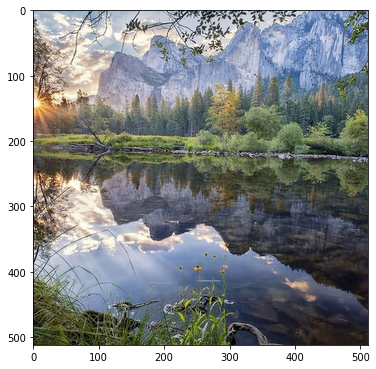

Проход 04451    Ошибка 0.000397
Проход 04452    Ошибка 0.000399
Проход 04453    Ошибка 0.000396
Проход 04454    Ошибка 0.000414
Проход 04455    Ошибка 0.000423
Проход 04456    Ошибка 0.000420
Проход 04457    Ошибка 0.000413
Проход 04458    Ошибка 0.000415
Проход 04459    Ошибка 0.000416
Проход 04460    Ошибка 0.000409
Проход 04461    Ошибка 0.000404
Проход 04462    Ошибка 0.000418
Проход 04463    Ошибка 0.000428
Проход 04464    Ошибка 0.000447
Проход 04465    Ошибка 0.000445
Проход 04466    Ошибка 0.000419
Проход 04467    Ошибка 0.000395
Проход 04468    Ошибка 0.000391
Проход 04469    Ошибка 0.000392
Проход 04470    Ошибка 0.000409
Проход 04471    Ошибка 0.000396
Проход 04472    Ошибка 0.000384
Проход 04473    Ошибка 0.000389
Проход 04474    Ошибка 0.000385
Проход 04475    Ошибка 0.000387
Проход 04476    Ошибка 0.000390
Проход 04477    Ошибка 0.000390
Проход 04478    Ошибка 0.000399
Проход 04479    Ошибка 0.000404
Проход 04480    Ошибка 0.000412
Проход 04481    Ошибка 0.000424
Проход 0

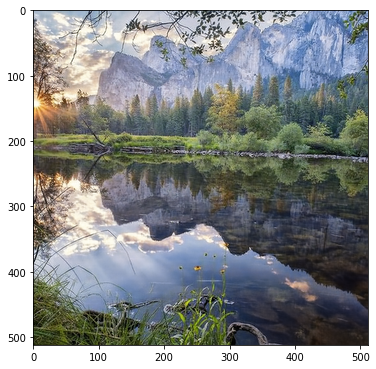

Проход 04501    Ошибка 0.000412
Проход 04502    Ошибка 0.000435
Проход 04503    Ошибка 0.000456
Проход 04504    Ошибка 0.000471
Проход 04505    Ошибка 0.000486
Проход 04506    Ошибка 0.000479
Проход 04507    Ошибка 0.000428
Проход 04508    Ошибка 0.000413
Проход 04509    Ошибка 0.000421
Проход 04510    Ошибка 0.000440
Проход 04511    Ошибка 0.000436
Проход 04512    Ошибка 0.000410
Проход 04513    Ошибка 0.000395
Проход 04514    Ошибка 0.000397
Проход 04515    Ошибка 0.000392
Проход 04516    Ошибка 0.000397
Проход 04517    Ошибка 0.000394
Проход 04518    Ошибка 0.000383
Проход 04519    Ошибка 0.000382
Проход 04520    Ошибка 0.000382
Проход 04521    Ошибка 0.000382
Проход 04522    Ошибка 0.000386
Проход 04523    Ошибка 0.000379
Проход 04524    Ошибка 0.000379
Проход 04525    Ошибка 0.000375
Проход 04526    Ошибка 0.000370
Проход 04527    Ошибка 0.000374
Проход 04528    Ошибка 0.000378
Проход 04529    Ошибка 0.000386
Проход 04530    Ошибка 0.000381
Проход 04531    Ошибка 0.000370
Проход 0

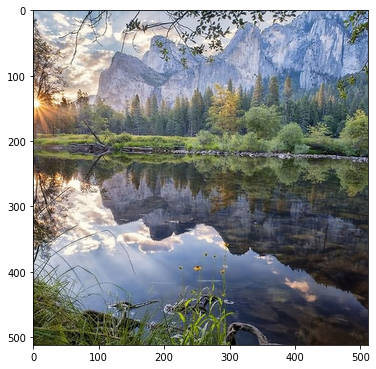

Проход 04551    Ошибка 0.000378
Проход 04552    Ошибка 0.000381
Проход 04553    Ошибка 0.000379
Проход 04554    Ошибка 0.000379
Проход 04555    Ошибка 0.000377
Проход 04556    Ошибка 0.000378
Проход 04557    Ошибка 0.000391
Проход 04558    Ошибка 0.000391
Проход 04559    Ошибка 0.000388
Проход 04560    Ошибка 0.000381
Проход 04561    Ошибка 0.000377
Проход 04562    Ошибка 0.000378
Проход 04563    Ошибка 0.000371
Проход 04564    Ошибка 0.000363
Проход 04565    Ошибка 0.000363
Проход 04566    Ошибка 0.000368
Проход 04567    Ошибка 0.000379
Проход 04568    Ошибка 0.000385
Проход 04569    Ошибка 0.000387
Проход 04570    Ошибка 0.000372
Проход 04571    Ошибка 0.000365
Проход 04572    Ошибка 0.000362
Проход 04573    Ошибка 0.000365
Проход 04574    Ошибка 0.000372
Проход 04575    Ошибка 0.000377
Проход 04576    Ошибка 0.000379
Проход 04577    Ошибка 0.000372
Проход 04578    Ошибка 0.000369
Проход 04579    Ошибка 0.000367
Проход 04580    Ошибка 0.000373
Проход 04581    Ошибка 0.000376
Проход 0

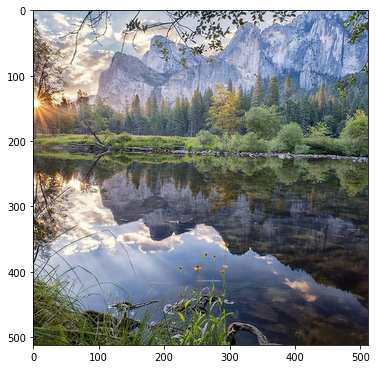

Проход 04601    Ошибка 0.000376
Проход 04602    Ошибка 0.000398
Проход 04603    Ошибка 0.000370
Проход 04604    Ошибка 0.000358
Проход 04605    Ошибка 0.000370
Проход 04606    Ошибка 0.000371
Проход 04607    Ошибка 0.000362
Проход 04608    Ошибка 0.000379
Проход 04609    Ошибка 0.000377
Проход 04610    Ошибка 0.000351
Проход 04611    Ошибка 0.000355
Проход 04612    Ошибка 0.000355
Проход 04613    Ошибка 0.000358
Проход 04614    Ошибка 0.000367
Проход 04615    Ошибка 0.000377
Проход 04616    Ошибка 0.000371
Проход 04617    Ошибка 0.000368
Проход 04618    Ошибка 0.000375
Проход 04619    Ошибка 0.000364
Проход 04620    Ошибка 0.000347
Проход 04621    Ошибка 0.000351
Проход 04622    Ошибка 0.000360
Проход 04623    Ошибка 0.000375
Проход 04624    Ошибка 0.000385
Проход 04625    Ошибка 0.000376
Проход 04626    Ошибка 0.000363
Проход 04627    Ошибка 0.000358
Проход 04628    Ошибка 0.000358
Проход 04629    Ошибка 0.000363
Проход 04630    Ошибка 0.000374
Проход 04631    Ошибка 0.000371
Проход 0

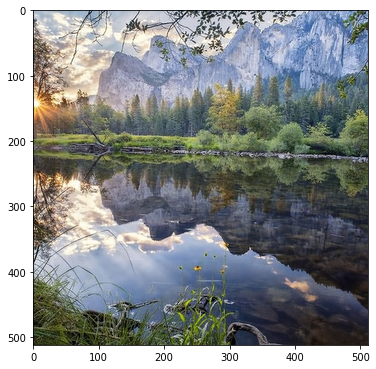

Проход 04651    Ошибка 0.000451
Проход 04652    Ошибка 0.000464
Проход 04653    Ошибка 0.000410
Проход 04654    Ошибка 0.000396
Проход 04655    Ошибка 0.000381
Проход 04656    Ошибка 0.000391
Проход 04657    Ошибка 0.000423
Проход 04658    Ошибка 0.000407
Проход 04659    Ошибка 0.000423
Проход 04660    Ошибка 0.000381
Проход 04661    Ошибка 0.000383
Проход 04662    Ошибка 0.000410
Проход 04663    Ошибка 0.000420
Проход 04664    Ошибка 0.000429
Проход 04665    Ошибка 0.000399
Проход 04666    Ошибка 0.000396
Проход 04667    Ошибка 0.000412
Проход 04668    Ошибка 0.000419
Проход 04669    Ошибка 0.000397
Проход 04670    Ошибка 0.000372
Проход 04671    Ошибка 0.000372
Проход 04672    Ошибка 0.000391
Проход 04673    Ошибка 0.000377
Проход 04674    Ошибка 0.000359
Проход 04675    Ошибка 0.000364
Проход 04676    Ошибка 0.000356
Проход 04677    Ошибка 0.000360
Проход 04678    Ошибка 0.000346
Проход 04679    Ошибка 0.000351
Проход 04680    Ошибка 0.000347
Проход 04681    Ошибка 0.000347
Проход 0

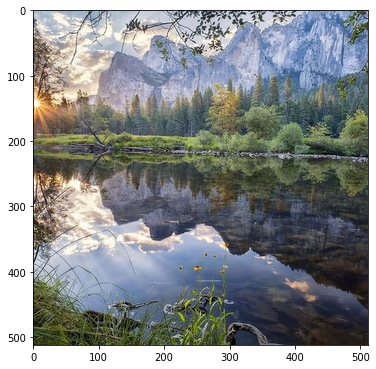

Проход 04701    Ошибка 0.000365
Проход 04702    Ошибка 0.000367
Проход 04703    Ошибка 0.000355
Проход 04704    Ошибка 0.000353
Проход 04705    Ошибка 0.000345
Проход 04706    Ошибка 0.000331
Проход 04707    Ошибка 0.000332
Проход 04708    Ошибка 0.000340
Проход 04709    Ошибка 0.000351
Проход 04710    Ошибка 0.000351
Проход 04711    Ошибка 0.000348
Проход 04712    Ошибка 0.000343
Проход 04713    Ошибка 0.000335
Проход 04714    Ошибка 0.000334
Проход 04715    Ошибка 0.000344
Проход 04716    Ошибка 0.000345
Проход 04717    Ошибка 0.000343
Проход 04718    Ошибка 0.000344
Проход 04719    Ошибка 0.000340
Проход 04720    Ошибка 0.000345
Проход 04721    Ошибка 0.000358
Проход 04722    Ошибка 0.000356
Проход 04723    Ошибка 0.000349
Проход 04724    Ошибка 0.000342
Проход 04725    Ошибка 0.000345
Проход 04726    Ошибка 0.000357
Проход 04727    Ошибка 0.000377
Проход 04728    Ошибка 0.000401
Проход 04729    Ошибка 0.000405
Проход 04730    Ошибка 0.000399
Проход 04731    Ошибка 0.000406
Проход 0

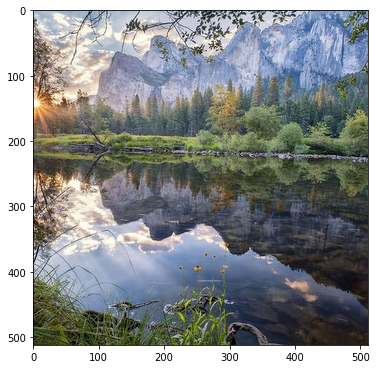

Проход 04751    Ошибка 0.000343
Проход 04752    Ошибка 0.000334
Проход 04753    Ошибка 0.000331
Проход 04754    Ошибка 0.000345
Проход 04755    Ошибка 0.000354
Проход 04756    Ошибка 0.000365
Проход 04757    Ошибка 0.000369
Проход 04758    Ошибка 0.000346
Проход 04759    Ошибка 0.000336
Проход 04760    Ошибка 0.000350
Проход 04761    Ошибка 0.000352
Проход 04762    Ошибка 0.000347
Проход 04763    Ошибка 0.000344
Проход 04764    Ошибка 0.000345
Проход 04765    Ошибка 0.000351
Проход 04766    Ошибка 0.000360
Проход 04767    Ошибка 0.000364
Проход 04768    Ошибка 0.000361
Проход 04769    Ошибка 0.000365
Проход 04770    Ошибка 0.000367
Проход 04771    Ошибка 0.000347
Проход 04772    Ошибка 0.000344
Проход 04773    Ошибка 0.000323
Проход 04774    Ошибка 0.000327
Проход 04775    Ошибка 0.000343
Проход 04776    Ошибка 0.000351
Проход 04777    Ошибка 0.000357
Проход 04778    Ошибка 0.000354
Проход 04779    Ошибка 0.000353
Проход 04780    Ошибка 0.000342
Проход 04781    Ошибка 0.000336
Проход 0

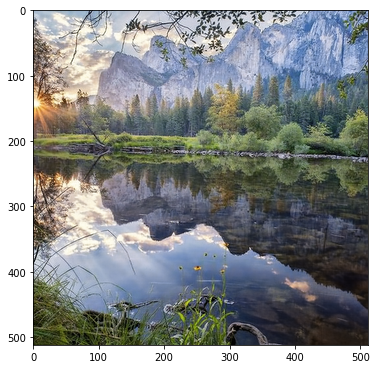

Проход 04801    Ошибка 0.000357
Проход 04802    Ошибка 0.000360
Проход 04803    Ошибка 0.000384
Проход 04804    Ошибка 0.000381
Проход 04805    Ошибка 0.000381
Проход 04806    Ошибка 0.000377
Проход 04807    Ошибка 0.000349
Проход 04808    Ошибка 0.000366
Проход 04809    Ошибка 0.000379
Проход 04810    Ошибка 0.000387
Проход 04811    Ошибка 0.000388
Проход 04812    Ошибка 0.000384
Проход 04813    Ошибка 0.000367
Проход 04814    Ошибка 0.000367
Проход 04815    Ошибка 0.000360
Проход 04816    Ошибка 0.000350
Проход 04817    Ошибка 0.000355
Проход 04818    Ошибка 0.000343
Проход 04819    Ошибка 0.000345
Проход 04820    Ошибка 0.000341
Проход 04821    Ошибка 0.000334
Проход 04822    Ошибка 0.000329
Проход 04823    Ошибка 0.000337
Проход 04824    Ошибка 0.000335
Проход 04825    Ошибка 0.000343
Проход 04826    Ошибка 0.000336
Проход 04827    Ошибка 0.000329
Проход 04828    Ошибка 0.000327
Проход 04829    Ошибка 0.000322
Проход 04830    Ошибка 0.000324
Проход 04831    Ошибка 0.000329
Проход 0

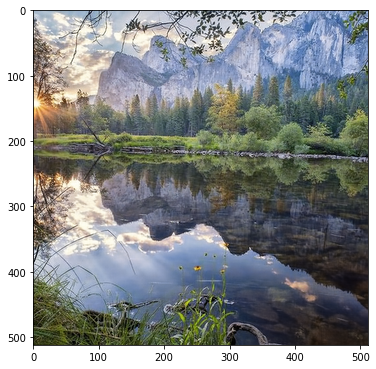

Проход 04851    Ошибка 0.000327
Проход 04852    Ошибка 0.000326
Проход 04853    Ошибка 0.000335
Проход 04854    Ошибка 0.000341
Проход 04855    Ошибка 0.000338
Проход 04856    Ошибка 0.000330
Проход 04857    Ошибка 0.000324
Проход 04858    Ошибка 0.000315
Проход 04859    Ошибка 0.000328
Проход 04860    Ошибка 0.000339
Проход 04861    Ошибка 0.000347
Проход 04862    Ошибка 0.000343
Проход 04863    Ошибка 0.000339
Проход 04864    Ошибка 0.000330
Проход 04865    Ошибка 0.000315
Проход 04866    Ошибка 0.000311
Проход 04867    Ошибка 0.000314
Проход 04868    Ошибка 0.000322
Проход 04869    Ошибка 0.000322
Проход 04870    Ошибка 0.000319
Проход 04871    Ошибка 0.000329
Проход 04872    Ошибка 0.000352
Проход 04873    Ошибка 0.000375
Проход 04874    Ошибка 0.000374
Проход 04875    Ошибка 0.000347
Проход 04876    Ошибка 0.000317
Проход 04877    Ошибка 0.000316
Проход 04878    Ошибка 0.000344
Проход 04879    Ошибка 0.000373
Проход 04880    Ошибка 0.000388
Проход 04881    Ошибка 0.000381
Проход 0

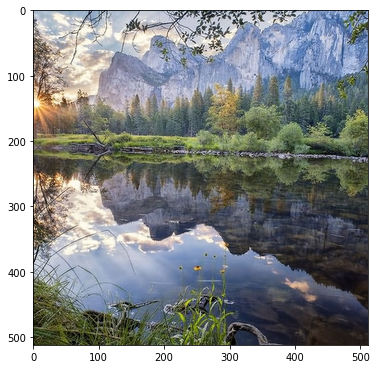

Проход 04901    Ошибка 0.000344
Проход 04902    Ошибка 0.000356
Проход 04903    Ошибка 0.000357
Проход 04904    Ошибка 0.000357
Проход 04905    Ошибка 0.000357
Проход 04906    Ошибка 0.000347
Проход 04907    Ошибка 0.000338
Проход 04908    Ошибка 0.000325
Проход 04909    Ошибка 0.000311
Проход 04910    Ошибка 0.000323
Проход 04911    Ошибка 0.000321
Проход 04912    Ошибка 0.000324
Проход 04913    Ошибка 0.000317
Проход 04914    Ошибка 0.000319
Проход 04915    Ошибка 0.000312
Проход 04916    Ошибка 0.000305
Проход 04917    Ошибка 0.000303
Проход 04918    Ошибка 0.000305
Проход 04919    Ошибка 0.000302
Проход 04920    Ошибка 0.000300
Проход 04921    Ошибка 0.000303
Проход 04922    Ошибка 0.000298
Проход 04923    Ошибка 0.000293
Проход 04924    Ошибка 0.000293
Проход 04925    Ошибка 0.000294
Проход 04926    Ошибка 0.000297
Проход 04927    Ошибка 0.000302
Проход 04928    Ошибка 0.000300
Проход 04929    Ошибка 0.000303
Проход 04930    Ошибка 0.000306
Проход 04931    Ошибка 0.000299
Проход 0

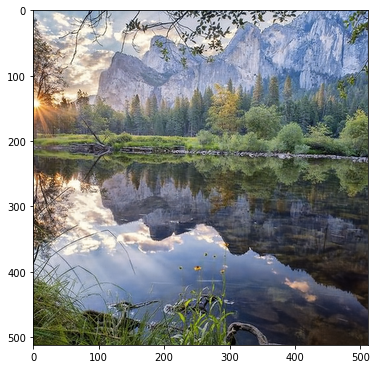

Проход 04951    Ошибка 0.000440
Проход 04952    Ошибка 0.000438
Проход 04953    Ошибка 0.000397
Проход 04954    Ошибка 0.000380
Проход 04955    Ошибка 0.000385
Проход 04956    Ошибка 0.000375
Проход 04957    Ошибка 0.000349
Проход 04958    Ошибка 0.000362
Проход 04959    Ошибка 0.000360
Проход 04960    Ошибка 0.000369
Проход 04961    Ошибка 0.000367
Проход 04962    Ошибка 0.000362
Проход 04963    Ошибка 0.000357
Проход 04964    Ошибка 0.000346
Проход 04965    Ошибка 0.000336
Проход 04966    Ошибка 0.000332
Проход 04967    Ошибка 0.000332
Проход 04968    Ошибка 0.000330
Проход 04969    Ошибка 0.000345
Проход 04970    Ошибка 0.000341
Проход 04971    Ошибка 0.000335
Проход 04972    Ошибка 0.000324
Проход 04973    Ошибка 0.000322
Проход 04974    Ошибка 0.000314
Проход 04975    Ошибка 0.000310
Проход 04976    Ошибка 0.000301
Проход 04977    Ошибка 0.000311
Проход 04978    Ошибка 0.000299
Проход 04979    Ошибка 0.000299
Проход 04980    Ошибка 0.000304
Проход 04981    Ошибка 0.000303
Проход 0

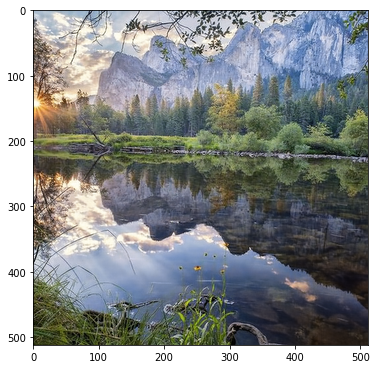

Проход 05001    Ошибка 0.000315
Проход 05002    Ошибка 0.000308
Проход 05003    Ошибка 0.000301
Проход 05004    Ошибка 0.000304
Проход 05005    Ошибка 0.000305
Проход 05006    Ошибка 0.000299
Проход 05007    Ошибка 0.000297
Проход 05008    Ошибка 0.000295
Проход 05009    Ошибка 0.000315
Проход 05010    Ошибка 0.000329
Проход 05011    Ошибка 0.000339
Проход 05012    Ошибка 0.000341
Проход 05013    Ошибка 0.000347
Проход 05014    Ошибка 0.000352
Проход 05015    Ошибка 0.000342
Проход 05016    Ошибка 0.000319
Проход 05017    Ошибка 0.000301
Проход 05018    Ошибка 0.000313
Проход 05019    Ошибка 0.000338
Проход 05020    Ошибка 0.000329
Проход 05021    Ошибка 0.000315
Проход 05022    Ошибка 0.000319
Проход 05023    Ошибка 0.000308
Проход 05024    Ошибка 0.000292
Проход 05025    Ошибка 0.000301
Проход 05026    Ошибка 0.000316
Проход 05027    Ошибка 0.000320
Проход 05028    Ошибка 0.000309
Проход 05029    Ошибка 0.000306
Проход 05030    Ошибка 0.000302
Проход 05031    Ошибка 0.000296
Проход 0

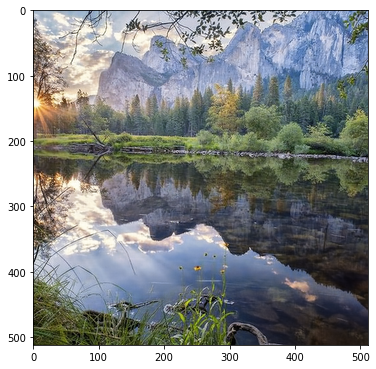

Проход 05051    Ошибка 0.000291
Проход 05052    Ошибка 0.000294
Проход 05053    Ошибка 0.000293
Проход 05054    Ошибка 0.000285
Проход 05055    Ошибка 0.000279
Проход 05056    Ошибка 0.000285
Проход 05057    Ошибка 0.000291
Проход 05058    Ошибка 0.000295
Проход 05059    Ошибка 0.000290
Проход 05060    Ошибка 0.000286
Проход 05061    Ошибка 0.000292
Проход 05062    Ошибка 0.000306
Проход 05063    Ошибка 0.000330
Проход 05064    Ошибка 0.000343
Проход 05065    Ошибка 0.000340
Проход 05066    Ошибка 0.000324
Проход 05067    Ошибка 0.000317
Проход 05068    Ошибка 0.000321
Проход 05069    Ошибка 0.000335
Проход 05070    Ошибка 0.000349
Проход 05071    Ошибка 0.000381
Проход 05072    Ошибка 0.000398
Проход 05073    Ошибка 0.000391
Проход 05074    Ошибка 0.000365
Проход 05075    Ошибка 0.000360
Проход 05076    Ошибка 0.000363
Проход 05077    Ошибка 0.000360
Проход 05078    Ошибка 0.000346
Проход 05079    Ошибка 0.000339
Проход 05080    Ошибка 0.000326
Проход 05081    Ошибка 0.000322
Проход 0

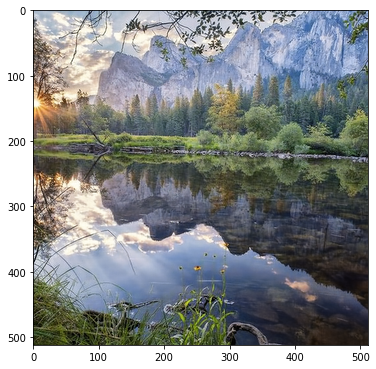

Проход 05101    Ошибка 0.000293
Проход 05102    Ошибка 0.000296
Проход 05103    Ошибка 0.000294
Проход 05104    Ошибка 0.000295
Проход 05105    Ошибка 0.000296
Проход 05106    Ошибка 0.000295
Проход 05107    Ошибка 0.000279
Проход 05108    Ошибка 0.000281
Проход 05109    Ошибка 0.000285
Проход 05110    Ошибка 0.000288
Проход 05111    Ошибка 0.000290
Проход 05112    Ошибка 0.000292
Проход 05113    Ошибка 0.000295
Проход 05114    Ошибка 0.000299
Проход 05115    Ошибка 0.000308
Проход 05116    Ошибка 0.000306
Проход 05117    Ошибка 0.000291
Проход 05118    Ошибка 0.000280
Проход 05119    Ошибка 0.000270
Проход 05120    Ошибка 0.000278
Проход 05121    Ошибка 0.000288
Проход 05122    Ошибка 0.000290
Проход 05123    Ошибка 0.000289
Проход 05124    Ошибка 0.000281
Проход 05125    Ошибка 0.000283
Проход 05126    Ошибка 0.000284
Проход 05127    Ошибка 0.000276
Проход 05128    Ошибка 0.000282
Проход 05129    Ошибка 0.000293
Проход 05130    Ошибка 0.000301
Проход 05131    Ошибка 0.000308
Проход 0

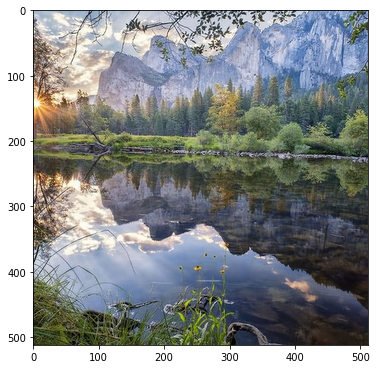

Проход 05151    Ошибка 0.000281
Проход 05152    Ошибка 0.000285
Проход 05153    Ошибка 0.000275
Проход 05154    Ошибка 0.000278
Проход 05155    Ошибка 0.000266
Проход 05156    Ошибка 0.000273
Проход 05157    Ошибка 0.000273
Проход 05158    Ошибка 0.000269
Проход 05159    Ошибка 0.000278
Проход 05160    Ошибка 0.000273
Проход 05161    Ошибка 0.000267
Проход 05162    Ошибка 0.000277
Проход 05163    Ошибка 0.000280
Проход 05164    Ошибка 0.000286
Проход 05165    Ошибка 0.000297
Проход 05166    Ошибка 0.000311
Проход 05167    Ошибка 0.000313
Проход 05168    Ошибка 0.000310
Проход 05169    Ошибка 0.000300
Проход 05170    Ошибка 0.000293
Проход 05171    Ошибка 0.000310
Проход 05172    Ошибка 0.000359
Проход 05173    Ошибка 0.000404
Проход 05174    Ошибка 0.000410
Проход 05175    Ошибка 0.000343
Проход 05176    Ошибка 0.000287
Проход 05177    Ошибка 0.000313
Проход 05178    Ошибка 0.000335
Проход 05179    Ошибка 0.000307
Проход 05180    Ошибка 0.000306
Проход 05181    Ошибка 0.000306
Проход 0

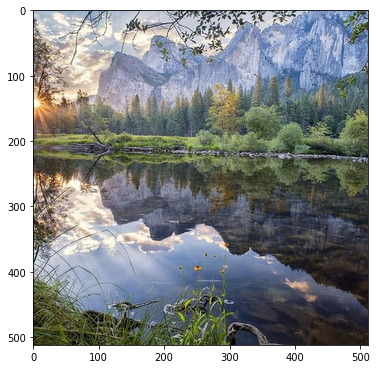

Проход 05201    Ошибка 0.000264
Проход 05202    Ошибка 0.000261
Проход 05203    Ошибка 0.000260
Проход 05204    Ошибка 0.000265
Проход 05205    Ошибка 0.000273
Проход 05206    Ошибка 0.000273
Проход 05207    Ошибка 0.000272
Проход 05208    Ошибка 0.000261
Проход 05209    Ошибка 0.000256
Проход 05210    Ошибка 0.000261
Проход 05211    Ошибка 0.000267
Проход 05212    Ошибка 0.000279
Проход 05213    Ошибка 0.000272
Проход 05214    Ошибка 0.000267
Проход 05215    Ошибка 0.000268
Проход 05216    Ошибка 0.000274
Проход 05217    Ошибка 0.000284
Проход 05218    Ошибка 0.000286
Проход 05219    Ошибка 0.000283
Проход 05220    Ошибка 0.000287
Проход 05221    Ошибка 0.000292
Проход 05222    Ошибка 0.000312
Проход 05223    Ошибка 0.000336
Проход 05224    Ошибка 0.000370
Проход 05225    Ошибка 0.000407
Проход 05226    Ошибка 0.000427
Проход 05227    Ошибка 0.000388
Проход 05228    Ошибка 0.000350
Проход 05229    Ошибка 0.000350
Проход 05230    Ошибка 0.000335
Проход 05231    Ошибка 0.000316
Проход 0

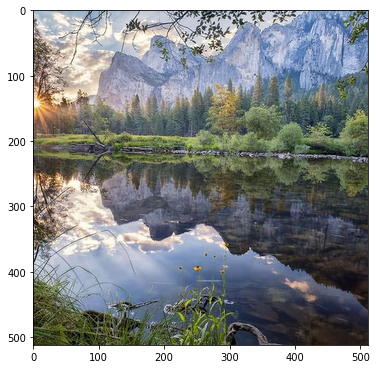

Проход 05251    Ошибка 0.000268
Проход 05252    Ошибка 0.000270
Проход 05253    Ошибка 0.000271
Проход 05254    Ошибка 0.000262
Проход 05255    Ошибка 0.000263
Проход 05256    Ошибка 0.000267
Проход 05257    Ошибка 0.000271
Проход 05258    Ошибка 0.000279
Проход 05259    Ошибка 0.000278
Проход 05260    Ошибка 0.000277
Проход 05261    Ошибка 0.000269
Проход 05262    Ошибка 0.000270
Проход 05263    Ошибка 0.000261
Проход 05264    Ошибка 0.000253
Проход 05265    Ошибка 0.000257
Проход 05266    Ошибка 0.000257
Проход 05267    Ошибка 0.000263
Проход 05268    Ошибка 0.000261
Проход 05269    Ошибка 0.000259
Проход 05270    Ошибка 0.000257
Проход 05271    Ошибка 0.000249
Проход 05272    Ошибка 0.000251
Проход 05273    Ошибка 0.000256
Проход 05274    Ошибка 0.000261
Проход 05275    Ошибка 0.000264
Проход 05276    Ошибка 0.000269
Проход 05277    Ошибка 0.000264
Проход 05278    Ошибка 0.000265
Проход 05279    Ошибка 0.000265
Проход 05280    Ошибка 0.000263
Проход 05281    Ошибка 0.000267
Проход 0

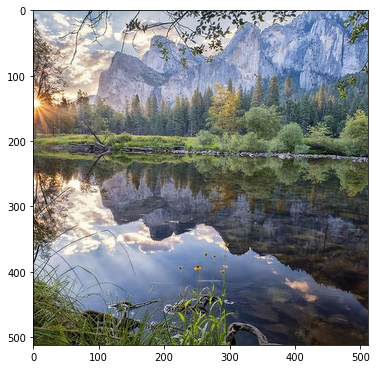

Проход 05301    Ошибка 0.000341
Проход 05302    Ошибка 0.000337
Проход 05303    Ошибка 0.000323
Проход 05304    Ошибка 0.000320
Проход 05305    Ошибка 0.000301
Проход 05306    Ошибка 0.000282
Проход 05307    Ошибка 0.000300
Проход 05308    Ошибка 0.000284
Проход 05309    Ошибка 0.000273
Проход 05310    Ошибка 0.000282
Проход 05311    Ошибка 0.000286
Проход 05312    Ошибка 0.000288
Проход 05313    Ошибка 0.000283
Проход 05314    Ошибка 0.000287
Проход 05315    Ошибка 0.000290
Проход 05316    Ошибка 0.000288
Проход 05317    Ошибка 0.000287
Проход 05318    Ошибка 0.000270
Проход 05319    Ошибка 0.000270
Проход 05320    Ошибка 0.000281
Проход 05321    Ошибка 0.000287
Проход 05322    Ошибка 0.000264
Проход 05323    Ошибка 0.000263
Проход 05324    Ошибка 0.000260
Проход 05325    Ошибка 0.000271
Проход 05326    Ошибка 0.000264
Проход 05327    Ошибка 0.000259
Проход 05328    Ошибка 0.000261
Проход 05329    Ошибка 0.000258
Проход 05330    Ошибка 0.000255
Проход 05331    Ошибка 0.000244
Проход 0

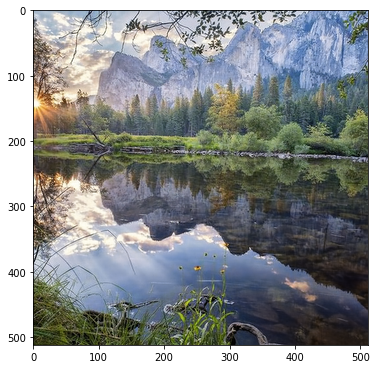

Проход 05351    Ошибка 0.000263
Проход 05352    Ошибка 0.000259
Проход 05353    Ошибка 0.000256
Проход 05354    Ошибка 0.000251
Проход 05355    Ошибка 0.000247
Проход 05356    Ошибка 0.000249
Проход 05357    Ошибка 0.000251
Проход 05358    Ошибка 0.000241
Проход 05359    Ошибка 0.000244
Проход 05360    Ошибка 0.000236
Проход 05361    Ошибка 0.000238
Проход 05362    Ошибка 0.000238
Проход 05363    Ошибка 0.000238
Проход 05364    Ошибка 0.000241
Проход 05365    Ошибка 0.000239
Проход 05366    Ошибка 0.000242
Проход 05367    Ошибка 0.000244
Проход 05368    Ошибка 0.000244
Проход 05369    Ошибка 0.000250
Проход 05370    Ошибка 0.000253
Проход 05371    Ошибка 0.000245
Проход 05372    Ошибка 0.000241
Проход 05373    Ошибка 0.000241
Проход 05374    Ошибка 0.000243
Проход 05375    Ошибка 0.000249
Проход 05376    Ошибка 0.000259
Проход 05377    Ошибка 0.000277
Проход 05378    Ошибка 0.000305
Проход 05379    Ошибка 0.000331
Проход 05380    Ошибка 0.000319
Проход 05381    Ошибка 0.000291
Проход 0

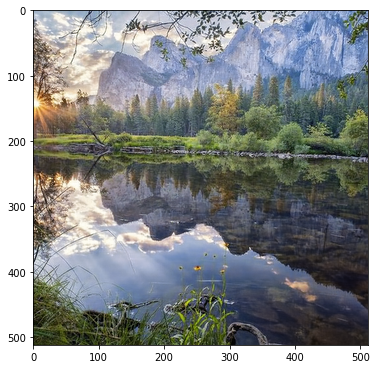

Проход 05401    Ошибка 0.001302
Проход 05402    Ошибка 0.001955
Проход 05403    Ошибка 0.002173
Проход 05404    Ошибка 0.003129
Проход 05405    Ошибка 0.005447
Проход 05406    Ошибка 0.019470
Проход 05407    Ошибка 0.084383
Проход 05408    Ошибка 0.066553
Проход 05409    Ошибка 0.057444
Проход 05410    Ошибка 0.053214
Проход 05411    Ошибка 0.052477
Проход 05412    Ошибка 0.051863
Проход 05413    Ошибка 0.052092
Проход 05414    Ошибка 0.051514
Проход 05415    Ошибка 0.050821
Проход 05416    Ошибка 0.050680
Проход 05417    Ошибка 0.048971
Проход 05418    Ошибка 0.047967
Проход 05419    Ошибка 0.047098
Проход 05420    Ошибка 0.044908
Проход 05421    Ошибка 0.042796
Проход 05422    Ошибка 0.036670
Проход 05423    Ошибка 0.032007
Проход 05424    Ошибка 0.027743
Проход 05425    Ошибка 0.025839
Проход 05426    Ошибка 0.025826
Проход 05427    Ошибка 0.025420
Проход 05428    Ошибка 0.022292
Проход 05429    Ошибка 0.022983
Проход 05430    Ошибка 0.023184
Проход 05431    Ошибка 0.021793
Проход 0

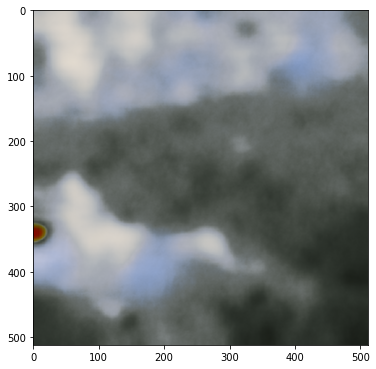

Проход 05451    Ошибка 0.017850
Проход 05452    Ошибка 0.018005
Проход 05453    Ошибка 0.017936
Проход 05454    Ошибка 0.017574
Проход 05455    Ошибка 0.017251
Проход 05456    Ошибка 0.017239
Проход 05457    Ошибка 0.017257
Проход 05458    Ошибка 0.017342
Проход 05459    Ошибка 0.016723
Проход 05460    Ошибка 0.016973
Проход 05461    Ошибка 0.016618
Проход 05462    Ошибка 0.016724
Проход 05463    Ошибка 0.016829
Проход 05464    Ошибка 0.016670
Проход 05465    Ошибка 0.016254
Проход 05466    Ошибка 0.016377
Проход 05467    Ошибка 0.016780
Проход 05468    Ошибка 0.016306
Проход 05469    Ошибка 0.016284
Проход 05470    Ошибка 0.016545
Проход 05471    Ошибка 0.016422
Проход 05472    Ошибка 0.016204
Проход 05473    Ошибка 0.016064
Проход 05474    Ошибка 0.016064
Проход 05475    Ошибка 0.016215
Проход 05476    Ошибка 0.015794
Проход 05477    Ошибка 0.015860
Проход 05478    Ошибка 0.016064
Проход 05479    Ошибка 0.015861
Проход 05480    Ошибка 0.015449
Проход 05481    Ошибка 0.015706
Проход 0

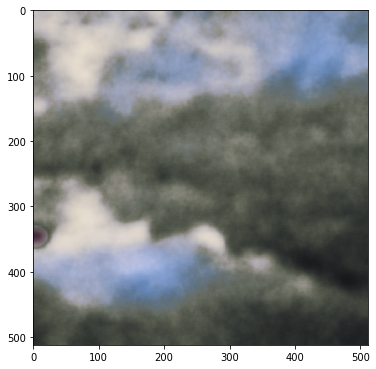

Проход 05501    Ошибка 0.014794
Проход 05502    Ошибка 0.014560
Проход 05503    Ошибка 0.014399
Проход 05504    Ошибка 0.014406
Проход 05505    Ошибка 0.014318
Проход 05506    Ошибка 0.014712
Проход 05507    Ошибка 0.014446
Проход 05508    Ошибка 0.014553
Проход 05509    Ошибка 0.014367
Проход 05510    Ошибка 0.014791
Проход 05511    Ошибка 0.014147
Проход 05512    Ошибка 0.014225
Проход 05513    Ошибка 0.014125
Проход 05514    Ошибка 0.014070
Проход 05515    Ошибка 0.013894
Проход 05516    Ошибка 0.014040
Проход 05517    Ошибка 0.013877
Проход 05518    Ошибка 0.013794
Проход 05519    Ошибка 0.013951
Проход 05520    Ошибка 0.013887
Проход 05521    Ошибка 0.013812
Проход 05522    Ошибка 0.013530
Проход 05523    Ошибка 0.013540
Проход 05524    Ошибка 0.013685
Проход 05525    Ошибка 0.013759
Проход 05526    Ошибка 0.013489
Проход 05527    Ошибка 0.013435
Проход 05528    Ошибка 0.013242
Проход 05529    Ошибка 0.013234
Проход 05530    Ошибка 0.013248
Проход 05531    Ошибка 0.013269
Проход 0

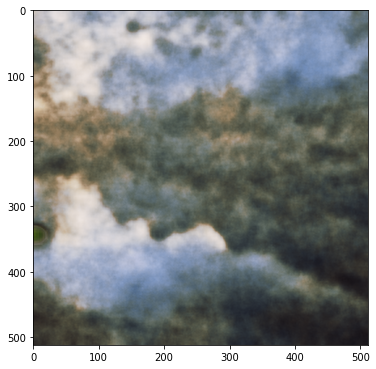

Проход 05551    Ошибка 0.012286
Проход 05552    Ошибка 0.012706
Проход 05553    Ошибка 0.012665
Проход 05554    Ошибка 0.012466
Проход 05555    Ошибка 0.012720
Проход 05556    Ошибка 0.012443
Проход 05557    Ошибка 0.012284
Проход 05558    Ошибка 0.012496
Проход 05559    Ошибка 0.012116
Проход 05560    Ошибка 0.012215
Проход 05561    Ошибка 0.012857
Проход 05562    Ошибка 0.012046
Проход 05563    Ошибка 0.012260
Проход 05564    Ошибка 0.012222
Проход 05565    Ошибка 0.011813
Проход 05566    Ошибка 0.011842
Проход 05567    Ошибка 0.012279
Проход 05568    Ошибка 0.011724
Проход 05569    Ошибка 0.011570
Проход 05570    Ошибка 0.011596
Проход 05571    Ошибка 0.011874
Проход 05572    Ошибка 0.011710
Проход 05573    Ошибка 0.011544
Проход 05574    Ошибка 0.011631
Проход 05575    Ошибка 0.011623
Проход 05576    Ошибка 0.011625
Проход 05577    Ошибка 0.011436
Проход 05578    Ошибка 0.011664
Проход 05579    Ошибка 0.011513
Проход 05580    Ошибка 0.011233
Проход 05581    Ошибка 0.011525
Проход 0

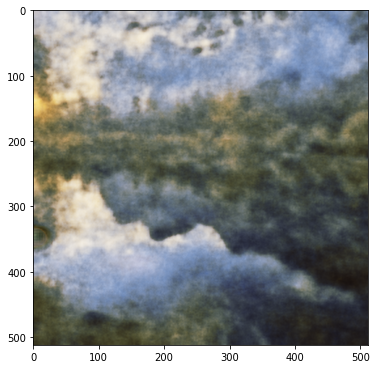

Проход 05601    Ошибка 0.010573
Проход 05602    Ошибка 0.010612
Проход 05603    Ошибка 0.010706
Проход 05604    Ошибка 0.010669
Проход 05605    Ошибка 0.010505
Проход 05606    Ошибка 0.010710
Проход 05607    Ошибка 0.010606
Проход 05608    Ошибка 0.010584
Проход 05609    Ошибка 0.010564
Проход 05610    Ошибка 0.010513
Проход 05611    Ошибка 0.010518
Проход 05612    Ошибка 0.010508
Проход 05613    Ошибка 0.010370
Проход 05614    Ошибка 0.010426
Проход 05615    Ошибка 0.010401
Проход 05616    Ошибка 0.010385
Проход 05617    Ошибка 0.010384
Проход 05618    Ошибка 0.010552
Проход 05619    Ошибка 0.010421
Проход 05620    Ошибка 0.010156
Проход 05621    Ошибка 0.010258
Проход 05622    Ошибка 0.010241
Проход 05623    Ошибка 0.010180
Проход 05624    Ошибка 0.010199
Проход 05625    Ошибка 0.010273
Проход 05626    Ошибка 0.010259
Проход 05627    Ошибка 0.010068
Проход 05628    Ошибка 0.010316
Проход 05629    Ошибка 0.010151
Проход 05630    Ошибка 0.010107
Проход 05631    Ошибка 0.010099
Проход 0

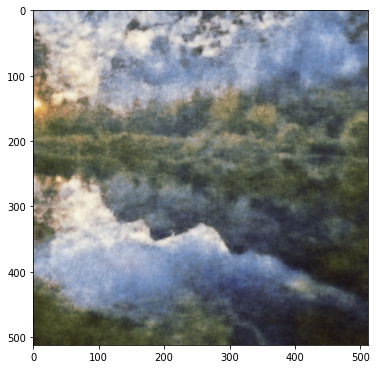

Проход 05651    Ошибка 0.009672
Проход 05652    Ошибка 0.009592
Проход 05653    Ошибка 0.009626
Проход 05654    Ошибка 0.009583
Проход 05655    Ошибка 0.009490
Проход 05656    Ошибка 0.009524
Проход 05657    Ошибка 0.009488
Проход 05658    Ошибка 0.009389
Проход 05659    Ошибка 0.009551
Проход 05660    Ошибка 0.009619
Проход 05661    Ошибка 0.009600
Проход 05662    Ошибка 0.009430
Проход 05663    Ошибка 0.009354
Проход 05664    Ошибка 0.009517
Проход 05665    Ошибка 0.009342
Проход 05666    Ошибка 0.009292
Проход 05667    Ошибка 0.009333
Проход 05668    Ошибка 0.009387
Проход 05669    Ошибка 0.009328
Проход 05670    Ошибка 0.009328
Проход 05671    Ошибка 0.009212
Проход 05672    Ошибка 0.009174
Проход 05673    Ошибка 0.009238
Проход 05674    Ошибка 0.009202
Проход 05675    Ошибка 0.009089
Проход 05676    Ошибка 0.009192
Проход 05677    Ошибка 0.009134
Проход 05678    Ошибка 0.009193
Проход 05679    Ошибка 0.009089
Проход 05680    Ошибка 0.009082
Проход 05681    Ошибка 0.009040
Проход 0

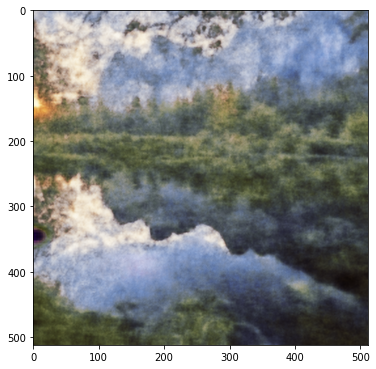

Проход 05701    Ошибка 0.008845
Проход 05702    Ошибка 0.008926
Проход 05703    Ошибка 0.008838
Проход 05704    Ошибка 0.008863
Проход 05705    Ошибка 0.008710
Проход 05706    Ошибка 0.008730
Проход 05707    Ошибка 0.008772
Проход 05708    Ошибка 0.008752
Проход 05709    Ошибка 0.008761
Проход 05710    Ошибка 0.008684
Проход 05711    Ошибка 0.008693
Проход 05712    Ошибка 0.008595
Проход 05713    Ошибка 0.008635
Проход 05714    Ошибка 0.008533
Проход 05715    Ошибка 0.008609
Проход 05716    Ошибка 0.008510
Проход 05717    Ошибка 0.008612
Проход 05718    Ошибка 0.008500
Проход 05719    Ошибка 0.008470
Проход 05720    Ошибка 0.008502
Проход 05721    Ошибка 0.008493
Проход 05722    Ошибка 0.008551
Проход 05723    Ошибка 0.008519
Проход 05724    Ошибка 0.008445
Проход 05725    Ошибка 0.008388
Проход 05726    Ошибка 0.008362
Проход 05727    Ошибка 0.008420
Проход 05728    Ошибка 0.008372
Проход 05729    Ошибка 0.008345
Проход 05730    Ошибка 0.008455
Проход 05731    Ошибка 0.008335
Проход 0

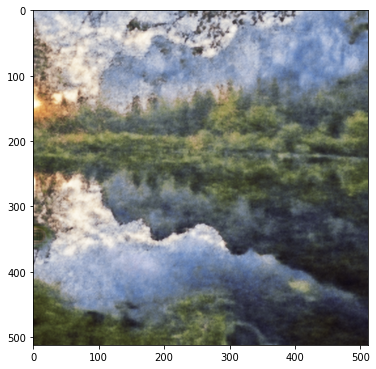

Проход 05751    Ошибка 0.008021
Проход 05752    Ошибка 0.008156
Проход 05753    Ошибка 0.007996
Проход 05754    Ошибка 0.008099
Проход 05755    Ошибка 0.008019
Проход 05756    Ошибка 0.008140
Проход 05757    Ошибка 0.008037
Проход 05758    Ошибка 0.007987
Проход 05759    Ошибка 0.008031
Проход 05760    Ошибка 0.007923
Проход 05761    Ошибка 0.008052
Проход 05762    Ошибка 0.007984
Проход 05763    Ошибка 0.008050
Проход 05764    Ошибка 0.007864
Проход 05765    Ошибка 0.007991
Проход 05766    Ошибка 0.007845
Проход 05767    Ошибка 0.008003
Проход 05768    Ошибка 0.007871
Проход 05769    Ошибка 0.008018
Проход 05770    Ошибка 0.007917
Проход 05771    Ошибка 0.008055
Проход 05772    Ошибка 0.007840
Проход 05773    Ошибка 0.008027
Проход 05774    Ошибка 0.007870
Проход 05775    Ошибка 0.007955
Проход 05776    Ошибка 0.007828
Проход 05777    Ошибка 0.007810
Проход 05778    Ошибка 0.007863
Проход 05779    Ошибка 0.007792
Проход 05780    Ошибка 0.007732
Проход 05781    Ошибка 0.007692
Проход 0

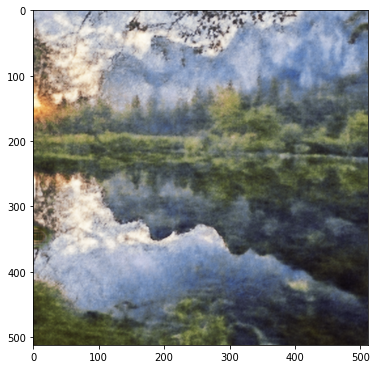

Проход 05801    Ошибка 0.007499
Проход 05802    Ошибка 0.007547
Проход 05803    Ошибка 0.007506
Проход 05804    Ошибка 0.007476
Проход 05805    Ошибка 0.007564
Проход 05806    Ошибка 0.007362
Проход 05807    Ошибка 0.007439
Проход 05808    Ошибка 0.007525
Проход 05809    Ошибка 0.007492
Проход 05810    Ошибка 0.007433
Проход 05811    Ошибка 0.007522
Проход 05812    Ошибка 0.007443
Проход 05813    Ошибка 0.007550
Проход 05814    Ошибка 0.007328
Проход 05815    Ошибка 0.007486
Проход 05816    Ошибка 0.007447
Проход 05817    Ошибка 0.007394
Проход 05818    Ошибка 0.007462
Проход 05819    Ошибка 0.007480
Проход 05820    Ошибка 0.007357
Проход 05821    Ошибка 0.007460
Проход 05822    Ошибка 0.007403
Проход 05823    Ошибка 0.007408
Проход 05824    Ошибка 0.007380
Проход 05825    Ошибка 0.007432
Проход 05826    Ошибка 0.007353
Проход 05827    Ошибка 0.007323
Проход 05828    Ошибка 0.007411
Проход 05829    Ошибка 0.007241
Проход 05830    Ошибка 0.007338
Проход 05831    Ошибка 0.007277
Проход 0

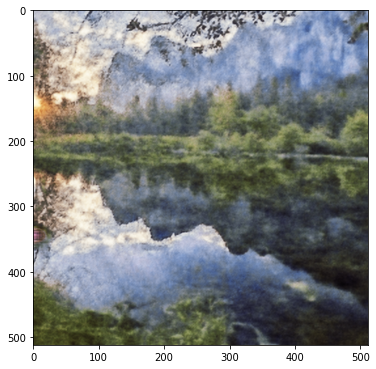

Проход 05851    Ошибка 0.007050
Проход 05852    Ошибка 0.007038
Проход 05853    Ошибка 0.007033
Проход 05854    Ошибка 0.007017
Проход 05855    Ошибка 0.007027
Проход 05856    Ошибка 0.007101
Проход 05857    Ошибка 0.006971
Проход 05858    Ошибка 0.006985
Проход 05859    Ошибка 0.006918
Проход 05860    Ошибка 0.007006
Проход 05861    Ошибка 0.006929
Проход 05862    Ошибка 0.006939
Проход 05863    Ошибка 0.006948
Проход 05864    Ошибка 0.006967
Проход 05865    Ошибка 0.006951
Проход 05866    Ошибка 0.006967
Проход 05867    Ошибка 0.007077
Проход 05868    Ошибка 0.006931
Проход 05869    Ошибка 0.007006
Проход 05870    Ошибка 0.006989
Проход 05871    Ошибка 0.006991
Проход 05872    Ошибка 0.006958
Проход 05873    Ошибка 0.006942
Проход 05874    Ошибка 0.006808
Проход 05875    Ошибка 0.006956
Проход 05876    Ошибка 0.006884
Проход 05877    Ошибка 0.006856
Проход 05878    Ошибка 0.006877
Проход 05879    Ошибка 0.006817
Проход 05880    Ошибка 0.006883
Проход 05881    Ошибка 0.006843
Проход 0

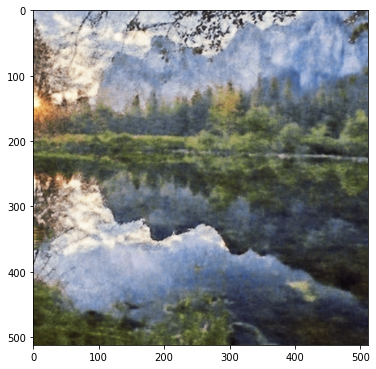

Проход 05901    Ошибка 0.006704
Проход 05902    Ошибка 0.006768
Проход 05903    Ошибка 0.006711
Проход 05904    Ошибка 0.006755
Проход 05905    Ошибка 0.006617
Проход 05906    Ошибка 0.006656
Проход 05907    Ошибка 0.006643
Проход 05908    Ошибка 0.006628
Проход 05909    Ошибка 0.006550
Проход 05910    Ошибка 0.006602
Проход 05911    Ошибка 0.006570
Проход 05912    Ошибка 0.006638
Проход 05913    Ошибка 0.006558
Проход 05914    Ошибка 0.006628
Проход 05915    Ошибка 0.006623
Проход 05916    Ошибка 0.006507
Проход 05917    Ошибка 0.006555
Проход 05918    Ошибка 0.006539
Проход 05919    Ошибка 0.006589
Проход 05920    Ошибка 0.006519
Проход 05921    Ошибка 0.006530
Проход 05922    Ошибка 0.006592
Проход 05923    Ошибка 0.006541
Проход 05924    Ошибка 0.006532
Проход 05925    Ошибка 0.006512
Проход 05926    Ошибка 0.006519
Проход 05927    Ошибка 0.006575
Проход 05928    Ошибка 0.006498
Проход 05929    Ошибка 0.006534
Проход 05930    Ошибка 0.006479
Проход 05931    Ошибка 0.006489
Проход 0

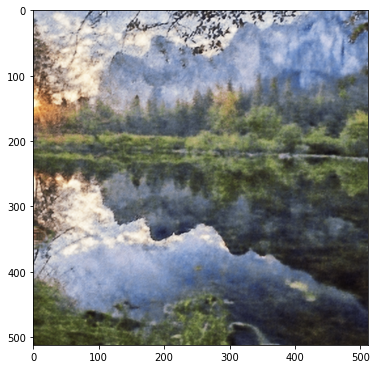

Проход 05951    Ошибка 0.006308
Проход 05952    Ошибка 0.006347
Проход 05953    Ошибка 0.006322
Проход 05954    Ошибка 0.006364
Проход 05955    Ошибка 0.006261
Проход 05956    Ошибка 0.006274
Проход 05957    Ошибка 0.006296
Проход 05958    Ошибка 0.006281
Проход 05959    Ошибка 0.006202
Проход 05960    Ошибка 0.006292
Проход 05961    Ошибка 0.006292
Проход 05962    Ошибка 0.006242
Проход 05963    Ошибка 0.006188
Проход 05964    Ошибка 0.006307
Проход 05965    Ошибка 0.006233
Проход 05966    Ошибка 0.006228
Проход 05967    Ошибка 0.006233
Проход 05968    Ошибка 0.006189
Проход 05969    Ошибка 0.006189
Проход 05970    Ошибка 0.006171
Проход 05971    Ошибка 0.006216
Проход 05972    Ошибка 0.006240
Проход 05973    Ошибка 0.006214
Проход 05974    Ошибка 0.006138
Проход 05975    Ошибка 0.006293
Проход 05976    Ошибка 0.006147
Проход 05977    Ошибка 0.006119
Проход 05978    Ошибка 0.006155
Проход 05979    Ошибка 0.006096
Проход 05980    Ошибка 0.006136
Проход 05981    Ошибка 0.006160
Проход 0

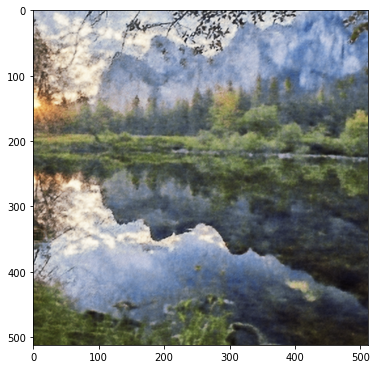

In [ ]:
i = 0
def closure():
    
    global i
    if param_noise:
        for n in [x for x in net.parameters() if len(x.size()) == 4]:
            n = n + n.detach().clone().normal_() * n.std() / 50
    
    net_input = net_input_saved
    if reg_noise_std > 0:
        net_input = net_input_saved + (noise.normal_() * reg_noise_std)
        
        
    out = net(net_input)
   
    total_loss = mse(out * mask_var, img_var * mask_var)
    total_loss.backward()

    print('Проход %05d    Ошибка %f' % (i, total_loss.item()))
    # print('Проход %05d    Ошибка %f' % (i, total_loss.item()), '\r', end='')  # Без вывода каждого прохода (только результат)
    if  PLOT and i % show_every == 0:
        out_np = torch_to_np(out)
        plot_image_grid([np.clip(out_np, 0, 1)], factor=figsize, nrow=1)
        
    i += 1

    return total_loss

net_input_saved = net_input.detach().clone()  # Делаем копию тензора
noise = net_input.detach().clone()

p = get_params(OPT_OVER, net, net_input)
history = optimize(OPTIMIZER, p, closure, LR, num_iter)

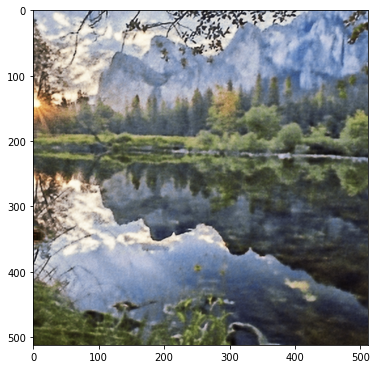

In [ ]:
out_np = torch_to_np(net(net_input))   # Преобразуем обратно из Torch и Numpy
plot_image_grid([out_np], factor=5);   # Рисуем